In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import requests

# One dataset triel run, skip this


## **W42_cycle_2024-10-18_09-31-00**

                                  temp_heated  temp_out  temp_low  temp_high  \
datetime                                                                       
2024-10-18 09:31:01+03:00                10.0       4.4      10.8       12.7   
2024-10-18 09:31:01.237000+03:00          NaN       NaN       NaN        NaN   
2024-10-18 09:31:02+03:00                 8.4       4.4       9.5       11.9   
2024-10-18 09:31:02.912000+03:00          NaN       NaN       NaN        NaN   
2024-10-18 09:31:04+03:00                11.8       7.8       9.1       11.5   
...                                       ...       ...       ...        ...   
2024-10-18 15:14:56.380000+03:00          NaN       NaN       NaN        NaN   
2024-10-18 15:14:57+03:00                72.4      23.7      35.5       30.5   
2024-10-18 15:14:58.065000+03:00          NaN       NaN       NaN        NaN   
2024-10-18 15:14:59+03:00                72.9      23.7      35.5       30.5   
2024-10-18 15:14:59.745000+03:00        

<Axes: xlabel='datetime'>

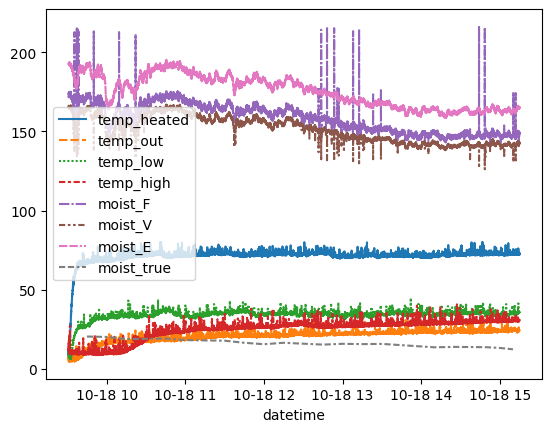

In [ ]:
data_url= "https://owncloud.ut.ee/owncloud/s/NXLAJfD4pdmyNp4/download/W42_cycle_2024-10-18.csv"
response = requests.get(data_url)
with open("data1_10-18.csv", "wb") as f:
    f.write(response.content)

#https://owncloud.ut.ee/owncloud/s/NFaZyrdzftB6Ny2/download/W42_cycle_2024-10-19_15-06-00.csv
data_1 = pd.read_csv("data1_10-18.csv")
data_1['datetime'] = pd.to_datetime(data_1['datetime'], format="mixed")
data_1.set_index('datetime', inplace=True)
print(data_1)
sns.lineplot(data=data_1)

Initial data subset:
- remove all data before and after the first and last non NAN value in column "moist true"
- remove moisture measurement lines
- remove data before first manual measurement of humidity

In [ ]:
data_1 = data_1.drop(columns=["moist_F", "moist_E", "moist_V"], errors='ignore')

In [ ]:
# Find the first and last non-NaN values in the "moist true" column
print("data starts at ",data_1.index[0] , "and ends at",data_1.index[-1], "and is length", data_1.shape[0])

first_valid_index = data_1['moist_true'].first_valid_index()
last_valid_index = data_1['moist_true'].last_valid_index()

# Remove rows before the first valid index and after the last valid index
data_1 = data_1.loc[first_valid_index:last_valid_index]
print("data starts at ",data_1.index[0] , "and ends at",data_1.index[-1], "and is length", data_1.shape[0])


data starts at  2024-10-18 09:31:01+03:00 and ends at 2024-10-18 15:14:59.745000+03:00 and is length 24281
data starts at  2024-10-18 09:45:00+03:00 and ends at 2024-10-18 15:10:00+03:00 and is length 22938


In [ ]:
# prompt: smooth with rolling average the columns temp_heated, temp_out, temp_low, temp_high. for the edges use the nearest smoothed value
#interpolate true humidity values
#print(data_1.head())
data_1["moist_true"] = data_1["moist_true"].interpolate(method='time')
print("data starts at ",data_1.index[0] , "and ends at",data_1.index[-1], "and is length", data_1.shape[0])
#print(data_1.head())

data_1 = data_1.dropna(subset=['temp_heated'])
print(data_1.head())
print("data starts at ",data_1.index[0] , "and ends at",data_1.index[-1], "and is length", data_1.shape[0])


data starts at  2024-10-18 09:45:00+03:00 and ends at 2024-10-18 15:10:00+03:00 and is length 22938
                           temp_heated  temp_out  temp_low  temp_high  \
datetime                                                                
2024-10-18 09:45:01+03:00         67.3      11.2      27.4       10.5   
2024-10-18 09:45:03+03:00         67.4      11.2      27.4       10.3   
2024-10-18 09:45:04+03:00         66.9      11.4      27.1       10.0   
2024-10-18 09:45:06+03:00         67.8      11.2      27.5        9.3   
2024-10-18 09:45:08+03:00         67.2      11.6      27.1        9.5   

                           moist_true  
datetime                               
2024-10-18 09:45:01+03:00   20.349722  
2024-10-18 09:45:03+03:00   20.349167  
2024-10-18 09:45:04+03:00   20.348889  
2024-10-18 09:45:06+03:00   20.348333  
2024-10-18 09:45:08+03:00   20.347778  
data starts at  2024-10-18 09:45:01+03:00 and ends at 2024-10-18 15:10:00+03:00 and is length 11496


## Feature engineering
we design some new features.
we consider:
- our period of study starts at the first humidity measurement, we assume this is pretty much at the start of the machine.
- we measure time spent and heat gone in starting from than moment

The cumulative value provides a summary of how much energy has been transferred to the grain during the drying process. In order words, how much heat absorbed by the grain.

In [ ]:
# Assuming data_1 is your DataFrame as defined in the previous code

def rolling_avg_with_edge_handling(data, window_size):
    """Applies rolling average with edge handling."""

    smoothed_data = data.rolling(window=window_size, center=True).mean()

    # Handle edges by using the nearest valid smoothed value.
    for col in smoothed_data.columns:
      smoothed_data[col] = smoothed_data[col].fillna(method='bfill').fillna(method='ffill')
    return smoothed_data


# Apply rolling average to specified columns
window_size = 21  # Example window size; adjust as needed
columns_to_smooth = ['temp_heated', 'temp_out', 'temp_low', 'temp_high']

data_1[columns_to_smooth] = rolling_avg_with_edge_handling(data_1[columns_to_smooth], window_size)

print(data_1.head())

                           temp_heated   temp_out   temp_low  temp_high  \
datetime                                                                  
2024-10-18 09:45:01+03:00    67.295238  11.533333  27.419048        9.8   
2024-10-18 09:45:03+03:00    67.295238  11.533333  27.419048        9.8   
2024-10-18 09:45:04+03:00    67.295238  11.533333  27.419048        9.8   
2024-10-18 09:45:06+03:00    67.295238  11.533333  27.419048        9.8   
2024-10-18 09:45:08+03:00    67.295238  11.533333  27.419048        9.8   

                           moist_true  
datetime                               
2024-10-18 09:45:01+03:00   20.349722  
2024-10-18 09:45:03+03:00   20.349167  
2024-10-18 09:45:04+03:00   20.348889  
2024-10-18 09:45:06+03:00   20.348333  
2024-10-18 09:45:08+03:00   20.347778  


<ipython-input-84-54fe973f23f5>:12: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  smoothed_data[col] = smoothed_data[col].fillna(method='bfill').fillna(method='ffill')


<ipython-input-97-fccb86b474a6>:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  data_1['start_moisture'] = data_1['moist_true'][0]


datetime
2024-10-18 09:45:01+03:00    55.761905
2024-10-18 09:45:03+03:00    55.761905
2024-10-18 09:45:04+03:00    55.761905
2024-10-18 09:45:06+03:00    55.761905
2024-10-18 09:45:08+03:00    55.761905
Name: air_temp_lost, dtype: float64
datetime
2024-10-18 09:45:01+03:00      0.000000
2024-10-18 09:45:03+03:00    111.523810
2024-10-18 09:45:04+03:00    167.285714
2024-10-18 09:45:06+03:00    278.809524
2024-10-18 09:45:08+03:00    390.333333
Name: heat_transfer, dtype: float64


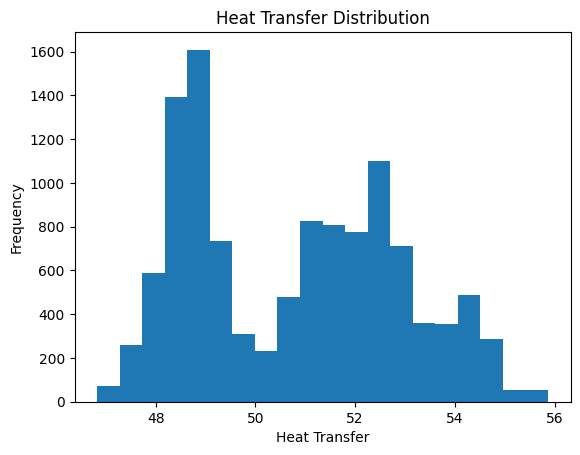

In [ ]:
data_1['start_moisture'] = data_1['moist_true'][0]

#new feature, maybe is useful to see if grain heats up as passing through the hot air area
data_1['grain_temp_gained'] = data_1['temp_low'] - data_1['temp_high']

# The heat transfer rate i.e. how much temperature air lost (temp_heated - temp_out)
data_1['air_temp_lost'] = data_1['temp_heated'] - data_1['temp_out']
print(data_1['air_temp_lost'].head())

# i do not want this in the dataset, but we need the timestep duration info
timestep_durations = data_1.index.to_series().diff().dt.total_seconds().fillna(0)

# Calculate the cumulative integral of heat transfer
data_1['heat_transfer'] = (data_1['air_temp_lost']*timestep_durations).cumsum()

# Converting the datetime column to time deltas in seconds
data_1['time_elapsed'] = (data_1.index - data_1.index[0]).total_seconds()
#data1_interpolated['time_elapsed']


We need to remove the initial non-stationary phase - the first grain cycle - from the data that we attempt to learn the relationship for. The relationship in that phase is not governed by the same formula.

data starts at  2024-10-18 10:32:04+03:00 and ends at 2024-10-18 15:10:00+03:00 and is length 9814


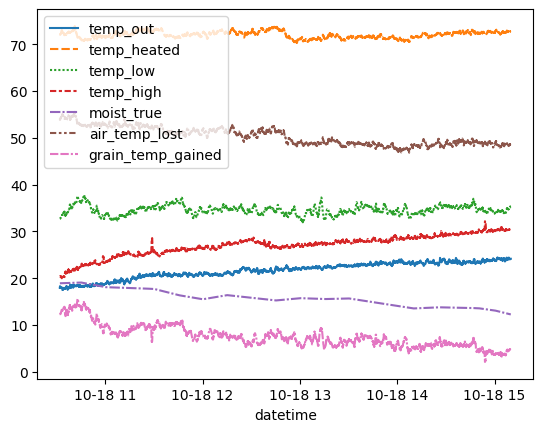

In [ ]:
#cropping away initial section. It right now relies on the temp_heated increasing. There might be a better conditon.
#potentially the temp_high could reflect a full cycle being completed..
#feel free to set it manually
data1_cropped = data_1[data_1["temp_high"] > 20]

sns.lineplot(data=data1_cropped[['temp_out',"temp_heated",'temp_low',"temp_high","moist_true","air_temp_lost","grain_temp_gained"]])

#move moist_true as last column (and not the newly added ones), better plot readability
column_to_move = 'moist_true'
data1_cropped = data1_cropped[[col for col in data1_cropped.columns if col != column_to_move] + [column_to_move]]

print("data starts at ",data1_cropped.index[0] , "and ends at",data1_cropped.index[-1], "and is length", data1_cropped.shape[0])

<Axes: >

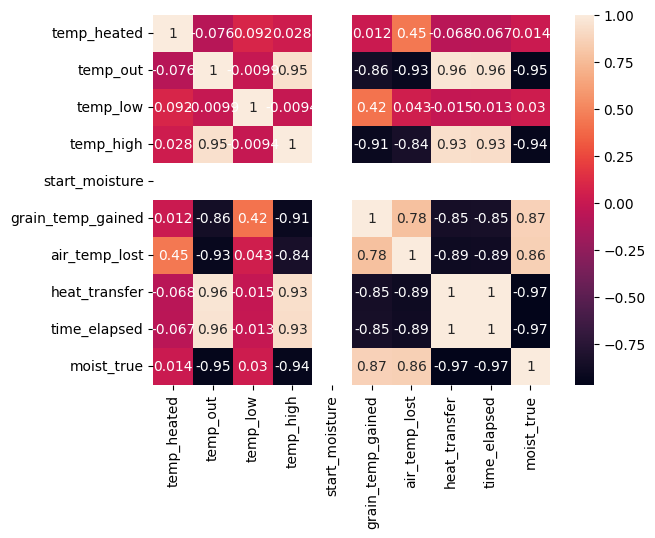

In [ ]:
sns.heatmap(data1_cropped.corr(), annot=True)

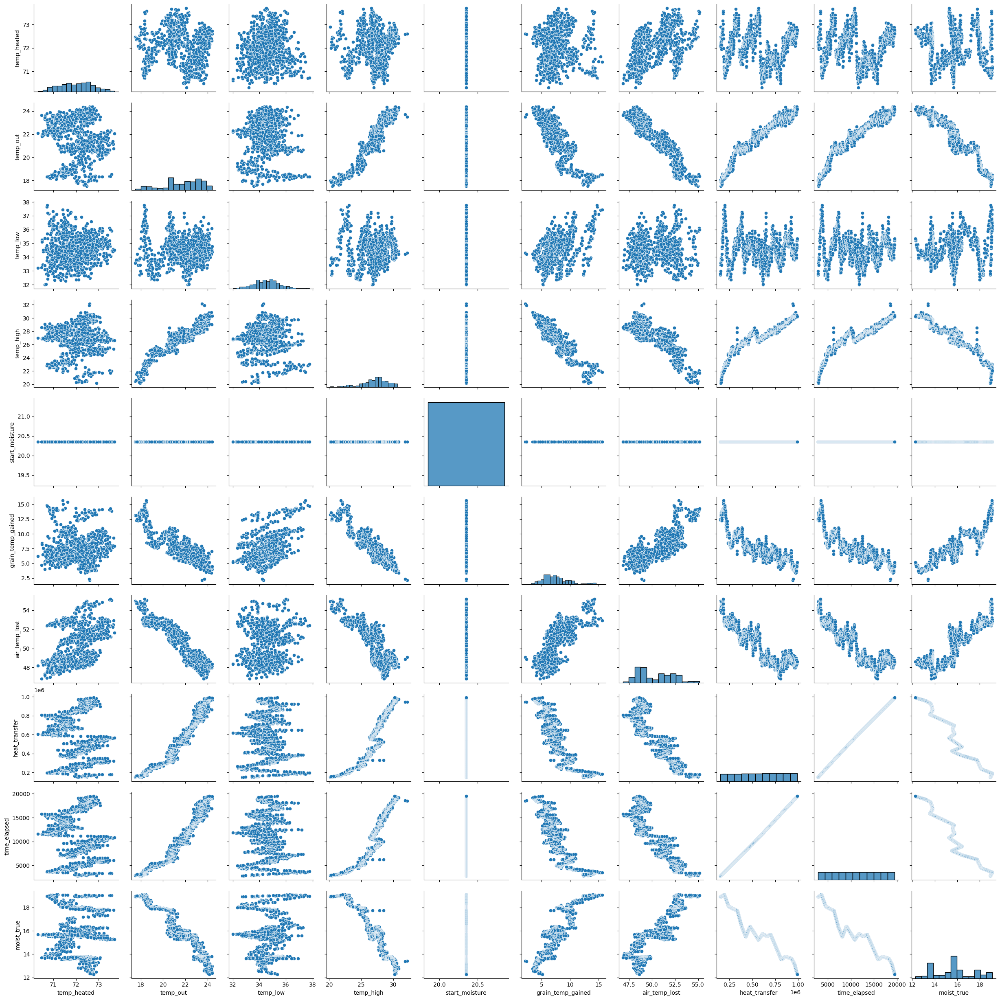

In [ ]:
# the ::10 subsamples data so the plots are drawn faster.
sns.pairplot(data1_cropped[::10], diag_kind='hist')

In [ ]:

# Calculate the correlation between 'heat_transfer' and 'time_elapsed'
correlation = data1_cropped['heat_transfer'].corr(data1_cropped['time_elapsed'])
print(f"Correlation between heat transfer and time elapsed: {correlation}")


Correlation between heat transfer and time elapsed: 0.9998609530198417


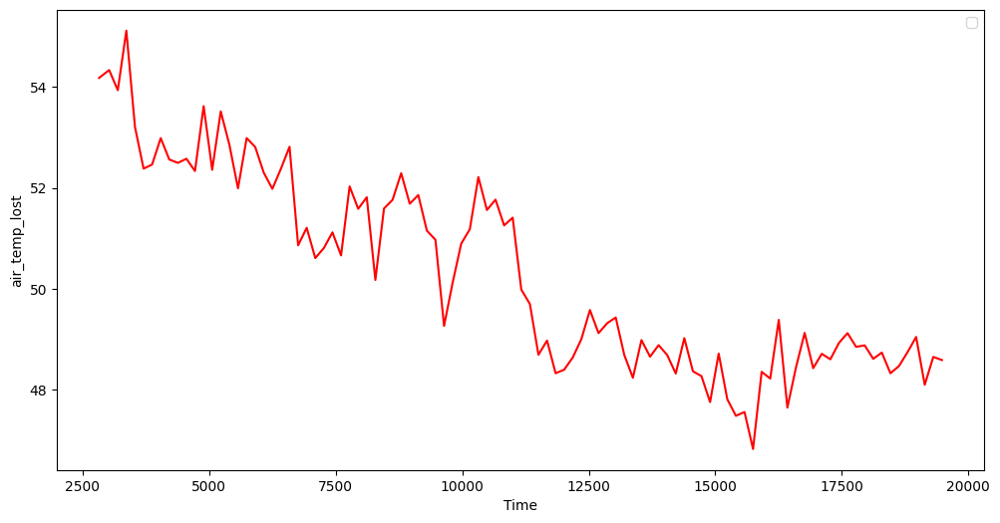

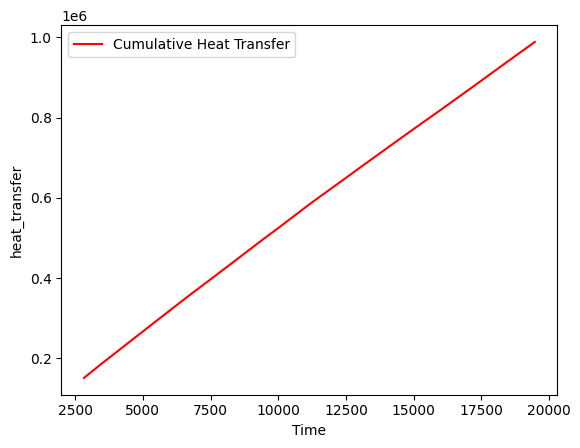

<Axes: title={'center': 'Incremental Heat Transfer'}, xlabel='datetime'>

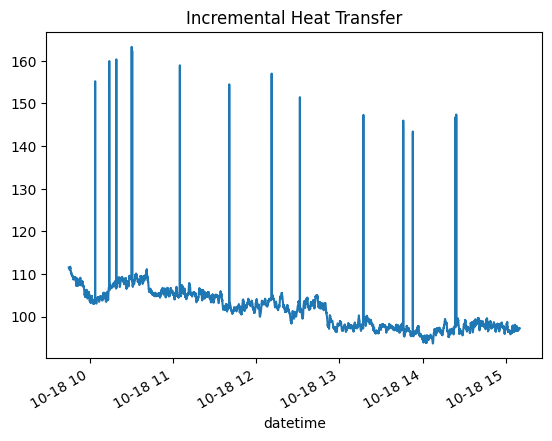

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(data1_cropped['time_elapsed'][::100], data1_cropped['air_temp_lost'][::100], color='red')
plt.xlabel("Time")
plt.ylabel("air_temp_lost")
plt.legend()
plt.show()


#plt.plot(data1_interpolated.index, data1_interpolated['moist_true'], label='Moist True', color='blue')
plt.plot(data1_cropped['time_elapsed'][::100], data1_cropped['heat_transfer'][::100], label='Cumulative Heat Transfer', color='red')
plt.xlabel("Time")
plt.ylabel("heat_transfer")
plt.legend()
plt.show()

#it looks very very linear, so to make sure everything is actually correct

plt.clf()
incremental_changes = data_1['heat_transfer'].diff().fillna(0)
incremental_changes[incremental_changes>80].plot(title='Incremental Heat Transfer')


## Model implementation

## linear model

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Train LINEAR model
from sklearn.linear_model import LinearRegression

# We define features and targets for the two cases: abs and change predictions

#X_abs = data1_cropped.drop(columns=['moist_true', "time_elapsed", "heat_transfer"]) #use almost everything
X_abs = data1_cropped[["air_temp_lost","grain_temp_gained", "temp_out","temp_high","temp_low","start_moisture"]] #most features will be useless but should we keep them?
y_abs = data1_cropped['moist_true']

X_change = data1_cropped[["heat_transfer","start_moisture"]] #most features will be useless but should we keep them?
print(X_change.head())
y_change = data1_cropped['moist_true'] - data1_cropped['moist_true'][0]

# Splitting the data into training and test
absX_train, absX_test, absy_train, absy_test = train_test_split(X_abs, y_abs, test_size=0.2, random_state=42, shuffle=False)

#redefine target as the change since the beginning of the dataset
print( data1_cropped["moist_true"][0])
changeX_train, changeX_test, changey_train, changey_test = train_test_split(X_change, y_change, test_size=0.2, random_state=42, shuffle=False)

abs_lin_model = LinearRegression()
abs_lin_model.fit(absX_train, absy_train)

change_lin_model = LinearRegression()
change_lin_model.fit(changeX_train, changey_train)

                           heat_transfer  start_moisture
datetime                                                
2024-10-18 10:32:04+03:00  150759.780952       20.349722
2024-10-18 10:32:05+03:00  150813.952381       20.349722
2024-10-18 10:32:07+03:00  150921.561905       20.349722
2024-10-18 10:32:09+03:00  151029.190476       20.349722
2024-10-18 10:32:10+03:00  151083.038095       20.349722
18.927555555555553


<ipython-input-117-d513861d29c6>:15: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  y_change = data1_cropped['moist_true'] - data1_cropped['moist_true'][0]
<ipython-input-117-d513861d29c6>:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print( data1_cropped["moist_true"][0])


LinearRegression()

In [ ]:
# Evaluate the model
absy_pred = abs_lin_model.predict(absX_test)
mse = mean_squared_error(absy_test, absy_pred)
print(f"Mean Squared Error (MSE) abs model: {mse}")

changey_pred = change_lin_model.predict(changeX_test)
mse = mean_squared_error(changey_test, changey_pred)
print(f"Mean Squared Error (MSE) change model: {mse}")

Mean Squared Error (MSE) abs model: 0.48954715831680085
Mean Squared Error (MSE) change model: 0.05858600237198567


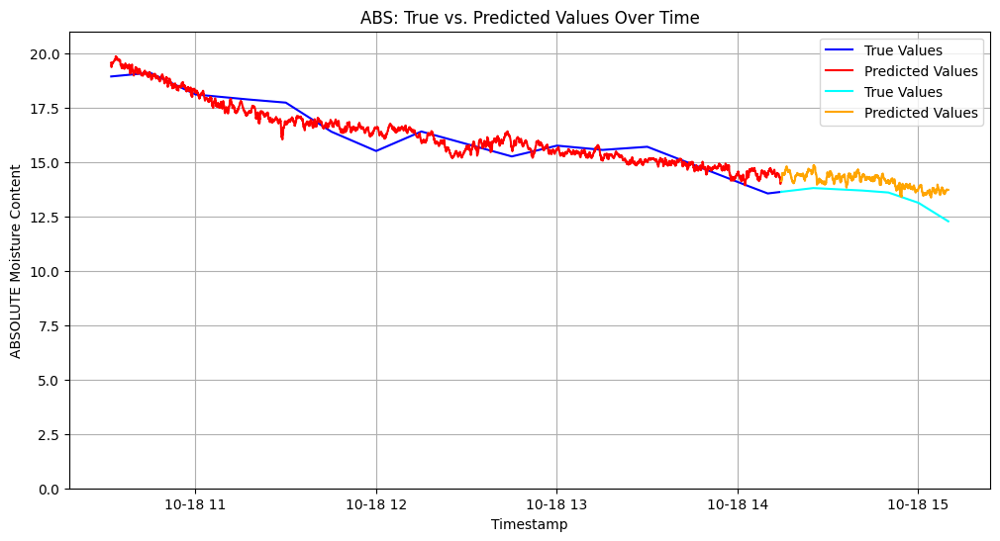

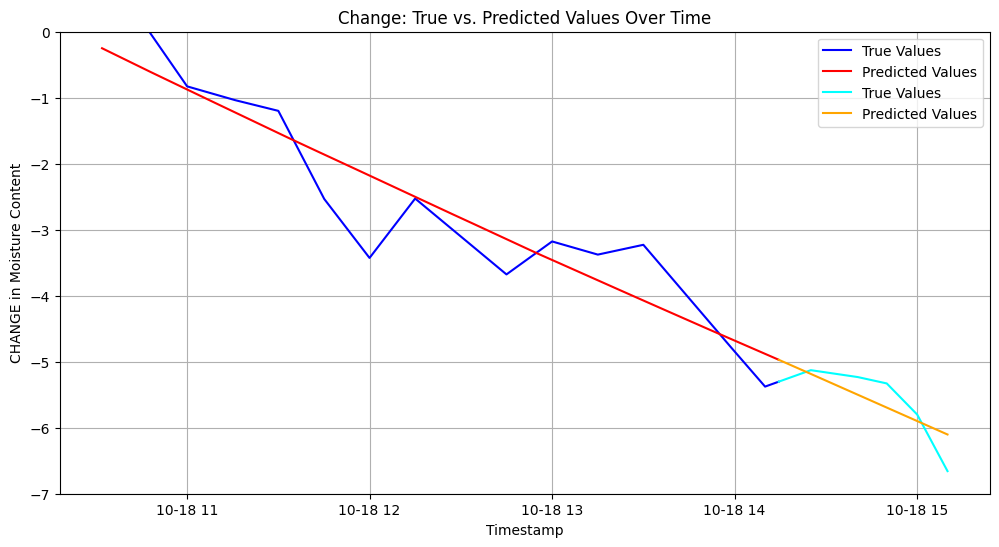

[-6.9739631e-06  0.0000000e+00] 0.8011763084613763


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# train data
plt.figure(figsize=(12, 6))
# Plot true values
plt.plot(absy_train.index, absy_train.values, label='True Values', color='blue')
# Plot predicted values
plt.plot(absy_train.index, abs_lin_model.predict(absX_train), label='Predicted Values', color='red')

# test data
plt.plot(absy_test.index, absy_test.values, label='True Values', color='cyan')
# Plot predicted values
plt.plot(absy_test.index, absy_pred, label='Predicted Values', color='orange')

plt.title("ABS: True vs. Predicted Values Over Time")
plt.xlabel("Timestamp")
plt.ylabel("ABSOLUTE Moisture Content")
plt.legend()
plt.ylim(0,21)
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
#train data
# Plot true values
plt.plot(changey_train.index, changey_train.values, label='True Values', color='blue')
# Plot predicted values
plt.plot(changey_train.index, change_lin_model.predict(changeX_train), label='Predicted Values', color='red')

# Plot true values
plt.plot(changey_test.index, changey_test.values, label='True Values', color='cyan')
# Plot predicted values
plt.plot(changey_test.index, changey_pred, label='Predicted Values', color='orange')

plt.title("Change: True vs. Predicted Values Over Time")
plt.xlabel("Timestamp")
plt.ylabel("CHANGE in Moisture Content")
plt.ylim(-7,0)
plt.legend()
plt.grid(True)
plt.show()

print(change_lin_model.coef_,change_lin_model.intercept_)


COMMENT: the absolute value model learns nothing from the constant input humidity, because it can just do it in intercept. HOWEVER, if we have variety of datasets, it can learn, potenrially, to consider it.

COMMENT2: change prediction only based on transfered heat is MUCH BETTER than with all other features included too, the others are just distracting


# All datasets


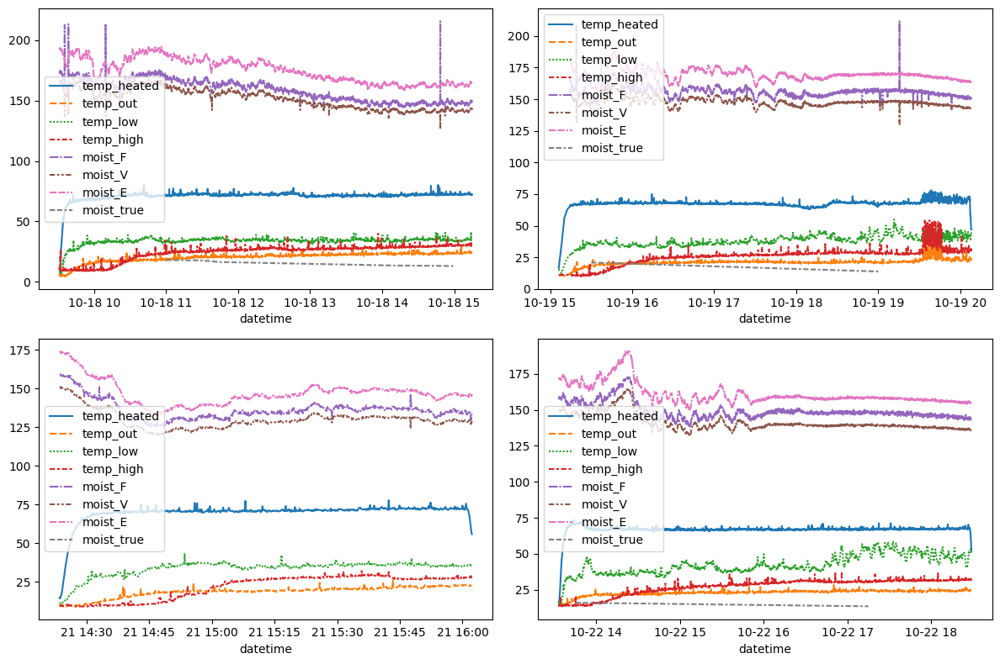

In [ ]:
data_url= "https://owncloud.ut.ee/owncloud/s/NXLAJfD4pdmyNp4/download/W42_cycle_2024-10-18.csv"
response = requests.get(data_url)
with open("data1_10-18.csv", "wb") as f:
    f.write(response.content)

data_url= "https://owncloud.ut.ee/owncloud/s/ScnjQCZCy2wJYAd/download/W42_cycle_2024-10-19.csv"
response = requests.get(data_url)
with open("data2_10-19.csv", "wb") as f:
    f.write(response.content)

data_url= "https://owncloud.ut.ee/owncloud/s/stM9atWkTgr373J/download/W43_cycle_2024-10-21.csv"
response = requests.get(data_url)
with open("data3_10-21.csv", "wb") as f:
    f.write(response.content)

data_url= "https://owncloud.ut.ee/owncloud/s/igQoJrc7xb2QYr5/download/W43_cycle_2024-10-22.csv"
response = requests.get(data_url)
with open("data4_10-22.csv", "wb") as f:
    f.write(response.content)

data_1 = pd.read_csv("data1_10-18.csv")
data_2 = pd.read_csv("data2_10-19.csv")
data_3 = pd.read_csv("data3_10-21.csv")
data_4 = pd.read_csv("data4_10-22.csv")

fig, axes = plt.subplots(2, 2, figsize=(12, 8))
for ax, data in zip(axes.flatten(), [data_1, data_2, data_3, data_4]):
  data['datetime'] = pd.to_datetime(data['datetime'], format="mixed")
  data.set_index('datetime', inplace=True)
  sns.lineplot(data=data, ax=ax)

plt.tight_layout()
plt.show()


Cleaning the data from unwanted areas at the end

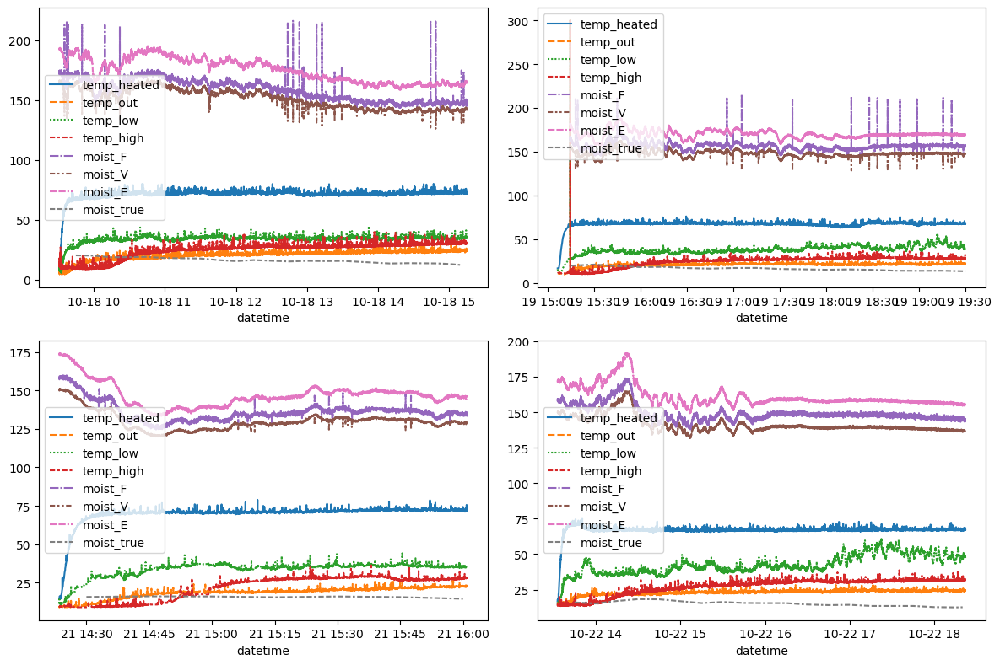

In [ ]:
#data 2 has a very odd noisy period that needs to be removed
cutoff_time = '2024-10-19 19:30:00'  # Example timestamp
cutoff_time = pd.Timestamp(cutoff_time,tz='UTC+03:00')  # Ensure it's a pandas Timestamp
# Filter the DataFrame to keep only rows before or at the cutoff time
data_2 = data_2[data_2.index <= cutoff_time]

#data 3 and 4 have tails where we no longer heat

cutoff_time = '2024-10-21 16:01:00'  # Example timestamp
cutoff_time = pd.Timestamp(cutoff_time,tz='UTC+03:00')  # Ensure it's a pandas Timestamp
# Filter the DataFrame to keep only rows before or at the cutoff time
data_3 = data_3[data_3.index <= cutoff_time]

cutoff_time = '2024-10-22 18:22:00'  # Example timestamp
cutoff_time = pd.Timestamp(cutoff_time,tz='UTC+03:00')  # Ensure it's a pandas Timestamp
# Filter the DataFrame to keep only rows before or at the cutoff time
data_4 = data_4[data_4.index <= cutoff_time]


fig, axes = plt.subplots(2, 2, figsize=(12, 8))
for ax, data in zip(axes.flatten(), [data_1, data_2, data_3, data_4]):
    sns.lineplot(data=data, ax=ax)
plt.tight_layout()
plt.show()

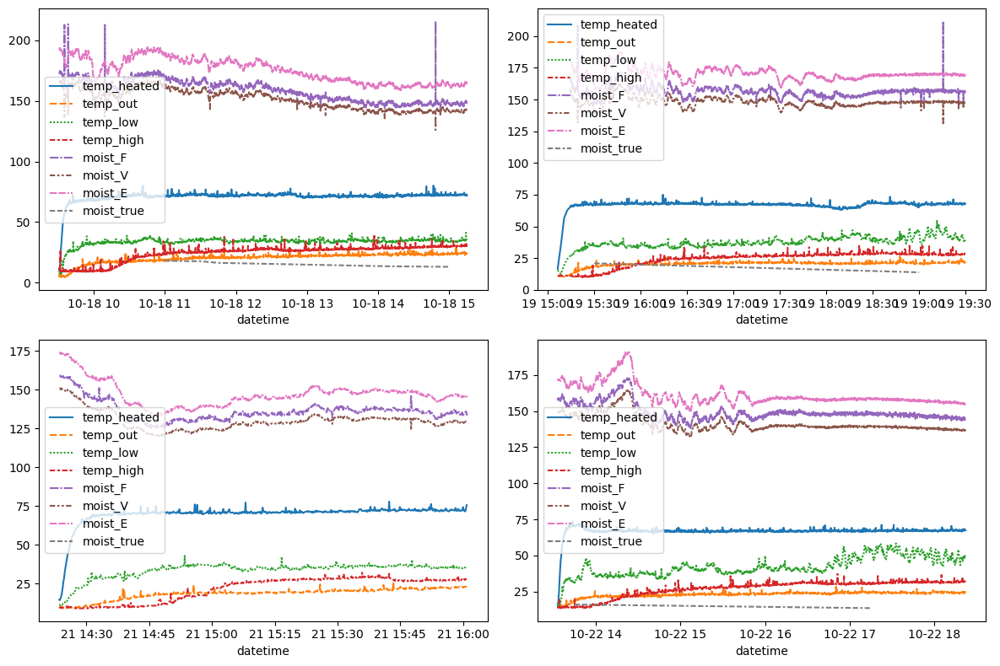

In [ ]:
def filter_outliers(series, window=51, threshold=1):
    rolling_mean = series.rolling(window=window, center=True).mean()
    rolling_std = series.rolling(window=window, center=True).std()
    anomalies = (series - rolling_mean).abs() > threshold * rolling_std
    return series.where(~anomalies, rolling_mean)

columns_to_filter = ['temp_heated', 'temp_out', 'temp_low', 'temp_high']

data_1[columns_to_filter] = data_1[columns_to_filter].apply(filter_outliers, window=51, threshold=1)
data_2[columns_to_filter] = data_2[columns_to_filter].apply(filter_outliers, window=51, threshold=1)
data_3[columns_to_filter] = data_3[columns_to_filter].apply(filter_outliers, window=51, threshold=1)
data_4[columns_to_filter] = data_4[columns_to_filter].apply(filter_outliers, window=51, threshold=1)

fig, axes = plt.subplots(2, 2, figsize=(12, 8))
for ax, data in zip(axes.flatten(), [data_1, data_2, data_3, data_4]):
  sns.lineplot(data=data[::5],ax=ax)

plt.tight_layout()
plt.show()

# all of the preprocessing steps:
- remove unwanted column
- remove data before and after last moisture measurement
- interpolate moisture values
- drop empty lines where moisture sesor values were
- smooth

do all feature-engineerng:
- define start moisture
- define grain temp gained, air temp lost, heat transfer, time elapsed

Last preprocessing (has to be done after feature engineering)
- cut away non-stationary heating-up phase

<ipython-input-29-9b5879541793>:8: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  smoothed_data[col] = smoothed_data[col].fillna(method='bfill').fillna(method='ffill')
<ipython-input-29-9b5879541793>:28: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  data['start_moisture'] = data['moist_true'][0]
<ipython-input-29-9b5879541793>:8: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  smoothed_data[col] = smoothed_data[col].fillna(method='bfill').fillna(method='ffill')
<ipython-input-29-9b5879541793>:28: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as

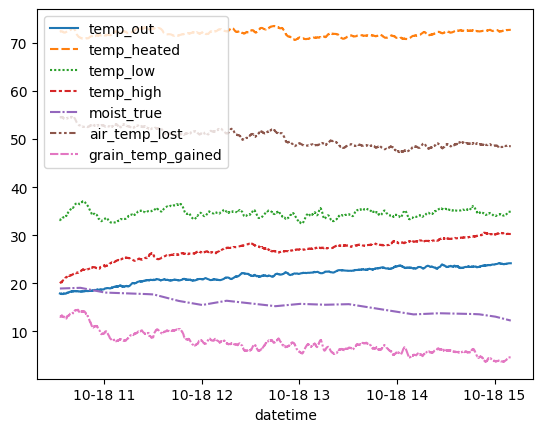

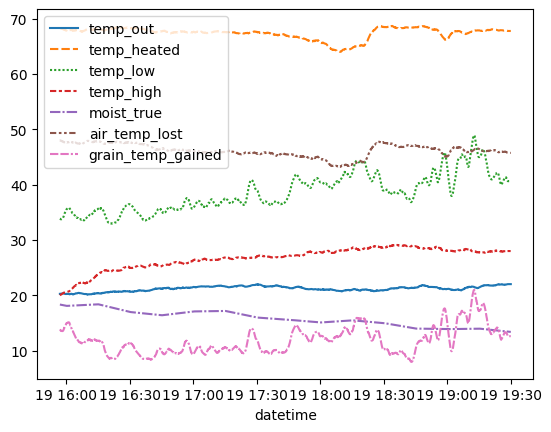

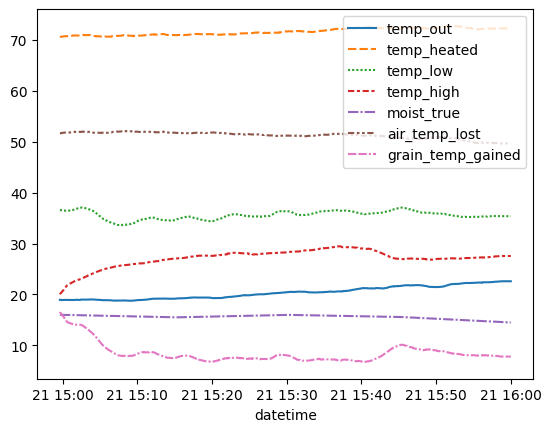

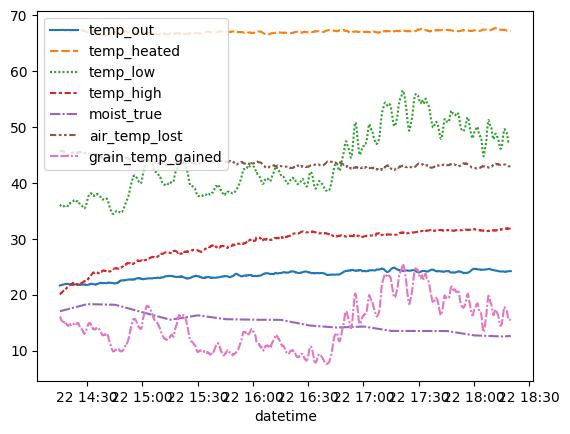

In [ ]:
def rolling_avg_with_edge_handling(data, window_size):
    """Applies rolling average with edge handling."""

    smoothed_data = data.rolling(window=window_size, center=True).mean()

    # Handle edges by using the nearest valid smoothed value.
    for col in smoothed_data.columns:
      smoothed_data[col] = smoothed_data[col].fillna(method='bfill').fillna(method='ffill')
    return smoothed_data

for i,data in enumerate([data_1, data_2, data_3, data_4]):
  data = data.drop(columns=["moist_F", "moist_E", "moist_V"], errors='ignore')
  first_valid_index = data['moist_true'].first_valid_index()
  last_valid_index = data['moist_true'].last_valid_index()
  # Remove rows before the first valid index and after the last valid index
  data = data.loc[first_valid_index:last_valid_index]
  #interpolate the moisture values (labels)
  data["moist_true"] = data["moist_true"].interpolate(method='time')
  #remove lines where moisture measurements were supposed to be
  data = data.dropna(subset=['temp_heated'])

  #feature engineering starts
  #smoothing values
  window_size = 101  # Example window size; adjust as needed
  columns_to_smooth = ['temp_heated', 'temp_out', 'temp_low', 'temp_high']
  data[columns_to_smooth] = rolling_avg_with_edge_handling(data[columns_to_smooth], window_size)

  data['start_moisture'] = data['moist_true'][0]

  #new feature, maybe is useful to see if grain heats up as passing through the hot air area
  data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
  # The heat transfer rate i.e. how much temperature air lost (temp_heated - temp_out)
  data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
  # i do not want this in the dataset, but we need the timestep duration info
  timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
  # Calculate the cumulative integral of heat transfer
  data['heat_transfer'] = (data['air_temp_lost']*timestep_durations).cumsum()
  # Converting the datetime column to time deltas in seconds
  data['time_elapsed'] = (data.index - data.index[0]).total_seconds()/3600

  column_to_move = 'moist_true'
  data = data[[col for col in data.columns if col != column_to_move] + [column_to_move]]
  # Reassign the modified DataFrames, cut off initial period
  if i == 0:
    data1_cropped = data[data["temp_high"] > 20]
  elif i == 1:
    data2_cropped = data[data["temp_high"] > 20]
  elif i == 2:
    data3_cropped =  data[data["temp_high"] > 20]
  elif i == 3:
    data4_cropped =  data[data["temp_high"] > 20]


for data in [data1_cropped, data2_cropped, data3_cropped, data4_cropped]:
  sns.lineplot(data=data[['temp_out',"temp_heated",'temp_low',"temp_high","moist_true","air_temp_lost","grain_temp_gained"]])
  plt.show()
#move moist_true as last column (and not the newly added ones), better plot readability


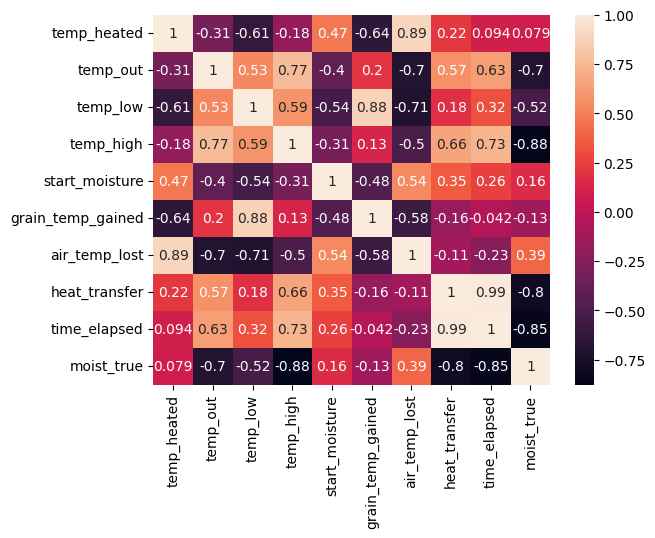

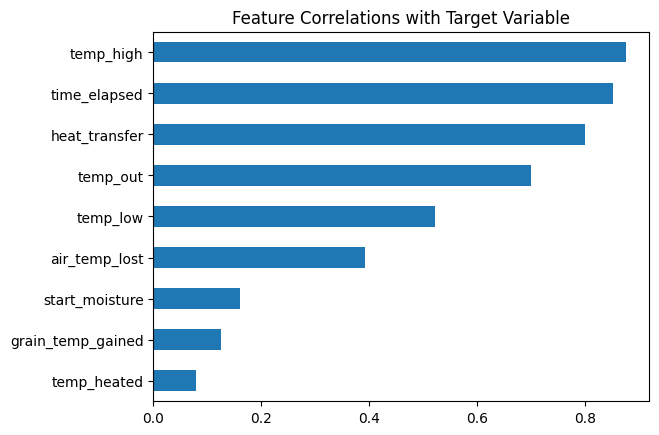

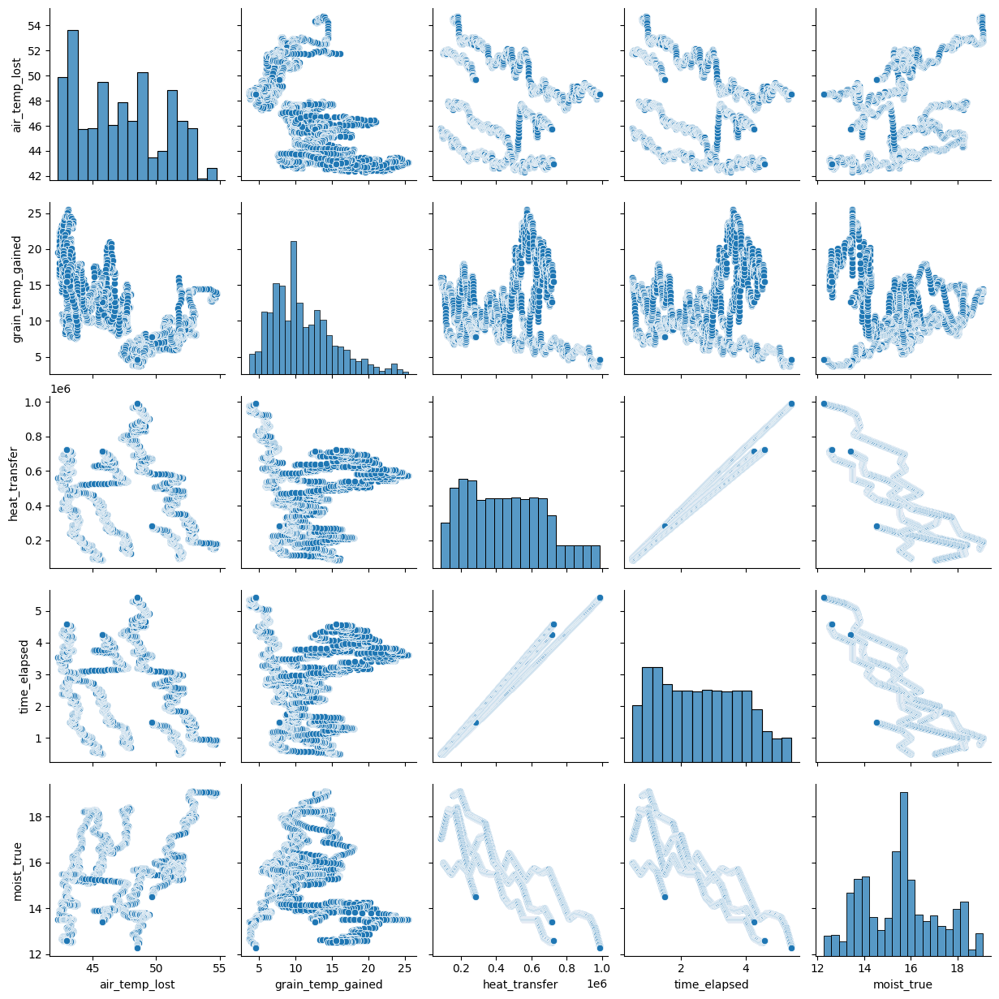

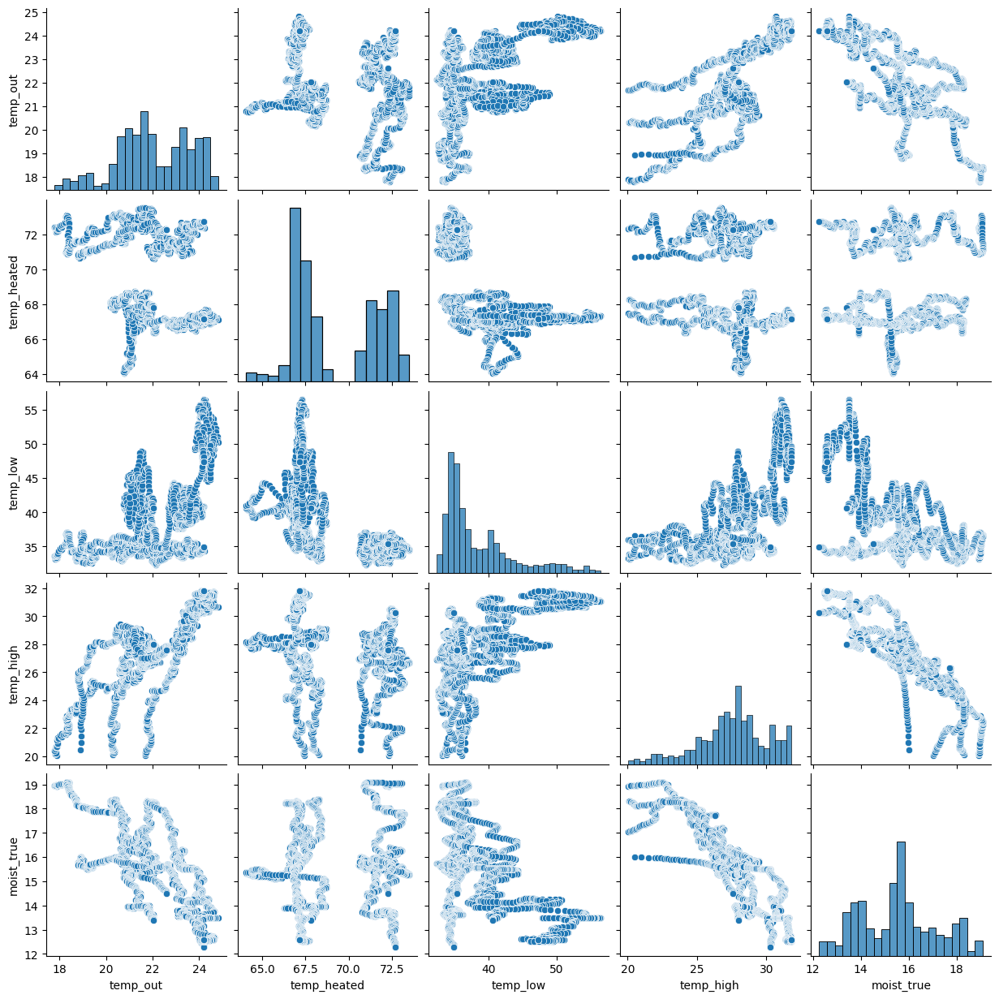

In [ ]:
# prompt: concatenate the datasets aand compute correlation matrix between variables and the sns pairplot on downsampled dataset

# Concatenate the datasets
combined_data = pd.concat([data1_cropped, data2_cropped, data3_cropped, data4_cropped])

# Create the pairplot on a downsampled dataset
downsampled_data = combined_data[::10]  # Downsample by a factor of 10

# Compute the correlation matrix
sns.heatmap(combined_data.corr(), annot=True)
plt.show()

correlations = downsampled_data.corr()['moist_true'].drop('moist_true')
correlations.abs().sort_values().plot(kind='barh')
plt.title('Feature Correlations with Target Variable')
plt.show()


sns.pairplot(downsampled_data[['air_temp_lost','grain_temp_gained','heat_transfer','time_elapsed','moist_true']], diag_kind='hist')
plt.show()
sns.pairplot(downsampled_data[['temp_out','temp_heated','temp_low','temp_high','moist_true']], diag_kind='hist')
plt.show()

## attempting to predict absolute value of humidity

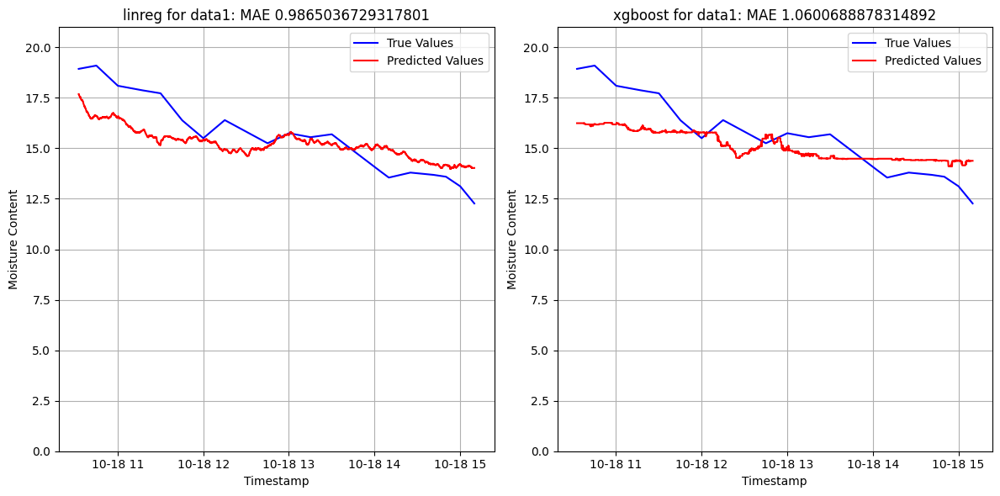

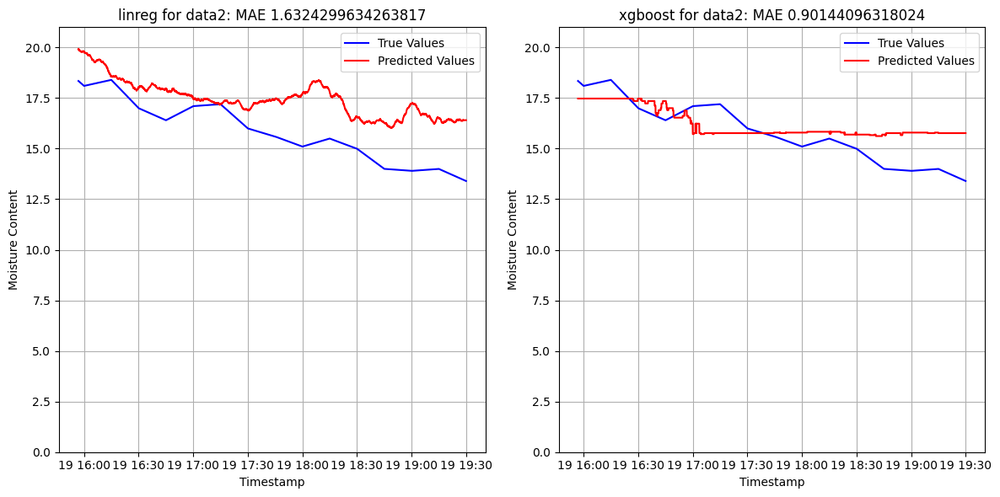

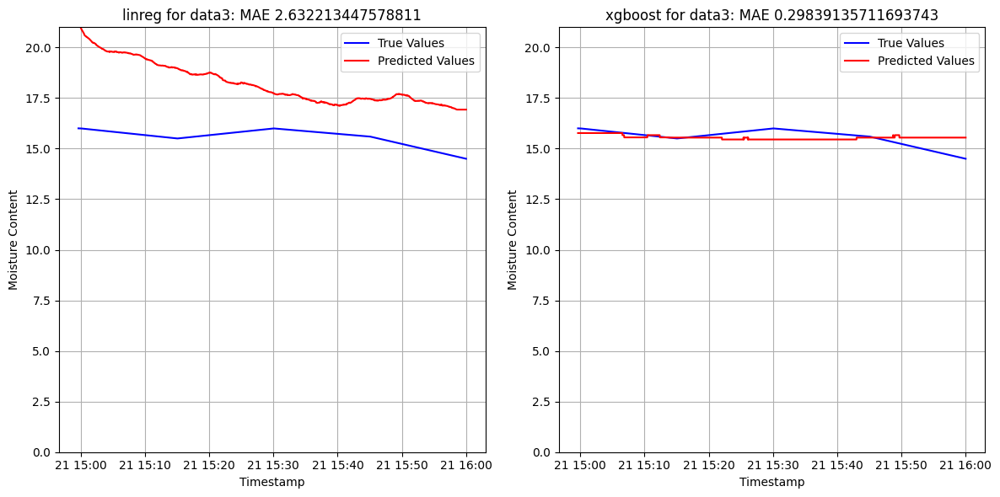

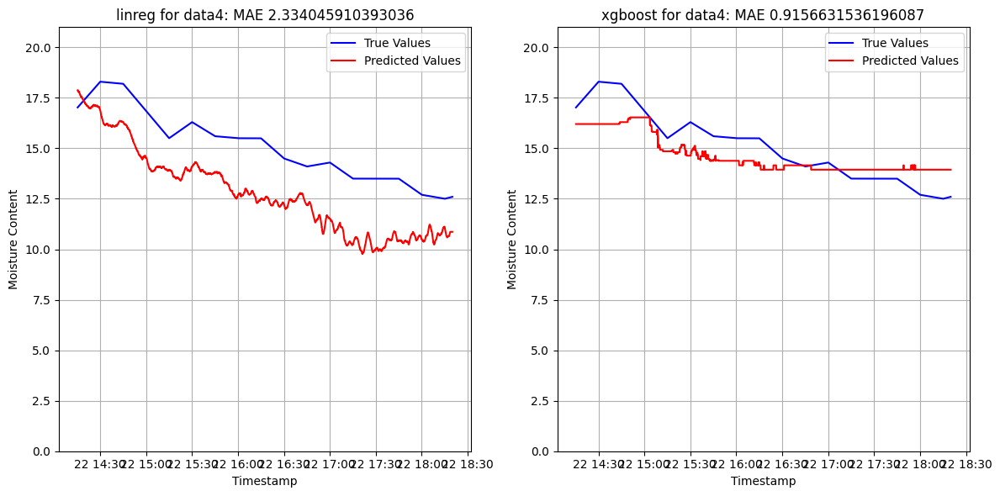

{'linreg': [0.9865036729317801, 1.6324299634263817, 2.632213447578811, 2.334045910393036], 'xgboost': [1.0600688878314892, 0.90144096318024, 0.29839135711693743, 0.9156631536196087]}


In [ ]:
# prompt: wrtie code that implements leave-one-dataset-out cross validation loop over the 4 datasets data1_cropped, data2_cropped, data3_cropped, data4_cropped. leave model definition blank, but define training and validation sets and basic structures for computing error metrics on training and validation sets
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 20,
    'reg_alpha': 1,
    'reg_lambda': 5,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["air_temp_lost","grain_temp_gained", "temp_out","temp_high","temp_low","start_moisture"]]
    y_train = train_data['moist_true']

    X_val = validation_data[["air_temp_lost","grain_temp_gained", "temp_out","temp_high","temp_low","start_moisture"]]
    y_val = validation_data['moist_true']

    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(12, 6))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {val_mse}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(0, 21)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

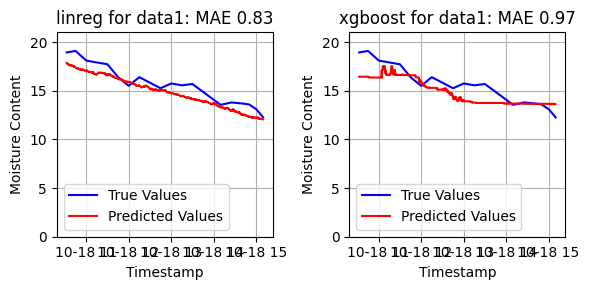

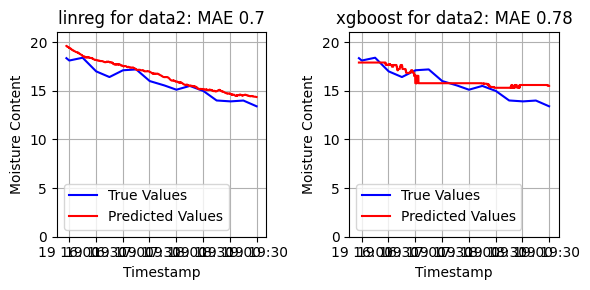

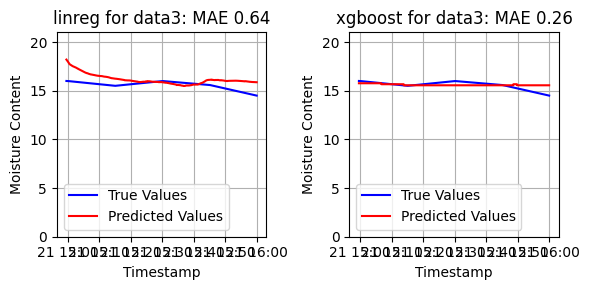

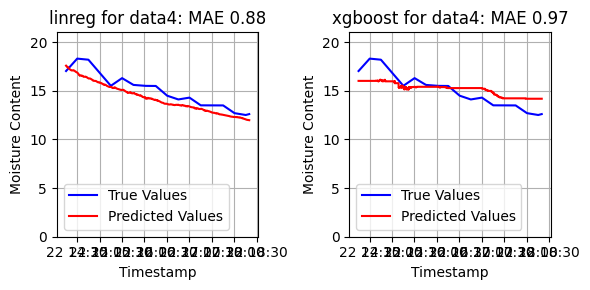

{'linreg': [0.8323045165875205, 0.698564522008128, 0.6436793754129632, 0.8818246548631974], 'xgboost': [0.9745507872275732, 0.7830093988217927, 0.2608721924459441, 0.9651716025459423]}


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 10,
    'reg_alpha': 1,
    'reg_lambda': 10,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["temp_high","temp_out", "start_moisture", "heat_transfer"]]
    y_train = train_data['moist_true']

    X_val = validation_data[["temp_high","temp_out", "start_moisture", "heat_transfer"]]
    y_val = validation_data['moist_true']


    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(6, 3))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {np.round(val_mse,2)}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(0, 21)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

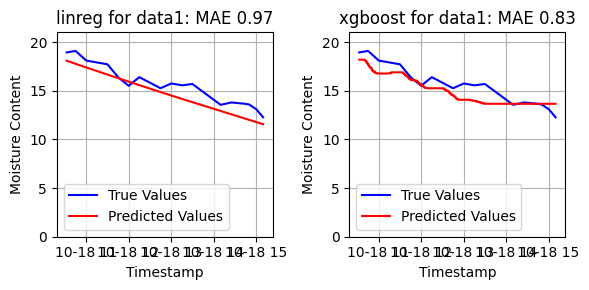

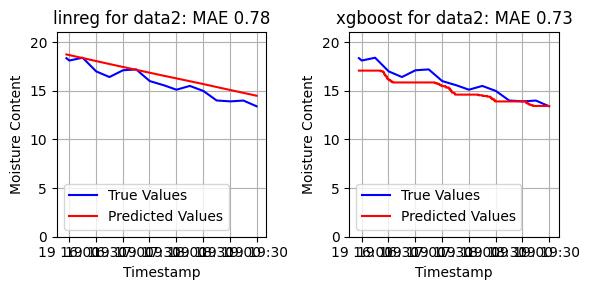

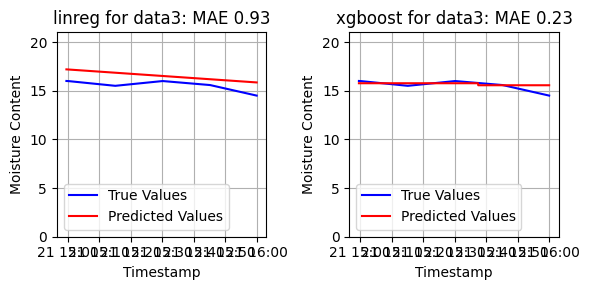

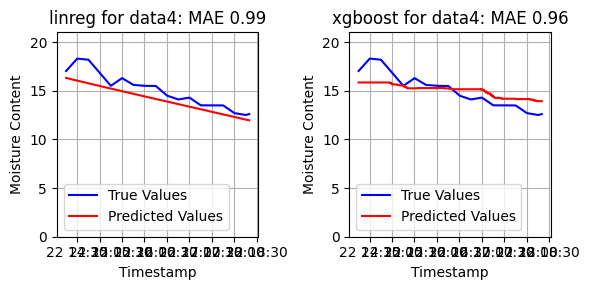

{'linreg': [0.9745163915702795, 0.7804308795977498, 0.929387885037651, 0.9915949054276536], 'xgboost': [0.8325532216504371, 0.7303151241603472, 0.22527345214811986, 0.9563507157510522]}


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 10,
    'reg_alpha': 1,
    'reg_lambda': 10,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[[ "start_moisture", "heat_transfer"]]
    y_train = train_data['moist_true']

    X_val = validation_data[["start_moisture", "heat_transfer"]]
    y_val = validation_data['moist_true']


    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(6, 3))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {np.round(val_mse,2)}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(0, 21)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

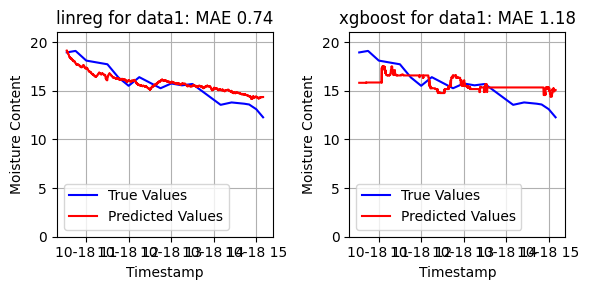

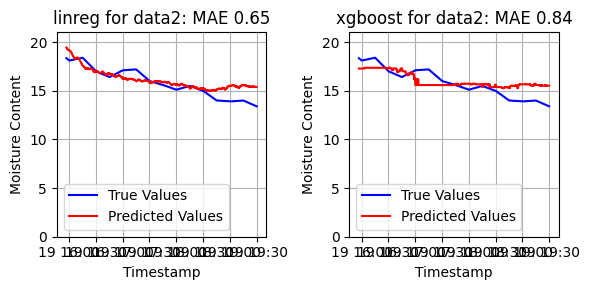

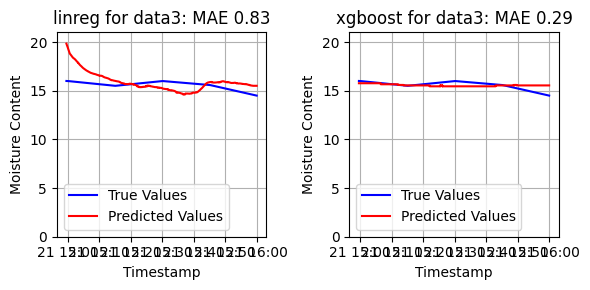

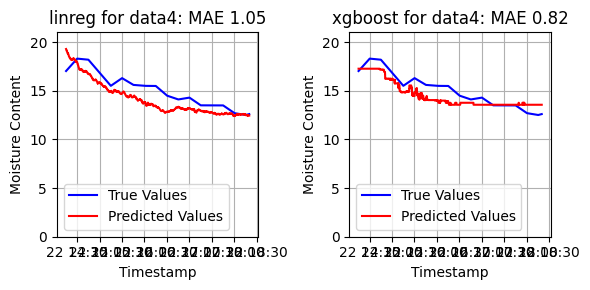

{'linreg': [0.7378787207515756, 0.6470427097191349, 0.8272663260083242, 1.048681502555183], 'xgboost': [1.1815883114336956, 0.8442122866602372, 0.29109549968321435, 0.8207277636001751]}


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 10,
    'reg_alpha': 1,
    'reg_lambda': 10,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["temp_high","temp_out"]]
    y_train = train_data['moist_true']

    X_val = validation_data[["temp_high","temp_out"]]
    y_val = validation_data['moist_true']


    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(6, 3))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {np.round(val_mse,2)}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(0, 21)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

# trying to predict change in moisture

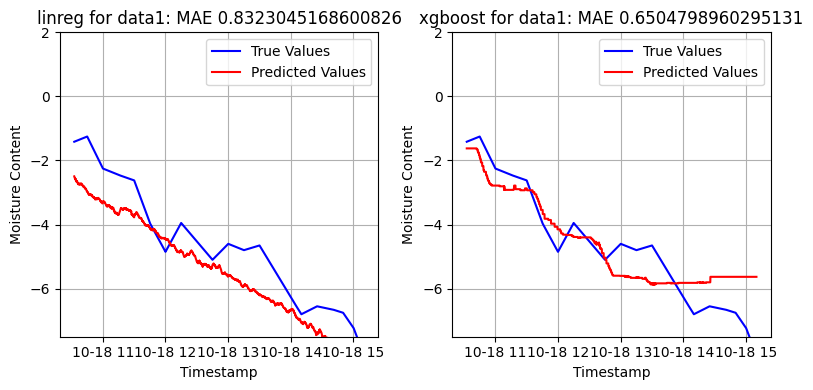

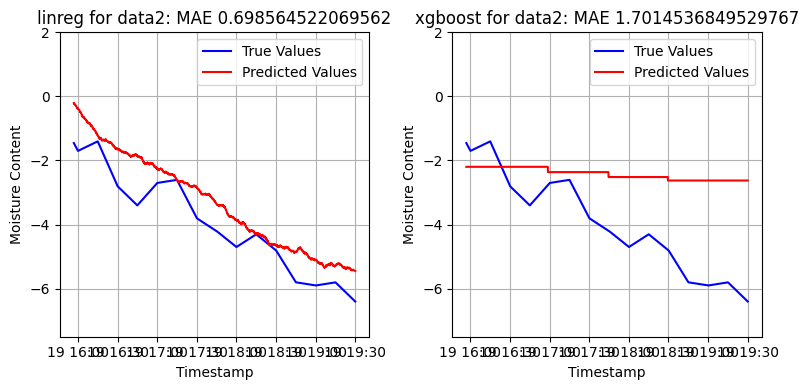

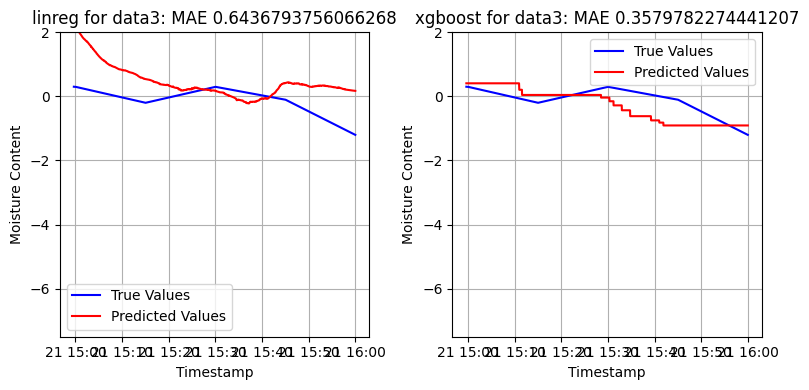

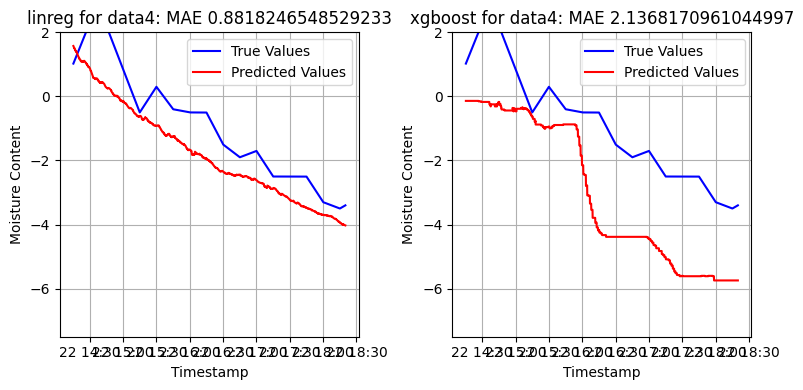

{'linreg': [0.8323045168600826, 0.698564522069562, 0.6436793756066268, 0.8818246548529233], 'xgboost': [0.6504798960295131, 1.7014536849529767, 0.3579782274441207, 2.1368170961044997]}


In [ ]:
# prompt: wrtie code that implements leave-one-dataset-out cross validation loop over the 4 datasets data1_cropped, data2_cropped, data3_cropped, data4_cropped. leave model definition blank, but define training and validation sets and basic structures for computing error metrics on training and validation sets
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 20,
    'reg_alpha': 1,
    'reg_lambda': 5,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["temp_high","temp_out", "start_moisture", "heat_transfer"]]
    y_train = train_data['moist_true'] - train_data['start_moisture'] # Target is now the CHANGE in moisture

    X_val = validation_data[["temp_high","temp_out", "start_moisture", "heat_transfer"]]
    y_val = validation_data['moist_true'] - validation_data['start_moisture'] # Target is now the CHANGE in moisture
    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(8, 4))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {val_mse}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(-7.5, 2)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

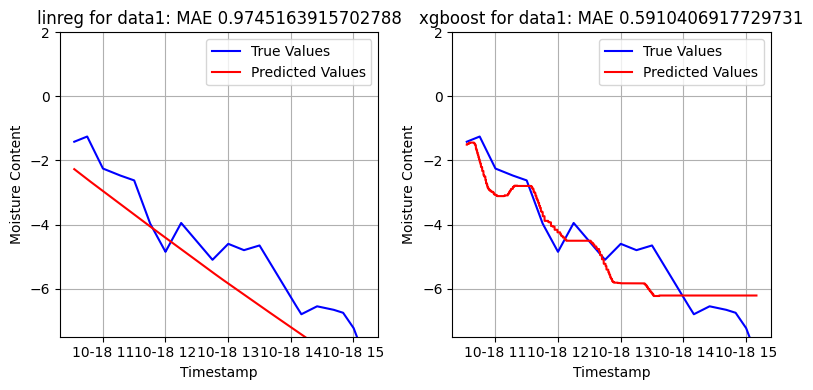

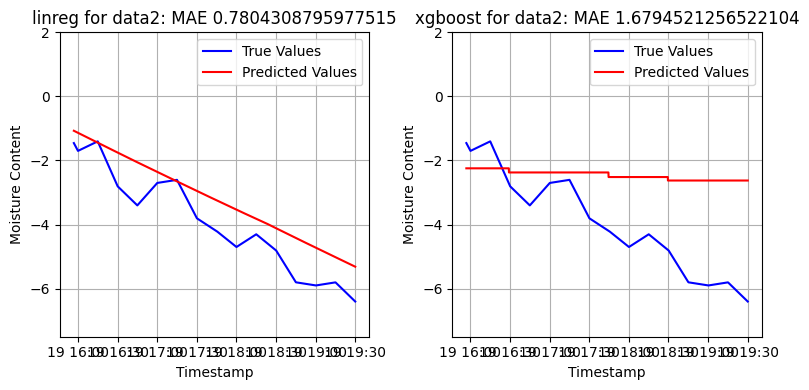

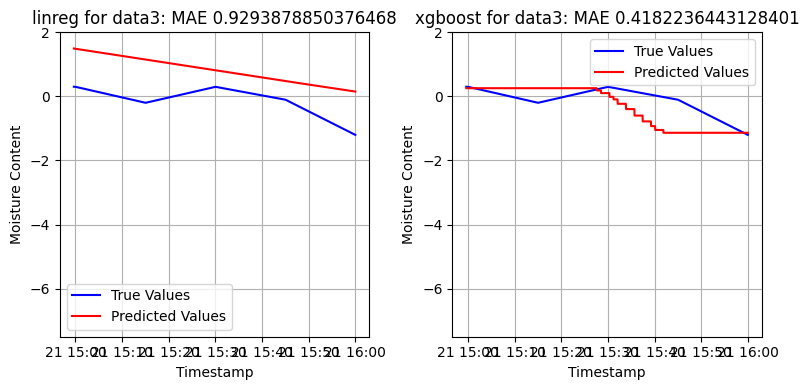

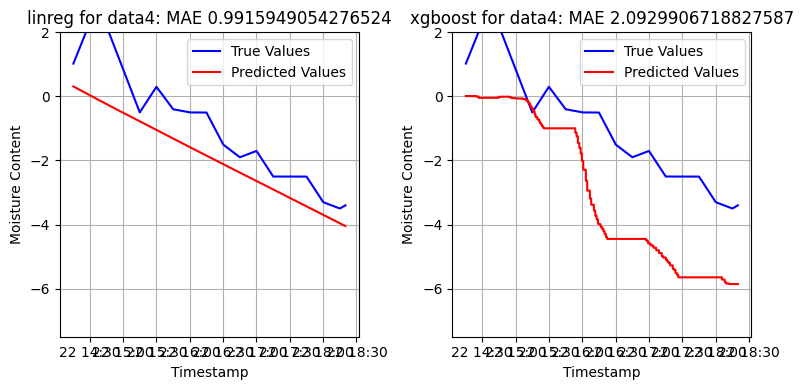

{'linreg': [0.9745163915702788, 0.7804308795977515, 0.9293878850376468, 0.9915949054276524], 'xgboost': [0.5910406917729731, 1.6794521256522104, 0.4182236443128401, 2.0929906718827587]}


In [ ]:
# prompt: wrtie code that implements leave-one-dataset-out cross validation loop over the 4 datasets data1_cropped, data2_cropped, data3_cropped, data4_cropped. leave model definition blank, but define training and validation sets and basic structures for computing error metrics on training and validation sets
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from xgboost import XGBRegressor


datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

results={"linreg":[],"xgboost":[]}
models = ["linreg","xgboost"]

params = {
    'max_depth': 3,
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 0.5,
    'colsample_bytree': 1.0,
    'min_child_weight': 20,
    'reg_alpha': 1,
    'reg_lambda': 5,
    'objective': 'reg:squarederror',  # or 'binary:logistic' for classification
    'eval_metric':'mae',  # Add eval_metric here
    'early_stopping_rounds':5

}

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["start_moisture", "heat_transfer"]]
    y_train = train_data['moist_true'] - train_data['start_moisture'] # Target is now the CHANGE in moisture

    X_val = validation_data[["start_moisture", "heat_transfer"]]
    y_val = validation_data['moist_true'] - validation_data['start_moisture'] # Target is now the CHANGE in moisture
    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model1 = LinearRegression()
    model2 = XGBRegressor(**params)

    # Model training
    model1.fit(X_train, y_train)
    model2.fit(X_train, y_train,
        eval_set=[(X_val, y_val)],  # Validation set
        verbose=False  )


    fig, axes = plt.subplots(1, 2, figsize=(8, 4))  # 1 row, 2 columns grid for side-by-side subplots

    for j, model in enumerate([model1, model2]):
      # Model predictions
      y_train_pred = model.predict(X_train)
      y_val_pred = model.predict(X_val)

      # Error metrics calculation (example: MAE)
      train_mse = mean_absolute_error(y_train, y_train_pred)
      val_mse = mean_absolute_error(y_val, y_val_pred)
      results[models[j]].append(val_mse)

      # Plotting in the respective subplot
      ax = axes[j]  # Select the correct subplot
      ax.plot(y_val.index, y_val.values, label='True Values', color='blue')
      ax.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
      ax.set_title(f"{models[j]} for {dataset_names[i]}: MAE {val_mse}")
      ax.set_xlabel("Timestamp")
      ax.set_ylabel("Moisture Content")
      ax.legend()
      ax.set_ylim(-7.5, 2)  # Adjust if needed
      ax.grid(True)

    plt.tight_layout()  # Adjust spacing to prevent overlap
    plt.show()
print(results)

Results for data1 (left out):
- Training MAE: 0.00874051081936689
- Validation MAE: 0.5678793111192293




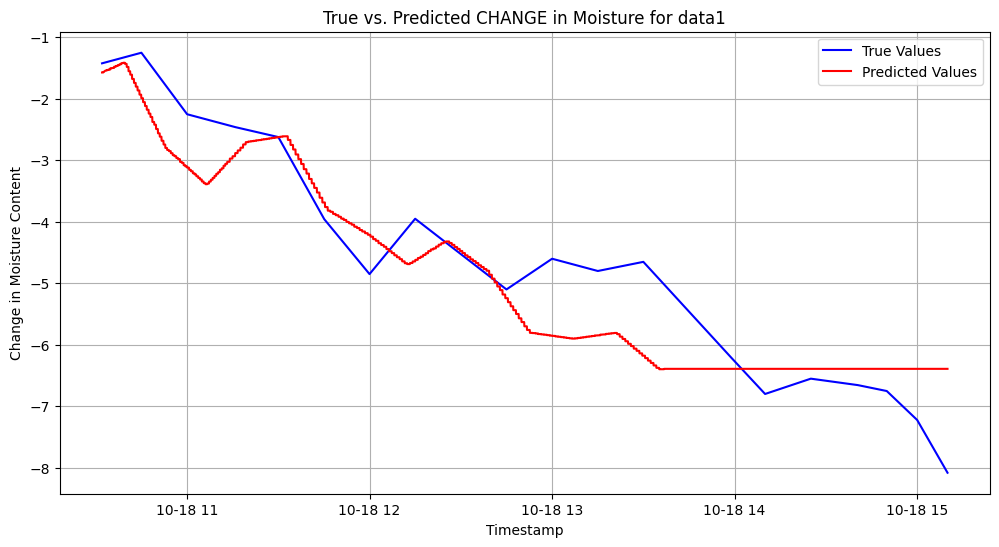

Results for data2 (left out):
- Training MAE: 0.011736616081078162
- Validation MAE: 2.9759973449335524




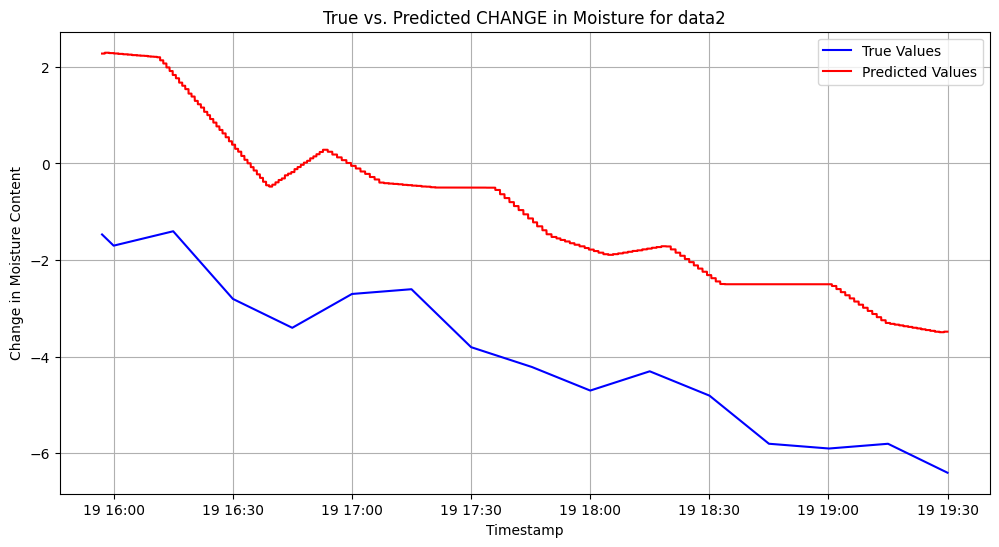

Results for data3 (left out):
- Training MAE: 0.012645656468807134
- Validation MAE: 1.238380539601384




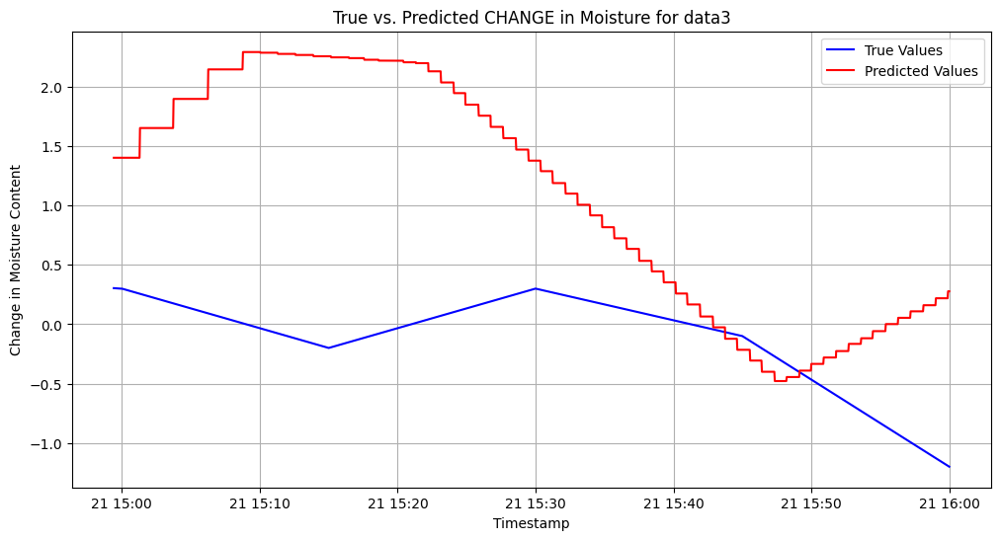

Results for data4 (left out):
- Training MAE: 0.01153875749826983
- Validation MAE: 2.137461484307388




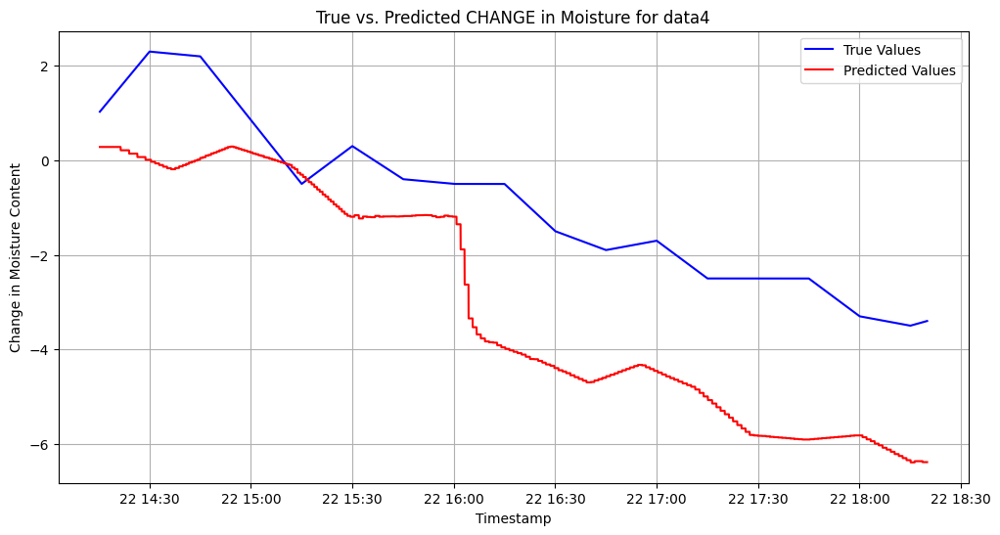

In [ ]:
# prompt: now repeat this for the task of trying to predict change in moisture, not absolute value

datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["start_moisture", "heat_transfer"]]
    y_train = train_data['moist_true'] - train_data['start_moisture'] # Target is now the CHANGE in moisture

    X_val = validation_data[["start_moisture", "heat_transfer"]]
    y_val = validation_data['moist_true'] - validation_data['start_moisture'] # Target is now the CHANGE in moisture

    #just in case the fitting is sensitive
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Model definition (replace with actual model)
    model = XGBRegressor()

    # Model training
    model.fit(X_train, y_train)

    # Model predictions
    y_train_pred = model.predict(X_train)
    y_val_pred = model.predict(X_val)

    # Error metrics calculation (example: MAE)
    train_mse = mean_absolute_error(y_train, y_train_pred)
    val_mse =  mean_absolute_error(y_val, y_val_pred)

    print(f"Results for {dataset_names[i]} (left out):")
    print(f"- Training MAE: {train_mse}")
    print(f"- Validation MAE: {val_mse}")
    print("\n")

    plt.figure(figsize=(12, 6))
    plt.plot(y_val.index, y_val.values, label='True Values', color='blue')
    plt.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
    plt.title(f"True vs. Predicted CHANGE in Moisture for {dataset_names[i]}")
    plt.xlabel("Timestamp")
    plt.ylabel("Change in Moisture Content")
    plt.legend()
    #plt.ylim(0,21) #adjust if needed, remove this as we are now predicting change, not absolute value
    plt.grid(True)
    plt.show()

##MLP

Results for data1 (left out):
- Training MAE: 0.19021752122917004
- Validation MAE: 2.085384867205977




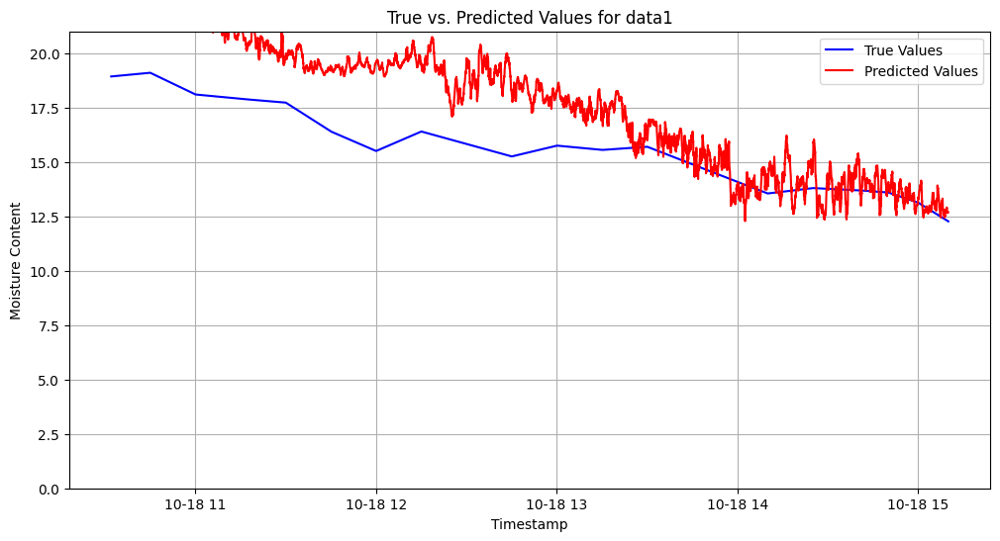

Results for data2 (left out):
- Training MAE: 0.17474488254422474
- Validation MAE: 2.563033594768257




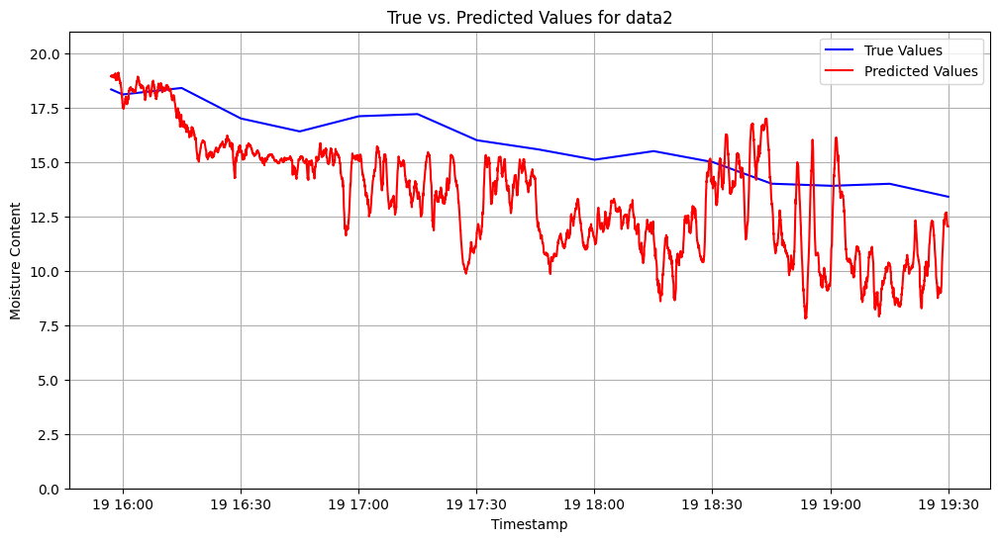

Results for data3 (left out):
- Training MAE: 0.1989386952872167
- Validation MAE: 5.720157391733114




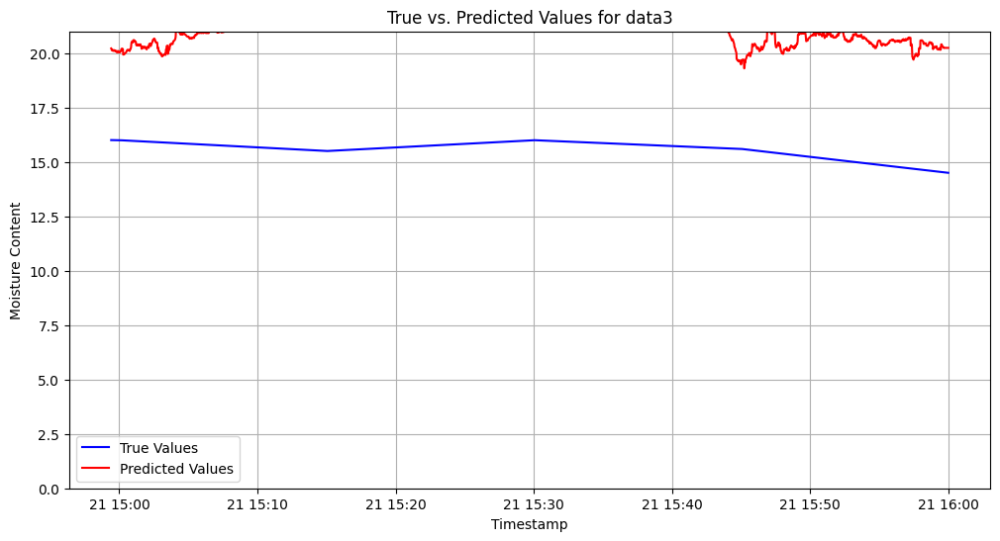

Results for data4 (left out):
- Training MAE: 0.15958687001874386
- Validation MAE: 5.472480814877735




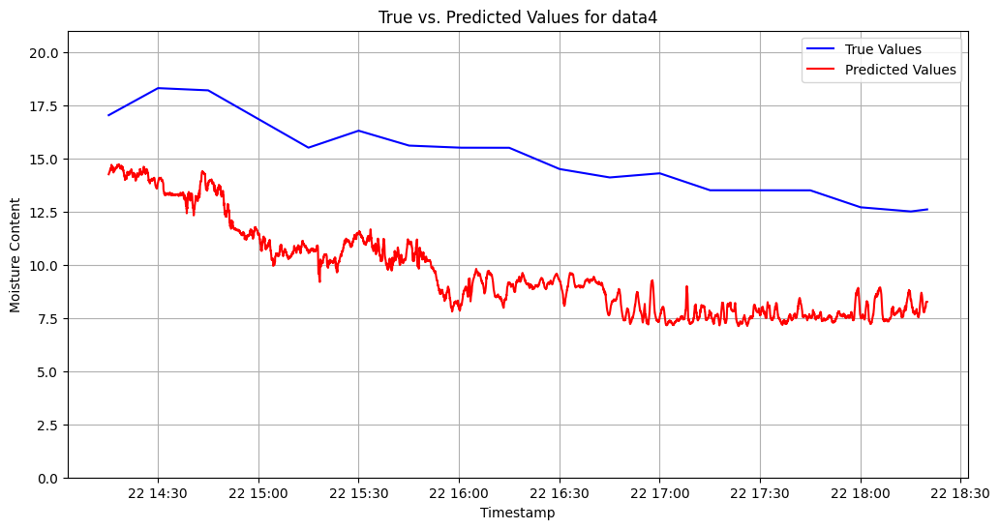

In [ ]:
# prompt: wrtie code that implements leave-one-dataset-out cross validation loop over the 4 datasets data1_cropped, data2_cropped, data3_cropped, data4_cropped. leave model definition blank, but define training and validation sets and basic structures for computing error metrics on training and validation sets
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler

datasets = [data1_cropped, data2_cropped, data3_cropped, data4_cropped]
dataset_names = ['data1', 'data2', 'data3', 'data4']

for i in range(len(datasets)):
    # Define training and validation sets
    train_datasets = datasets[:i] + datasets[i+1:]
    train_data = pd.concat(train_datasets)
    validation_data = datasets[i]

    # Prepare features (X) and target (y) for both training and validation
    X_train = train_data[["air_temp_lost","grain_temp_gained", "temp_out","temp_high","temp_low","start_moisture"]]
    y_train = train_data['moist_true']

    X_val = validation_data[["air_temp_lost","grain_temp_gained", "temp_out","temp_high","temp_low","start_moisture"]]
    y_val = validation_data['moist_true']

    #just in case the fitting is sensitive
    from sklearn.utils import shuffle
    X_train, y_train = shuffle(X_train, y_train, random_state=42)

    # Scale the data (important for MLP)
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_val)

    # Define and train the MLP model
    mlp = MLPRegressor(hidden_layer_sizes=(64, 16), max_iter=500, random_state=42)
    mlp.fit(X_train, y_train)

    # Model predictions
    y_train_pred = mlp.predict(X_train)
    y_val_pred = mlp.predict(X_test)

    # Error metrics calculation (example: MAE)
    train_mse = mean_absolute_error(y_train, y_train_pred)
    val_mse =  mean_absolute_error(y_val, y_val_pred)

    print(f"Results for {dataset_names[i]} (left out):")
    print(f"- Training MAE: {train_mse}")
    print(f"- Validation MAE: {val_mse}")
    print("\n")

    plt.figure(figsize=(12, 6))
    plt.plot(y_val.index, y_val.values, label='True Values', color='blue')
    plt.plot(y_val.index, y_val_pred, label='Predicted Values', color='red')
    plt.title(f"True vs. Predicted Values for {dataset_names[i]}")
    plt.xlabel("Timestamp")
    plt.ylabel("Moisture Content")
    plt.legend()
    plt.ylim(0,21) #adjust if needed
    plt.grid(True)
    plt.show()

## Random Forest

In [ ]:
# Train Random Forest model
from sklearn.ensemble import RandomForestRegressor

rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [ ]:
# Evaluate the model
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error (MSE) with all features: {mse}")

Mean Squared Error (MSE) with all features: 0.3613407103075475


Feature importance analysis

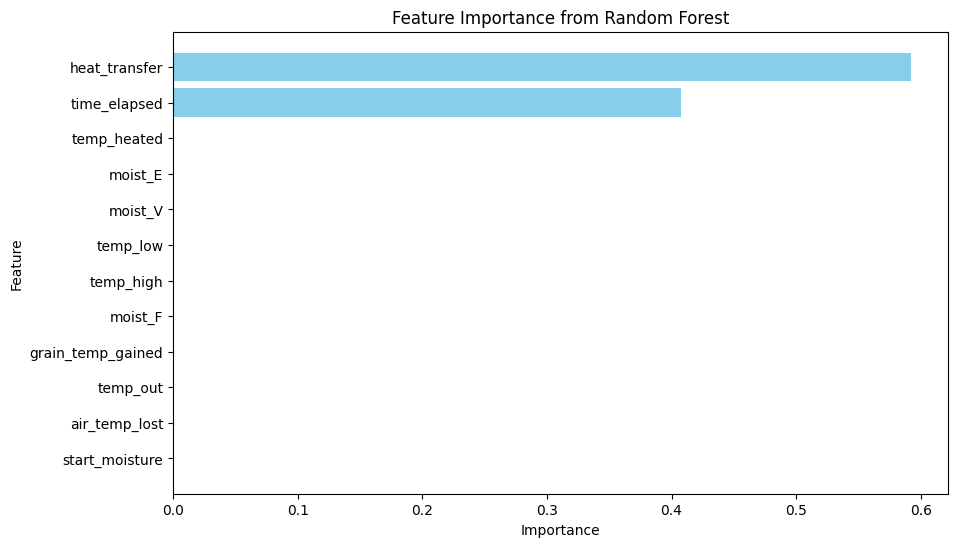

In [ ]:
# Get feature importance from Random Forest
feature_importance = rf_model.feature_importances_
importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importance
}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importance from Random Forest")
plt.gca().invert_yaxis()
plt.show()

In [ ]:
# Select top N features (e.g., top 5)
top_features = importance_df['Feature'].head(5).tolist()
print("Top Selected Features:", top_features)

# Subset the data with top features
X_selected = X[top_features]

# Split the data again with selected features
X_train_selected, X_test_selected, y_train_selected, y_test_selected = train_test_split(X_selected, y, test_size=0.2, random_state=42, shuffle=False)

# Retrain the Random Forest model with selected features
rf_model_selected = RandomForestRegressor(random_state=42, n_estimators=100)
rf_model_selected.fit(X_train_selected, y_train_selected)

# Evaluate the model with selected features
y_pred_selected = rf_model_selected.predict(X_test_selected)
mse_selected = mean_squared_error(y_test_selected, y_pred_selected)
print(f"Mean Squared Error (MSE) with selected features: {mse_selected}")

Top Selected Features: ['heat_transfer', 'time_elapsed', 'temp_heated', 'moist_E', 'moist_V']
Mean Squared Error (MSE) with selected features: 0.36078824967892653


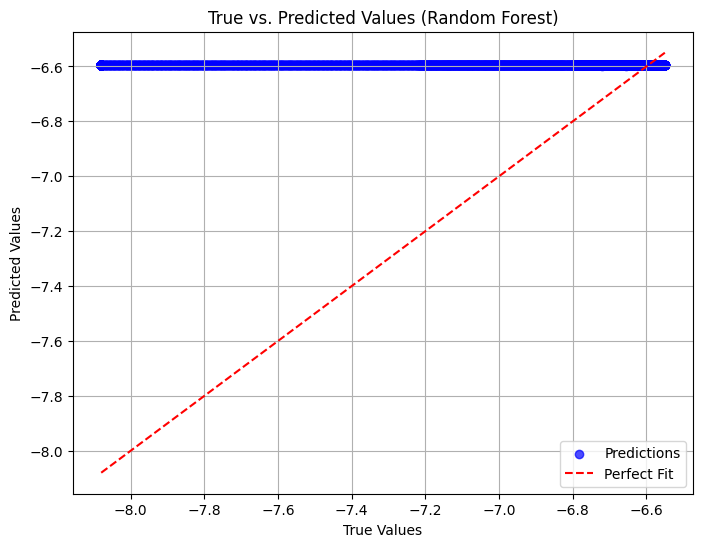

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Scatter plot of true vs. predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.7, color='blue', label='Predictions')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', label='Perfect Fit')
plt.title("True vs. Predicted Values (Random Forest)")
plt.xlabel("True Values")
plt.ylabel("Predicted Values")
plt.legend()
plt.grid()
plt.show()

# **W42_cycle_2024-10-19_15-06-00**

In [ ]:
data_5 = pd.read_csv('/content/W42_cycle_2024-10-19_15-06-00.csv')
data_5

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-19 15:06:18+03:00,16.7,10.7,15.7,11.2,NaN,NaN,NaN,NaN
1,2024-10-19 15:06:43+03:00,16.7,10.8,12.2,11.7,NaN,NaN,NaN,NaN
2,2024-10-19 15:07:08+03:00,16.9,10.6,12.0,11.6,NaN,NaN,NaN,NaN
3,2024-10-19 15:07:33+03:00,21.6,12.6,11.9,10.9,NaN,NaN,NaN,NaN
4,2024-10-19 15:07:58+03:00,27.7,10.4,11.7,11.4,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
20677,2024-10-19 20:08:08+03:00,43.1,22.9,42.6,32.0,NaN,NaN,NaN,NaN
20678,2024-10-19 20:08:08.518000+03:00,NaN,NaN,NaN,NaN,151.85,143.55,164.15,NaN
20679,2024-10-19 20:08:10+03:00,46.9,22.6,41.1,29.2,NaN,NaN,NaN,NaN
20680,2024-10-19 20:08:10.185000+03:00,NaN,NaN,NaN,NaN,150.60,142.90,163.95,NaN


In [ ]:
data_5['datetime'] = pd.to_datetime(data_5['datetime'], format="mixed")
data_5.set_index('datetime', inplace=True)

In [ ]:
data_5

,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
datetime,,,,,,,,
2024-10-19 15:06:18+03:00,16.7,10.7,15.7,11.2,NaN,NaN,NaN,NaN
2024-10-19 15:06:43+03:00,16.7,10.8,12.2,11.7,NaN,NaN,NaN,NaN
2024-10-19 15:07:08+03:00,16.9,10.6,12.0,11.6,NaN,NaN,NaN,NaN
2024-10-19 15:07:33+03:00,21.6,12.6,11.9,10.9,NaN,NaN,NaN,NaN
2024-10-19 15:07:58+03:00,27.7,10.4,11.7,11.4,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
2024-10-19 20:08:08+03:00,43.1,22.9,42.6,32.0,NaN,NaN,NaN,NaN
2024-10-19 20:08:08.518000+03:00,NaN,NaN,NaN,NaN,151.85,143.55,164.15,NaN
2024-10-19 20:08:10+03:00,46.9,22.6,41.1,29.2,NaN,NaN,NaN,NaN


In [ ]:
data5_interpolated = data_5.interpolate(method='time')
data5_interpolated.fillna(method='ffill', inplace=True)
data5_interpolated.fillna(method='bfill', inplace=True)
data5_interpolated

data4_interpolated_cropped = data5_interpolated.iloc[len(data5_interpolated)//7:-len(data5_interpolated)//7,:]
data4_interpolated_cropped[100:150]

<ipython-input-47-6ed5f244bf43>:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data5_interpolated.fillna(method='ffill', inplace=True)
<ipython-input-47-6ed5f244bf43>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data5_interpolated.fillna(method='bfill', inplace=True)


,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
datetime,,,,,,,,
2024-10-19 15:57:16+03:00,68.30000,20.50000,33.90000,20.60000,159.365015,150.912896,173.378090,18.318667
2024-10-19 15:57:16.728000+03:00,68.22720,20.39080,33.79080,20.23600,158.800000,150.500000,172.900000,18.317696
2024-10-19 15:57:18+03:00,68.10000,20.20000,33.60000,19.60000,159.437876,150.725133,173.125133,18.316000
2024-10-19 15:57:18.423000+03:00,69.70740,20.28460,33.43080,19.76920,159.650000,150.800000,173.200000,18.315436
2024-10-19 15:57:19+03:00,71.90000,20.40000,33.20000,20.00000,159.737424,150.800000,173.182515,18.314667
2024-10-19 15:57:20.073000+03:00,69.86130,20.29270,33.62920,20.10730,159.900000,150.800000,173.150000,18.313236
2024-10-19 15:57:21+03:00,68.10000,20.20000,34.00000,20.20000,160.281706,150.963588,173.286324,18.312000
2024-10-19 15:57:21.773000+03:00,68.02270,20.35460,33.96135,21.39815,160.600000,151.100000,173.400000,18.310969
2024-10-19 15:57:23+03:00,67.90000,20.60000,33.90000,23.30000,161.061012,151.561012,173.931936,18.309333


<Axes: xlabel='datetime'>

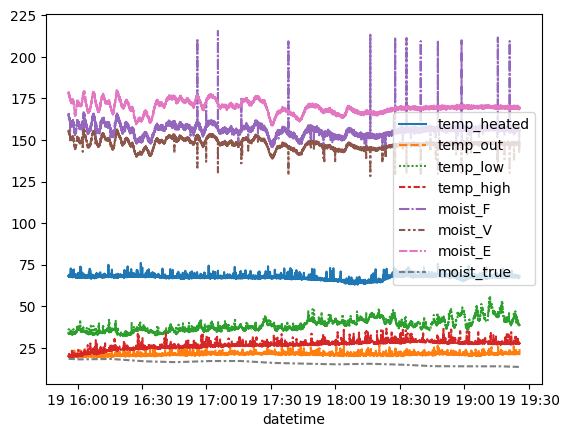

In [ ]:
sns.lineplot(data=data4_interpolated_cropped)

<Axes: >

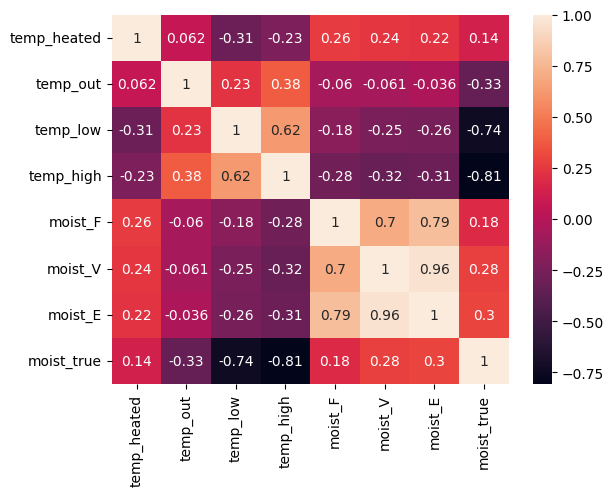

In [ ]:
sns.heatmap(data4_interpolated_cropped.corr(), annot=True)

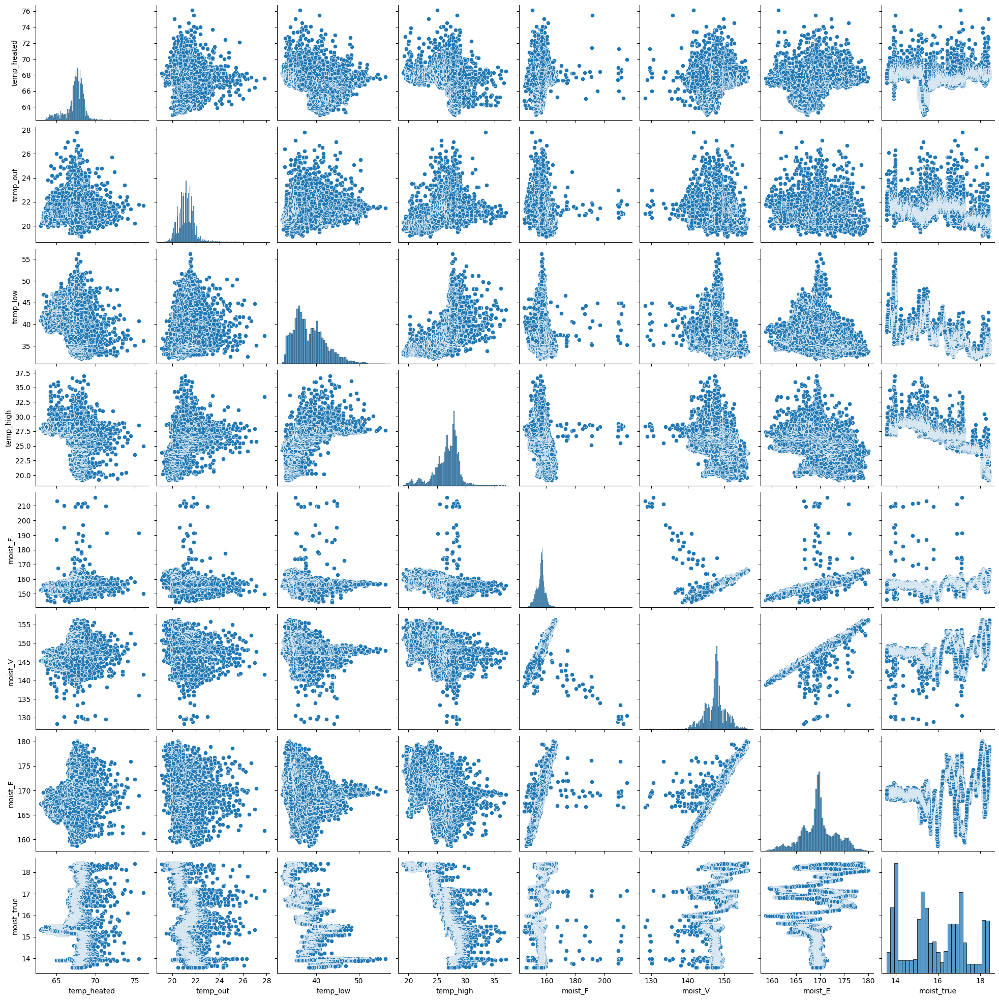

In [ ]:
sns.pairplot(data4_interpolated_cropped, diag_kind='hist')

In [ ]:
# Fisrt we calculate the heat transfer (temp_heated - temp_out)
data4_interpolated_cropped['heat_transfer'] = data4_interpolated_cropped['temp_heated'] - data4_interpolated_cropped['temp_out']

# Converting the datetime column to time deltas in seconds
data4_interpolated_cropped['time_elapsed'] = (data4_interpolated_cropped.index - data4_interpolated_cropped.index[0]).total_seconds()

# Calculate the cumulative integral of heat transfer
data4_interpolated_cropped['cumulative_heat_transfer'] = data4_interpolated_cropped['heat_transfer'].cumsum()
data4_interpolated_cropped['cumulative_heat_transfer']

<ipython-input-26-8f322036d99d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data4_interpolated_cropped['heat_transfer'] = data4_interpolated_cropped['temp_heated'] - data4_interpolated_cropped['temp_out']
<ipython-input-26-8f322036d99d>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data4_interpolated_cropped['time_elapsed'] = (data4_interpolated_cropped.index - data4_interpolated_cropped.index[0]).total_seconds()
<ipython-input-26-8f322036d99d>:8: SettingWithCopyWarning: 
A value is trying to be set

,cumulative_heat_transfer
datetime,
2024-10-19 15:55:51+03:00,48.00000
2024-10-19 15:55:52.038000+03:00,96.10380
2024-10-19 15:55:53+03:00,144.30380
2024-10-19 15:55:53.703000+03:00,192.57410
2024-10-19 15:55:55+03:00,240.97410
...,...
2024-10-19 19:25:38+03:00,682462.55435
2024-10-19 19:25:38.995000+03:00,682508.75385
2024-10-19 19:25:40+03:00,682555.05385


In [ ]:
# prompt: print out the model rf_model (linear regression) coefficients and intercept

print("Coefficients:", rf_model.coef_)
print("Intercept:", rf_model.intercept_)

AttributeError: 'RandomForestRegressor' object has no attribute 'coef_'

In [ ]:
X = data4_interpolated_cropped.drop(columns=['moist_true'])
y =  data4_interpolated_cropped['moist_true']
y_change =  data4_interpolated_cropped['moist_true']-data4_interpolated_cropped['moist_true'][0]

y_pred = rf_model.predict(X)
mse = mean_squared_error(y_change, y_pred)
print(f"Mean Squared Error (MSE) with all features: {mse}")

Mean Squared Error (MSE) with all features: 3.3550870327431332


<ipython-input-118-2c83c247aa77>:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  y_change =  data4_interpolated_cropped['moist_true']-data4_interpolated_cropped['moist_true'][0]


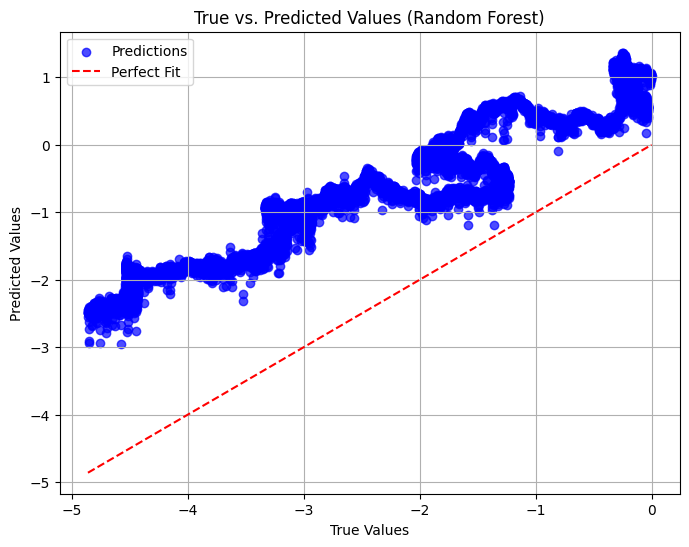

In [ ]:
# Scatter plot of true vs. predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_change, y_pred, alpha=0.7, color='blue', label='Predictions')
plt.plot([y_change.min(), y_change.max()], [y_change.min(), y_change.max()], color='red', linestyle='--', label='Perfect Fit')
plt.title("True vs. Predicted Values (Random Forest)")
plt.xlabel("True Values")
plt.ylabel("Predicted Values")
plt.legend()
plt.grid()
plt.show()

ValueError: x and y must have same first dimension, but have shapes (23728,) and (4857,)

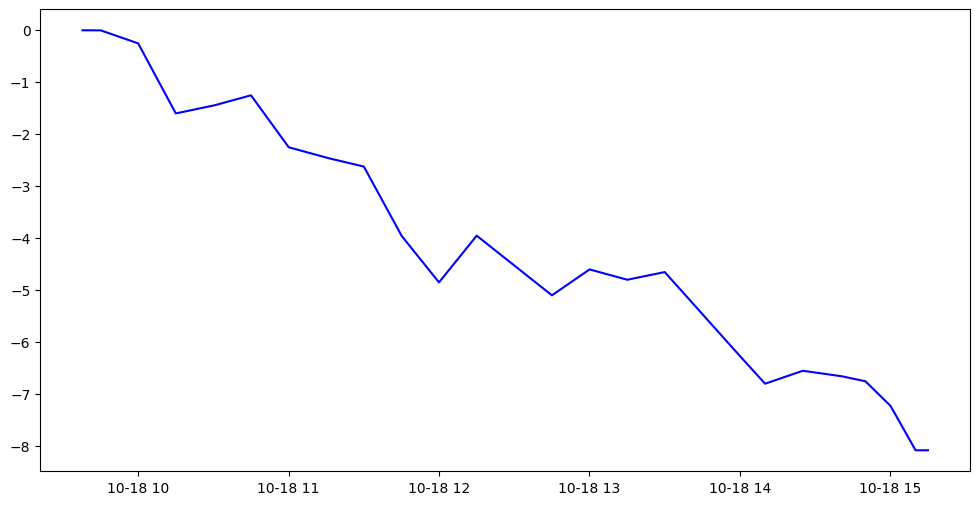

In [ ]:
# prompt: plot the true values and predictions on the same graph with x axis being the timestamp

import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'y_test' and 'y_pred' are already defined from your model's prediction
# and 'data1_interpolated' is your DataFrame with the datetime index

# Create the plot
plt.figure(figsize=(12, 6))

# Plot true values
plt.plot(y_change.index, y_change.values, label='True Values', color='blue')

# Plot predicted values
plt.plot(y_change.index, y_pred, label='Predicted Values', color='red')


plt.title("True vs. Predicted Values Over Time")
plt.xlabel("Timestamp")
plt.ylabel("Moisture Content")
plt.legend()
plt.grid(True)
plt.show()

# **W42_true_moisture**

In [ ]:
data_6 = pd.read_csv('/content/W42_true_moisture.csv')
data_6

,datetime,moist
0,2024-10-18 09:30:00,19.10
1,2024-10-18 09:45:00,20.35
2,2024-10-18 10:00:00,20.10
3,2024-10-18 10:15:00,18.75
4,2024-10-18 10:30:00,18.90
5,2024-10-18 10:45:00,19.10
6,2024-10-18 11:00:00,18.10
7,2024-10-18 11:15:00,17.90
8,2024-10-18 11:30:00,17.73
9,2024-10-18 11:45:00,16.40


In [ ]:
data_6['datetime'] = pd.to_datetime(data_6['datetime'], format='mixed')
data_6.set_index('datetime')

,moist
datetime,
2024-10-18 09:30:00,19.10
2024-10-18 09:45:00,20.35
2024-10-18 10:00:00,20.10
2024-10-18 10:15:00,18.75
2024-10-18 10:30:00,18.90
2024-10-18 10:45:00,19.10
2024-10-18 11:00:00,18.10
2024-10-18 11:15:00,17.90
2024-10-18 11:30:00,17.73


(array([20014.33333333, 20014.5       , 20014.66666667, 20014.83333333,
        20015.        , 20015.16666667, 20015.33333333, 20015.5       ,
        20015.66666667, 20015.83333333]),
 [Text(20014.333333333332, 0, '10-18 08'),
  Text(20014.5, 0, '10-18 12'),
  Text(20014.666666666668, 0, '10-18 16'),
  Text(20014.833333333332, 0, '10-18 20'),
  Text(20015.0, 0, '10-19 00'),
  Text(20015.166666666668, 0, '10-19 04'),
  Text(20015.333333333332, 0, '10-19 08'),
  Text(20015.5, 0, '10-19 12'),
  Text(20015.666666666668, 0, '10-19 16'),
  Text(20015.833333333332, 0, '10-19 20')])

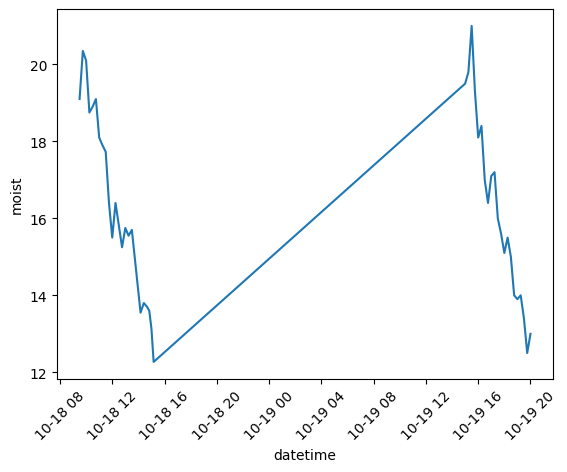

In [ ]:
sns.lineplot(data=data_6, x='datetime', y='moist')
# plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator(minticks=5, maxticks=10))
plt.xticks(rotation=45)

In [ ]:
data_6.corr()

,datetime,moist
datetime,1.00000,-0.11613
moist,-0.11613,1.00000


# **W43_cycle_2024-10-21_14-23-30**

In [ ]:
data_2 = pd.read_csv('/content/W43_cycle_2024-10-21_14-23-30.csv')
data_2

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-21 14:23:31+03:00,14.5,9.6,11.3,9.9,NaN,NaN,NaN,NaN
1,2024-10-21 14:23:31.294000+03:00,NaN,NaN,NaN,NaN,158.70,150.80,173.95,NaN
2,2024-10-21 14:23:32+03:00,14.1,8.9,14.1,9.8,NaN,NaN,NaN,NaN
3,2024-10-21 14:23:32.969000+03:00,NaN,NaN,NaN,NaN,157.15,149.85,173.05,NaN
4,2024-10-21 14:23:34+03:00,14.4,9.4,11.0,9.7,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
6953,2024-10-21 16:02:16.288000+03:00,NaN,NaN,NaN,NaN,134.50,128.95,145.75,NaN
6954,2024-10-21 16:02:17+03:00,55.1,22.6,35.4,28.0,NaN,NaN,NaN,NaN
6955,2024-10-21 16:02:18.033000+03:00,NaN,NaN,NaN,NaN,134.70,129.25,146.20,NaN
6956,2024-10-21 16:02:19+03:00,54.3,22.8,35.0,28.0,NaN,NaN,NaN,NaN


In [ ]:
data_2['datetime'] = pd.to_datetime(data_2['datetime'], format="mixed")
data_2.set_index('datetime', inplace=True)

In [ ]:
data2_interpolated = data_2.interpolate(method='time')
data_2.fillna(method='ffill', inplace=True)
data_2.fillna(method='bfill', inplace=True)
data2_interpolated

<ipython-input-24-91a88ddc80c6>:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data_2.fillna(method='ffill', inplace=True)
<ipython-input-24-91a88ddc80c6>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data_2.fillna(method='bfill', inplace=True)


,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
datetime,,,,,,,,
2024-10-21 14:23:31+03:00,14.50000,9.60000,11.30000,9.90000,NaN,NaN,NaN,NaN
2024-10-21 14:23:31.294000+03:00,14.38240,9.39420,12.12320,9.87060,158.700000,150.800000,173.950000,NaN
2024-10-21 14:23:32+03:00,14.10000,8.90000,14.10000,9.80000,158.046687,150.399582,173.570657,NaN
2024-10-21 14:23:32.969000+03:00,14.24535,9.14225,12.59805,9.75155,157.150000,149.850000,173.050000,NaN
2024-10-21 14:23:34+03:00,14.40000,9.40000,11.00000,9.70000,158.431883,150.613026,173.813026,NaN
...,...,...,...,...,...,...,...,...
2024-10-21 16:02:16.288000+03:00,55.10000,22.45760,35.47120,28.07120,134.500000,128.950000,145.750000,14.5
2024-10-21 16:02:17+03:00,55.10000,22.60000,35.40000,28.00000,134.581605,129.072407,145.933610,14.5
2024-10-21 16:02:18.033000+03:00,54.68680,22.70330,35.19340,28.00000,134.700000,129.250000,146.200000,14.5


<Axes: xlabel='datetime'>

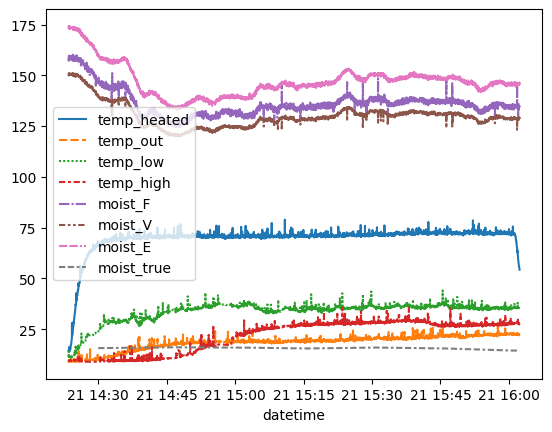

In [ ]:
sns.lineplot(data2_interpolated)

<Axes: >

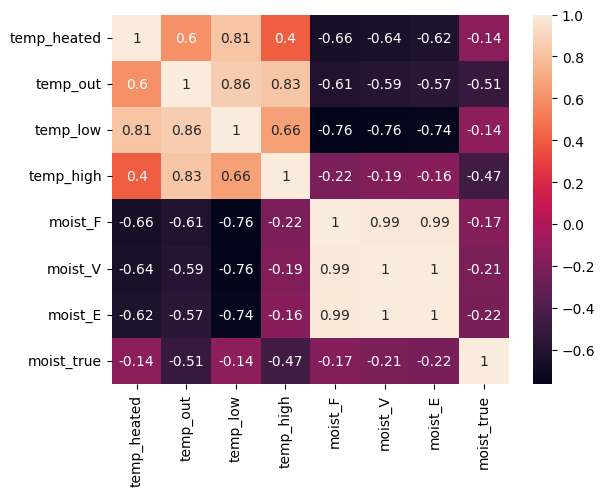

In [ ]:
sns.heatmap(data2_interpolated.corr(), annot=True)

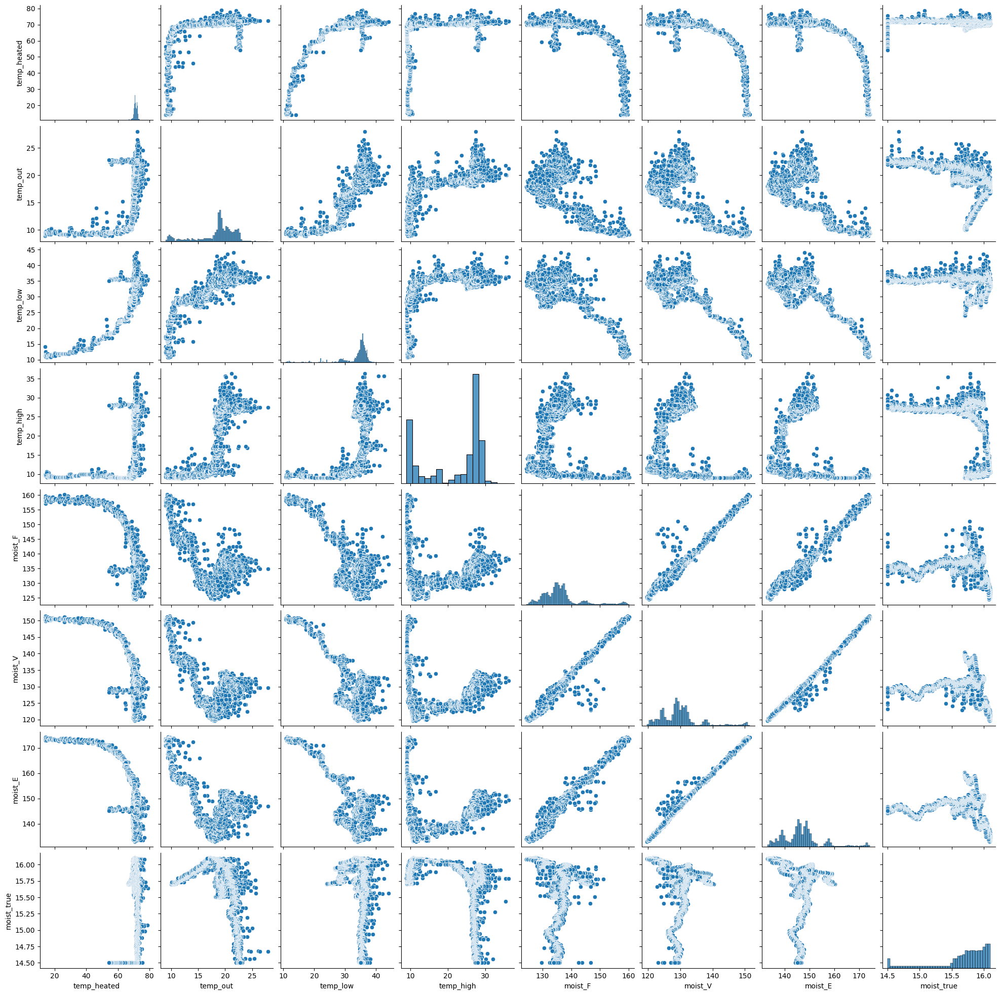

In [ ]:
sns.pairplot(data2_interpolated, diag_kind='hist')

# **W43_cycle_2024-10-22_13-33-00**

In [ ]:
data_3 = pd.read_csv('/content/W43_cycle_2024-10-22_13-33-00.csv')
data_3

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-22 13:33:00+03:00,16.5,15.3,15.2,14.5,NaN,NaN,NaN,NaN
1,2024-10-22 13:33:01.247000+03:00,NaN,NaN,NaN,NaN,159.70,150.15,171.80,NaN
2,2024-10-22 13:33:02+03:00,16.7,15.5,14.9,14.6,NaN,NaN,NaN,NaN
3,2024-10-22 13:33:02.695000+03:00,NaN,NaN,NaN,NaN,157.70,149.55,171.95,NaN
4,2024-10-22 13:33:04+03:00,18.1,15.3,15.5,13.7,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
20813,2024-10-22 18:28:57+03:00,52.4,24.5,51.0,32.3,NaN,NaN,NaN,NaN
20814,2024-10-22 18:28:57.603000+03:00,NaN,NaN,NaN,NaN,144.80,136.90,155.75,NaN
20815,2024-10-22 18:28:59+03:00,52.1,25.1,50.8,32.3,NaN,NaN,NaN,NaN
20816,2024-10-22 18:28:59.284000+03:00,NaN,NaN,NaN,NaN,143.35,136.30,154.95,NaN


In [ ]:
data_3['datetime']=pd.to_datetime(data_3['datetime'], format="mixed")
data_3.set_index('datetime', inplace=True)
data_3

,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
datetime,,,,,,,,
2024-10-22 13:33:00+03:00,16.5,15.3,15.2,14.5,NaN,NaN,NaN,NaN
2024-10-22 13:33:01.247000+03:00,NaN,NaN,NaN,NaN,159.70,150.15,171.80,NaN
2024-10-22 13:33:02+03:00,16.7,15.5,14.9,14.6,NaN,NaN,NaN,NaN
2024-10-22 13:33:02.695000+03:00,NaN,NaN,NaN,NaN,157.70,149.55,171.95,NaN
2024-10-22 13:33:04+03:00,18.1,15.3,15.5,13.7,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
2024-10-22 18:28:57+03:00,52.4,24.5,51.0,32.3,NaN,NaN,NaN,NaN
2024-10-22 18:28:57.603000+03:00,NaN,NaN,NaN,NaN,144.80,136.90,155.75,NaN
2024-10-22 18:28:59+03:00,52.1,25.1,50.8,32.3,NaN,NaN,NaN,NaN


In [ ]:
data3_interpolated = data_3.interpolate(method='linear')
data3_interpolated.fillna(method='ffill', inplace=True)
data3_interpolated.fillna(method='bfill', inplace=True)
data3_interpolated


<ipython-input-107-b4874d030cde>:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data3_interpolated.fillna(method='ffill', inplace=True)
<ipython-input-107-b4874d030cde>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data3_interpolated.fillna(method='bfill', inplace=True)


,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
datetime,,,,,,,,
2024-10-22 13:33:00+03:00,16.50,15.30,15.20,14.50,159.700,150.15,171.800,16.0
2024-10-22 13:33:01.247000+03:00,16.60,15.40,15.05,14.55,159.700,150.15,171.800,16.0
2024-10-22 13:33:02+03:00,16.70,15.50,14.90,14.60,158.700,149.85,171.875,16.0
2024-10-22 13:33:02.695000+03:00,17.40,15.40,15.20,14.15,157.700,149.55,171.950,16.0
2024-10-22 13:33:04+03:00,18.10,15.30,15.50,13.70,158.425,149.55,171.525,16.0
...,...,...,...,...,...,...,...,...
2024-10-22 18:28:57+03:00,52.40,24.50,51.00,32.30,144.350,136.60,155.325,11.5
2024-10-22 18:28:57.603000+03:00,52.25,24.80,50.90,32.30,144.800,136.90,155.750,11.5
2024-10-22 18:28:59+03:00,52.10,25.10,50.80,32.30,144.075,136.60,155.350,11.5


<Axes: xlabel='datetime'>

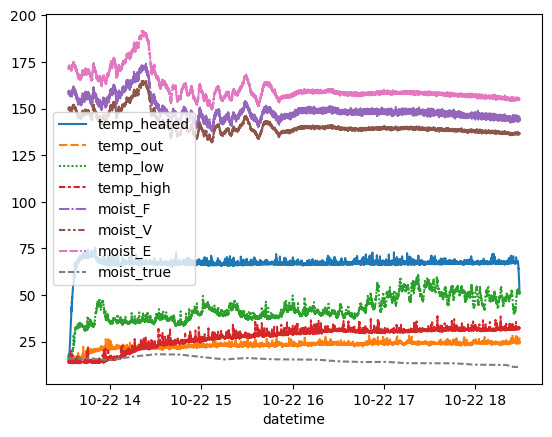

In [ ]:
sns.lineplot(data3_interpolated)

<Axes: >

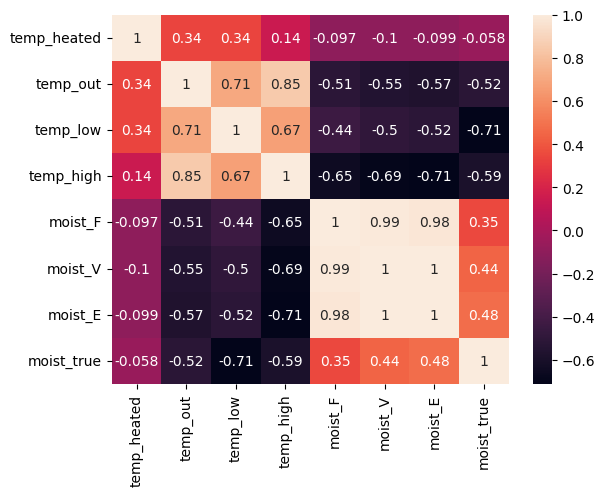

In [ ]:
sns.heatmap(data3_interpolated.corr(), annot=True)

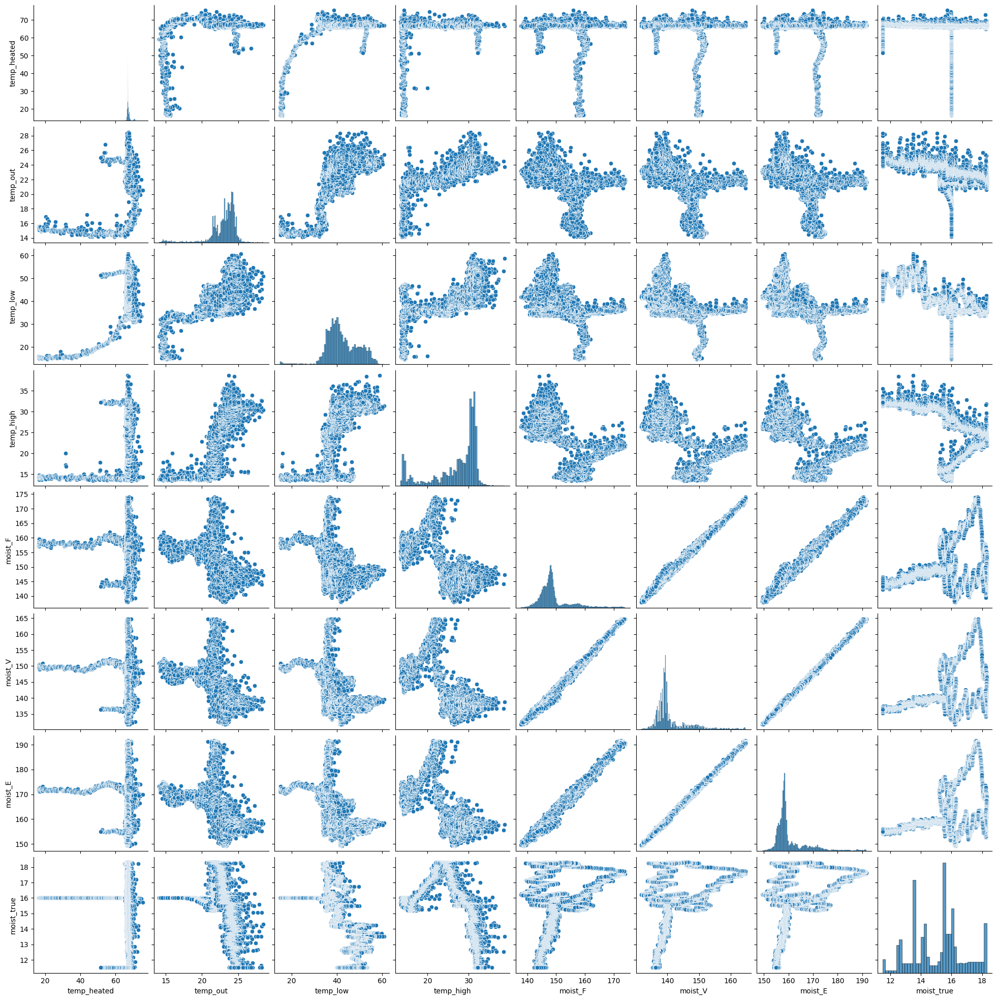

In [ ]:
sns.pairplot(data3_interpolated, diag_kind='hist')

# **W43_true_moisture**

In [ ]:
data_4 = pd.read_csv('/content/W43_true_moisture.csv', names=['datetime', 'true_moist'])
data_4

,datetime,true_moist
0,2024-10-21 14:15:00,15.6
1,2024-10-21 14:30:00,15.7
2,2024-10-21 14:45:00,16.1
3,2024-10-21 15:00:00,16.0
4,2024-10-21 15:15:00,15.5
5,2024-10-21 15:30:00,16.0
6,2024-10-21 15:45:00,15.6
7,2024-10-21 16:00:00,14.5
8,2024-10-21 16:15:00,14.1
9,2024-10-21 16:30:00,14.1


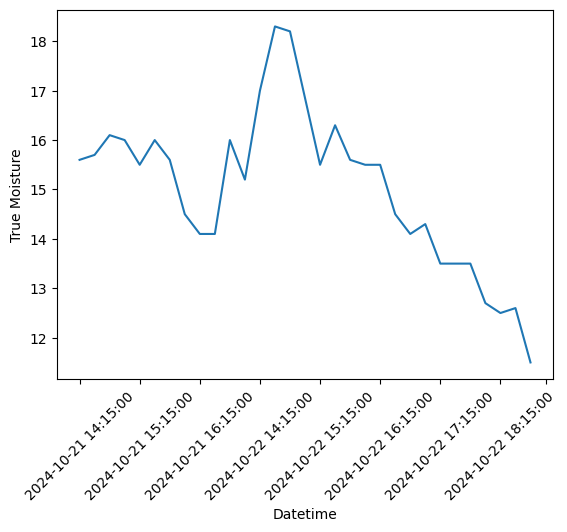

In [ ]:
sns.lineplot(data=data_4, x='datetime', y='true_moist')
plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator(minticks=5, maxticks=10))
plt.xticks(rotation=45)
plt.xlabel('Datetime')
plt.ylabel('True Moisture')
plt.show()

In [ ]:
data_4['datetime'] = pd.to_datetime(data_4['datetime'], format='mixed')
data_4.set_index(data_4['datetime'])
data4_interpolated = data_4.interpolate(method='linear')
data4_interpolated

,datetime,true_moist
0,2024-10-21 14:15:00,15.60
1,2024-10-21 14:30:00,15.70
2,2024-10-21 14:45:00,16.10
3,2024-10-21 15:00:00,16.00
4,2024-10-21 15:15:00,15.50
5,2024-10-21 15:30:00,16.00
6,2024-10-21 15:45:00,15.60
7,2024-10-21 16:00:00,14.50
8,2024-10-21 16:15:00,14.10
9,2024-10-21 16:30:00,14.10


In [ ]:
data4_interpolated.corr()

,datetime,true_moist
datetime,1.000000,-0.222778
true_moist,-0.222778,1.000000


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
import numpy as np

data = pd.read_csv('/content/W43_cycle_2024-10-22_13-33-00.csv')


data['datetime'] = pd.to_datetime(data['datetime'], errors='coerce')
data['hour'] = data['datetime'].dt.hour
data['day_of_week'] = data['datetime'].dt.dayofweek
data['month'] = data['datetime'].dt.month

data = data.drop(columns=['datetime'])

data['temp_heated_lag1'] = data['temp_heated'].shift(1)
data['temp_out_lag1'] = data['temp_out'].shift(1)
data['temp_low_lag1'] = data['temp_low'].shift(1)
data['temp_high_lag1'] = data['temp_high'].shift(1)

data.fillna(method='ffill', inplace=True)

data['moist_F'].fillna(data['moist_F'].mean(), inplace=True)
data['moist_V'].fillna(data['moist_V'].mean(), inplace=True)
data['moist_E'].fillna(data['moist_E'].mean(), inplace=True)

features = ['temp_heated', 'temp_out', 'temp_low', 'temp_high', 'hour', 'day_of_week', 'month','temp_heated_lag1', 'temp_out_lag1', 'temp_low_lag1', 'temp_high_lag1']

targets = ['moist_F', 'moist_V', 'moist_E']

X = data[features]
y = data[targets]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

hgb_regressor = MultiOutputRegressor(HistGradientBoostingRegressor(random_state=42))

hgb_regressor.fit(X_train, y_train)

y_pred = hgb_regressor.predict(X_test)

mse = mean_squared_error(y_test, y_pred, multioutput='raw_values')
r2 = r2_score(y_test, y_pred, multioutput='uniform_average')

print(f"Mean Squared Error for each target: {mse}")
print(f"R-squared: {r2}")


<ipython-input-12-eba8aaf5ca86>:31: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-12-eba8aaf5ca86>:34: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['moist_F'].fillna(data['moist_F'].mean(), inplace=True)
<ipython-input-12-eba8aaf5ca86>:35: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The beh

Mean Squared Error for each target: [4.02389426 3.23321421 5.09136216]
R-squared: 0.8996682889901573


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.multioutput import MultiOutputRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Lasso, Ridge
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
import numpy as np

data = pd.read_csv('/content/W43_cycle_2024-10-22_13-33-00.csv')


# Convert 'datetime' to datetime object and extract features
data['datetime'] = pd.to_datetime(data['datetime'], errors='coerce')
data['hour'] = data['datetime'].dt.hour
data['day_of_week'] = data['datetime'].dt.dayofweek
data['month'] = data['datetime'].dt.month

# Drop the original 'datetime' column after extracting relevant features
data = data.drop(columns=['datetime'])

# Create lag features to capture temporal dependencies
data['temp_heated_lag1'] = data['temp_heated'].shift(1)
data['temp_out_lag1'] = data['temp_out'].shift(1)
data['temp_low_lag1'] = data['temp_low'].shift(1)
data['temp_high_lag1'] = data['temp_high'].shift(1)

# Fill missing values using SimpleImputer
imputer = SimpleImputer(strategy='mean')
data_imputed = pd.DataFrame(imputer.fit_transform(data), columns=data.columns)

# Feature and target selection
features = ['temp_heated', 'temp_out', 'temp_low', 'temp_high', 'hour', 'day_of_week', 'month',
            'temp_heated_lag1', 'temp_out_lag1', 'temp_low_lag1', 'temp_high_lag1']
targets = ['moist_F', 'moist_V', 'moist_E']

X = data_imputed[features]
y = data_imputed[targets]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize models
svm_regressor = MultiOutputRegressor(SVR())
lasso_regressor = MultiOutputRegressor(Lasso(alpha=0.1))
ridge_regressor = MultiOutputRegressor(Ridge(alpha=1.0))

# Train and evaluate SVM Regressor
svm_regressor.fit(X_train_scaled, y_train)
y_pred_svm = svm_regressor.predict(X_test_scaled)
mse_svm = mean_squared_error(y_test, y_pred_svm, multioutput='raw_values')
r2_svm = r2_score(y_test, y_pred_svm, multioutput='uniform_average')
print("SVM Regressor:")
print(f"Mean Squared Error for each target: {mse_svm}")
print(f"R-squared: {r2_svm}\n")

# Train and evaluate LASSO Regressor
lasso_regressor.fit(X_train_scaled, y_train)
y_pred_lasso = lasso_regressor.predict(X_test_scaled)
mse_lasso = mean_squared_error(y_test, y_pred_lasso, multioutput='raw_values')
r2_lasso = r2_score(y_test, y_pred_lasso, multioutput='uniform_average')
print("LASSO Regressor:")
print(f"Mean Squared Error for each target: {mse_lasso}")
print(f"R-squared: {r2_lasso}\n")

# Train and evaluate Ridge Regressor
ridge_regressor.fit(X_train_scaled, y_train)
y_pred_ridge = ridge_regressor.predict(X_test_scaled)
mse_ridge = mean_squared_error(y_test, y_pred_ridge, multioutput='raw_values')
r2_ridge = r2_score(y_test, y_pred_ridge, multioutput='uniform_average')
print("Ridge Regressor:")
print(f"Mean Squared Error for each target: {mse_ridge}")
print(f"R-squared: {r2_ridge}\n")


SVM Regressor:
Mean Squared Error for each target: [5.94430832 4.78778402 7.77086696]
R-squared: 0.6822761582048523

LASSO Regressor:
Mean Squared Error for each target: [ 9.93007935  8.2846179  13.18976516]
R-squared: 0.4605306426388099

Ridge Regressor:
Mean Squared Error for each target: [ 9.79557062  8.12678531 12.97773975]
R-squared: 0.46922630681398375



# **Experiment**

In [ ]:
def preprocess_data(filepath):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'],format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()

    # Calculate cumulative heat transfer
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # Crop the data (remove early phase)
    data = data[data["temp_heated"] > 65]
    return data

In [ ]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from xgboost import XGBRegressor

from sklearn.linear_model import LinearRegression
def cross_validation_with_models(datasets, target_col, features):
    results = []
    models = {
        "XGBoost": XGBRegressor(),
        "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
        "Gradient Boosting": GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42),
    }

    for i in range(len(datasets)):
        # Use 3 datasets for training, 1 for validation
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        val_file = datasets[i]

        # Preprocess data
        train_data = pd.concat([preprocess_data(f) for f in train_files])
        val_data = preprocess_data(val_file)

        # Prepare features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        model_results = {}
        for model_name, model in models.items():
            # Train the model
            model.fit(X_train, y_train)

            # Predict on validation data
            predictions = model.predict(X_val)

            # Evaluate model performance
            mse = mean_squared_error(y_val, predictions)
            model_results[model_name] = mse

            # Plot predictions vs true values
            plt.figure(figsize=(10, 6))
            plt.plot(val_data.index, y_val, label="True Values", color='blue')
            plt.plot(val_data.index, predictions, label=f"Predicted ({model_name})", color='red')
            plt.title(f"Dataset {i+1}: True vs Predicted Values ({model_name})")
            plt.xlabel("Timestamp")
            plt.ylabel(target_col)
            plt.legend()
            plt.show()

        results.append((i, model_results))

    return results


<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffi

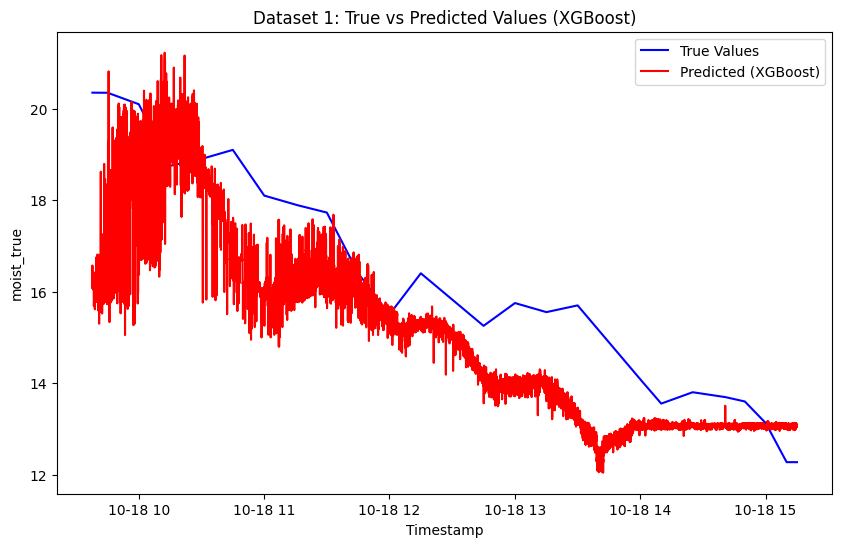

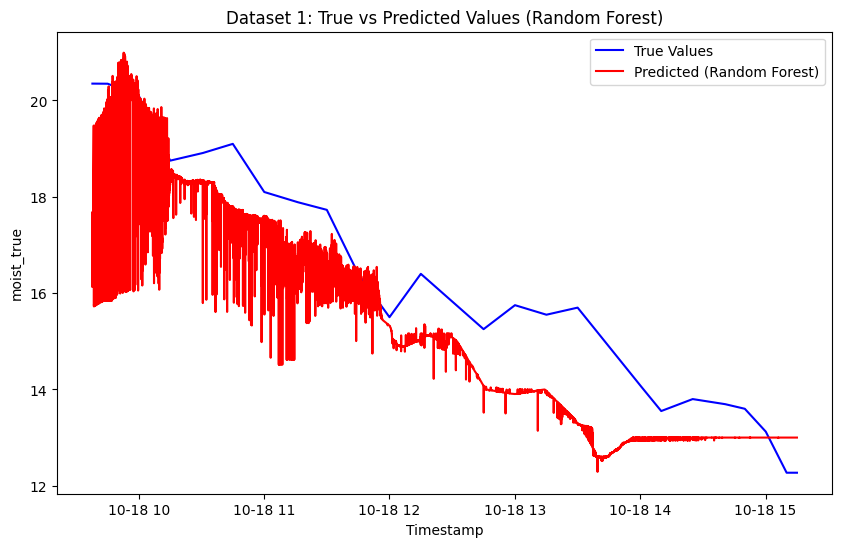

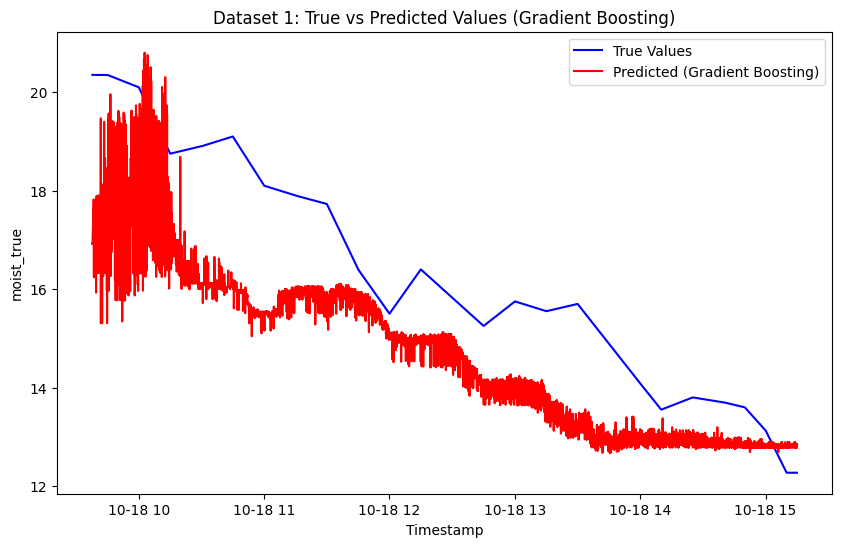

<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffi

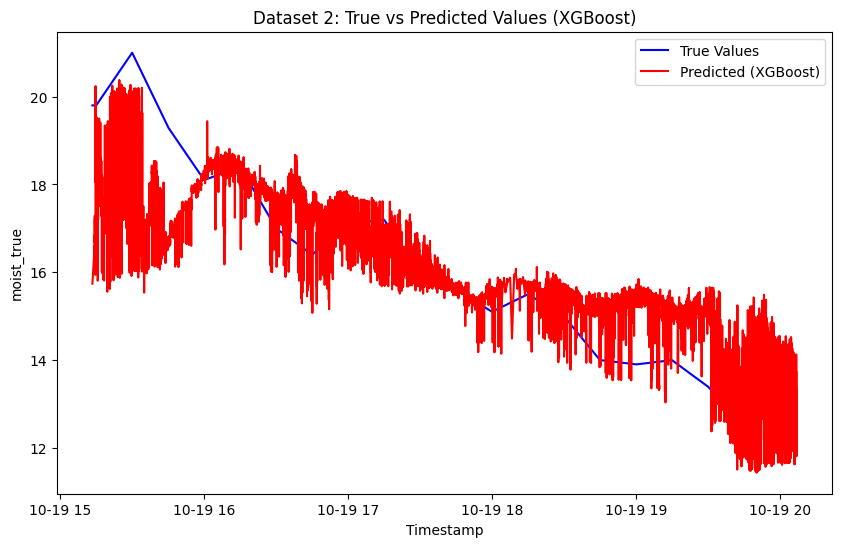

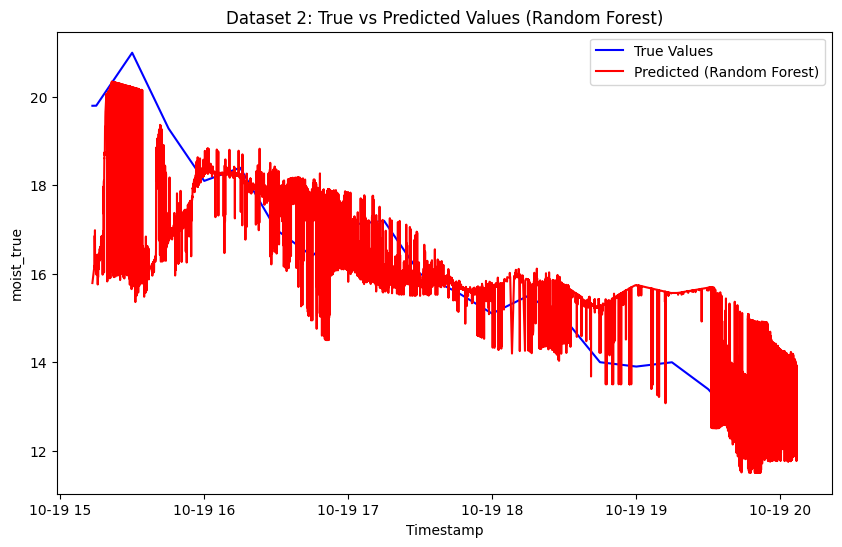

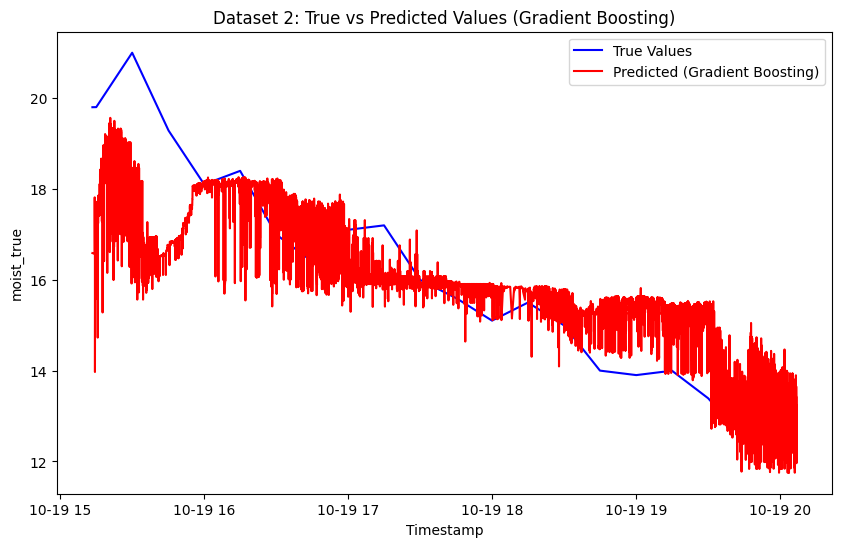

<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffi

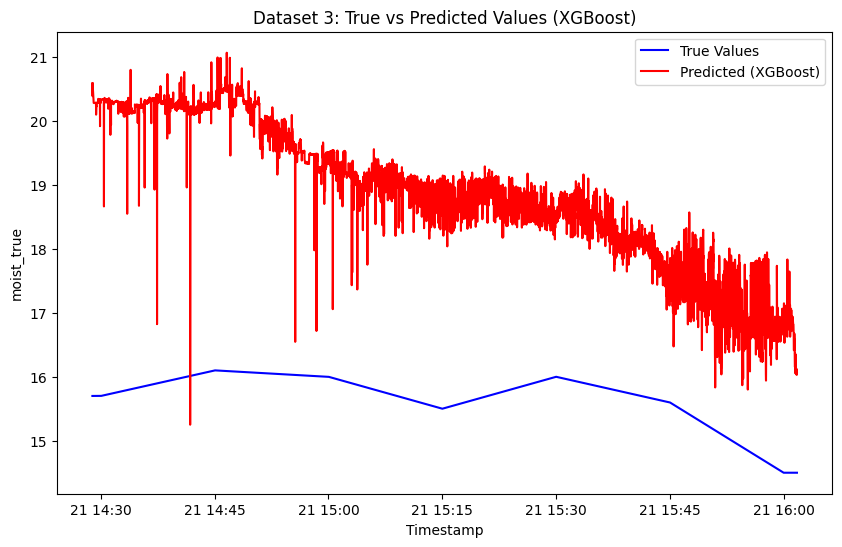

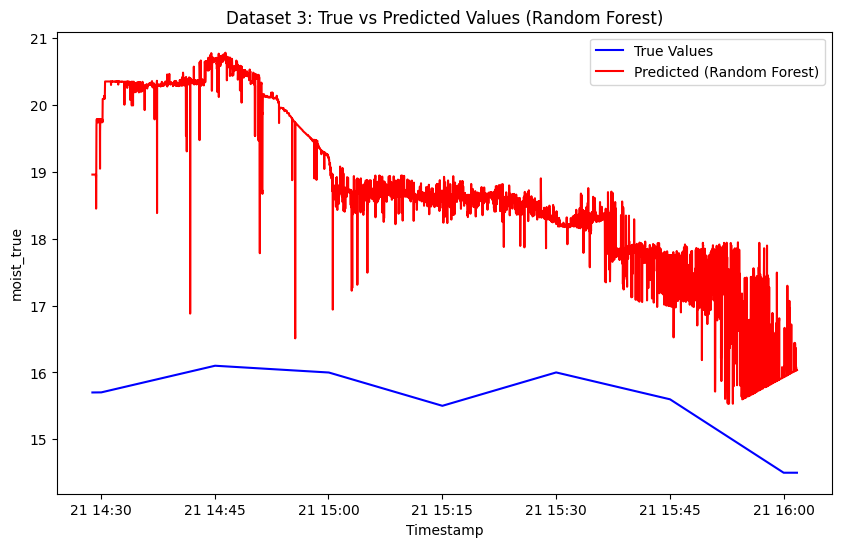

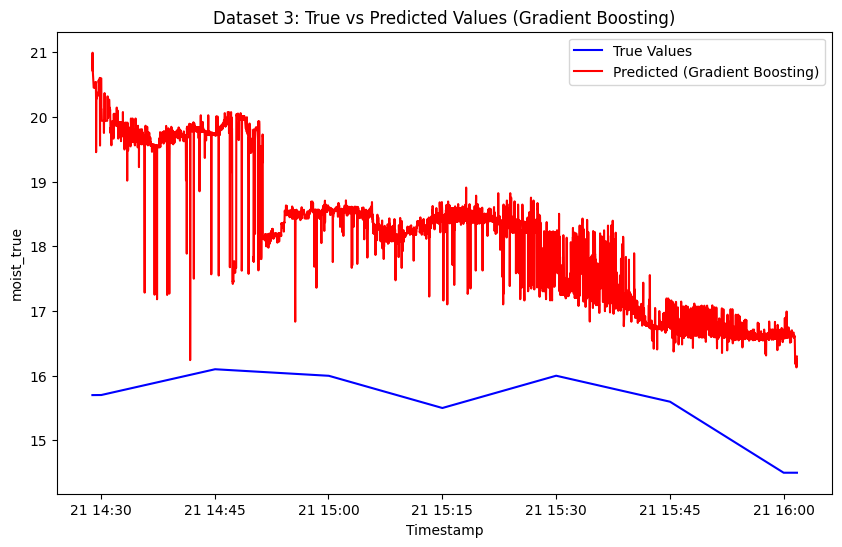

<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-8-9d9cae038d06>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffi

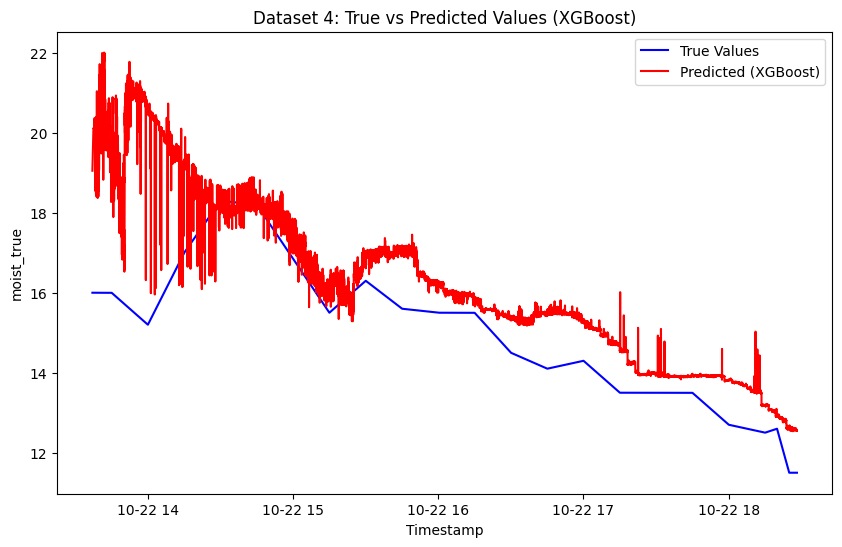

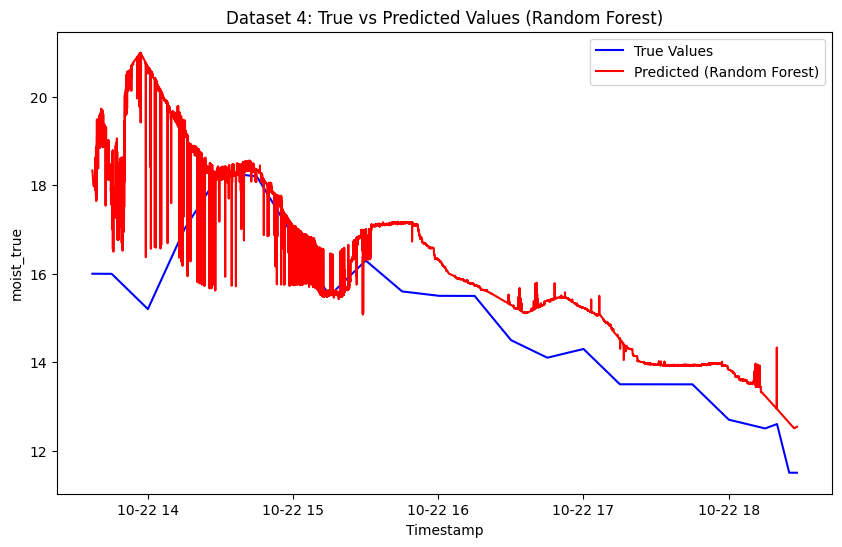

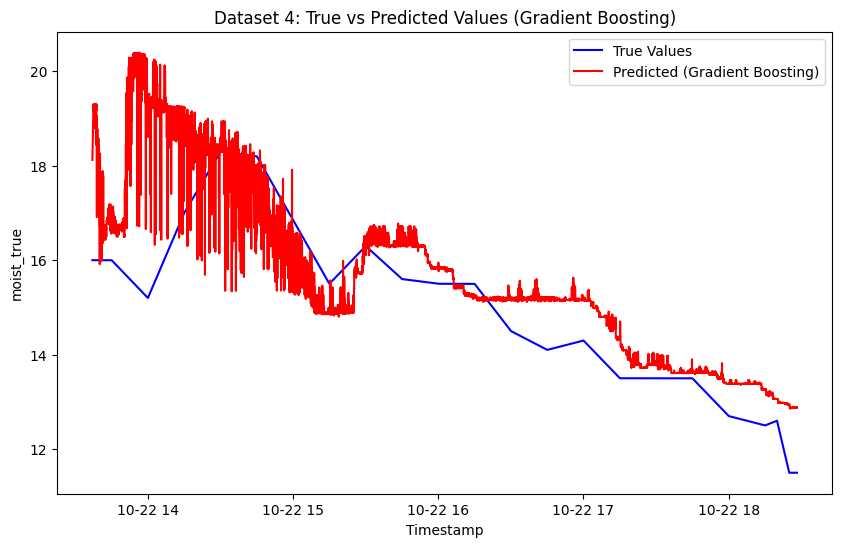

Dataset 1 Results:
  XGBoost: MSE = 2.4630369905766387
  Random Forest: MSE = 1.9943360861963584
  Gradient Boosting: MSE = 3.281491390511949
Dataset 2 Results:
  XGBoost: MSE = 1.392117474562042
  Random Forest: MSE = 2.049716530871172
  Gradient Boosting: MSE = 1.752329505631398
Dataset 3 Results:
  XGBoost: MSE = 10.699972362229406
  Random Forest: MSE = 10.037578377130506
  Gradient Boosting: MSE = 7.063330497293647
Dataset 4 Results:
  XGBoost: MSE = 2.9526157564780666
  Random Forest: MSE = 2.5722180712241878
  Gradient Boosting: MSE = 1.7262916978005651


In [ ]:
# File paths for all 4 datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = ['heat_transfer', 'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained','temp_heated','temp_out']
target_col = 'moist_true'

# Run cross-validation with multiple models
results = cross_validation_with_models(datasets, target_col, features)

# Print results
for fold, model_results in results:
    print(f"Dataset {fold+1} Results:")
    for model_name, mse in model_results.items():
        print(f"  {model_name}: MSE = {mse}")

<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method=

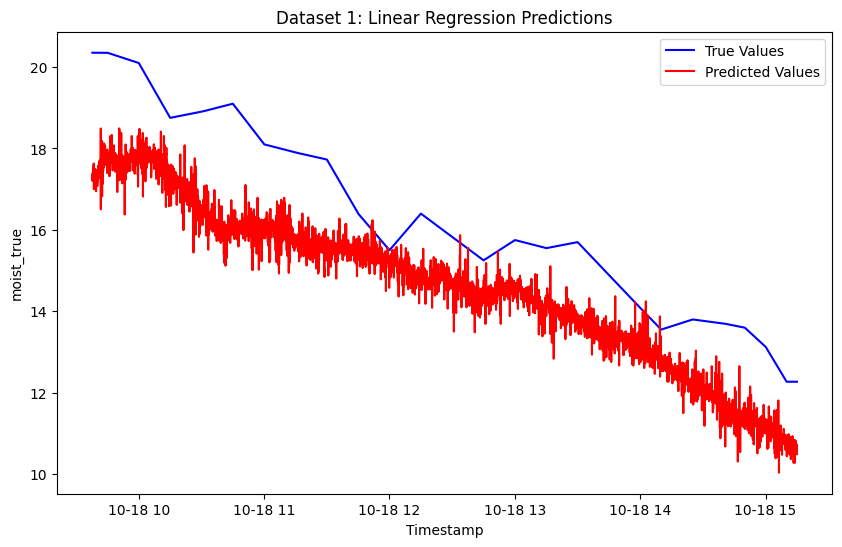

<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method=

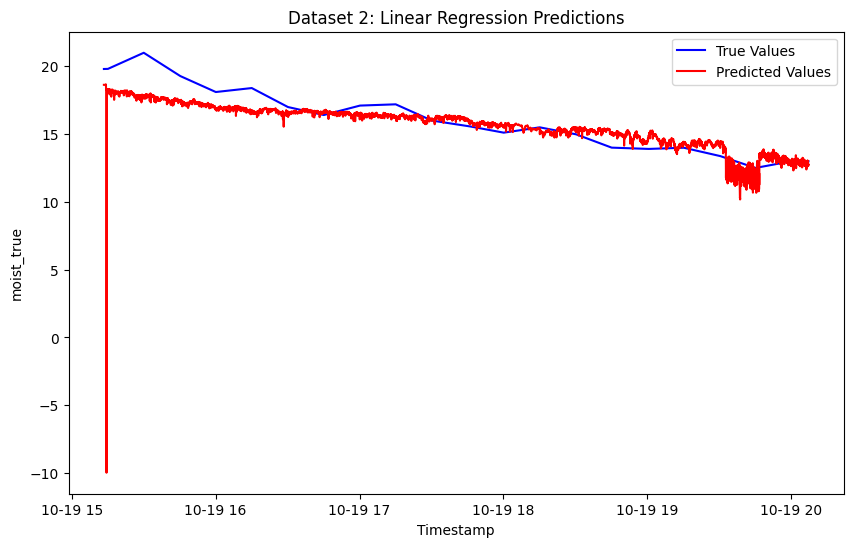

<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method=

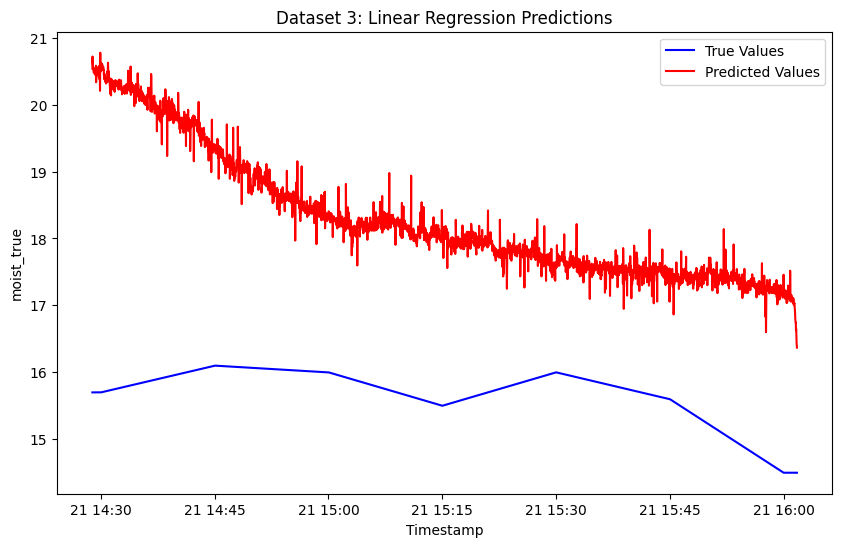

<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-21-f58ba0f6a737>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method=

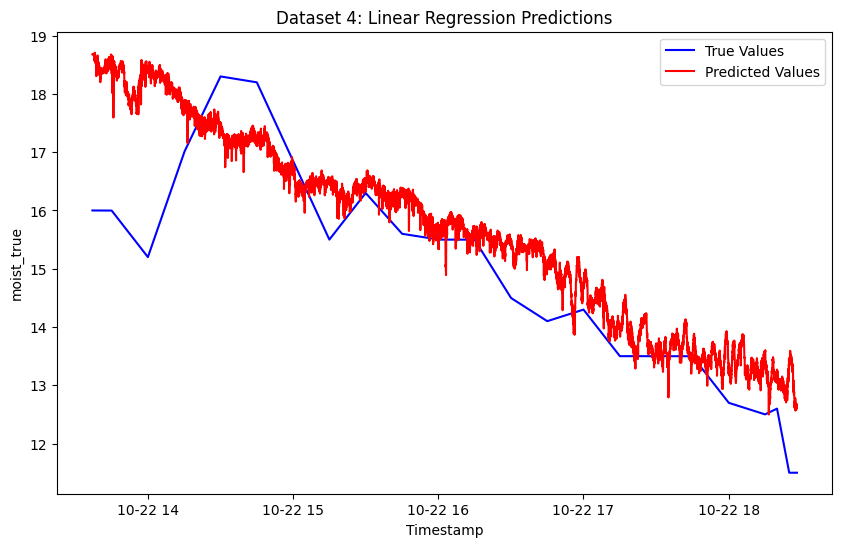

Dataset 1: MSE = 3.118490111616375
Dataset 2: MSE = 1.4358405043962048
Dataset 3: MSE = 7.322781569276119
Dataset 4: MSE = 1.1215104088886898


In [ ]:
# Updated Preprocessing Function with New Features
def preprocess_data_with_features(filepath):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'],format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New Features
    # Rolling averages
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()

    # Lagged features
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)

    # Interaction term
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # Crop the data (remove early phase)
    data = data[data["temp_heated"] > 65]
    return data

# Run Linear Model with Updated Features
def run_linear_model(datasets, target_col, features):
    results = []
    for i in range(len(datasets)):
        # Train-test split
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        val_file = datasets[i]

        # Preprocess
        train_data = pd.concat([preprocess_data_with_features(f) for f in train_files])
        val_data = preprocess_data_with_features(val_file)

        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Train a Linear Regression model
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Predictions and Evaluation
        predictions = model.predict(X_val)
        mse = mean_squared_error(y_val, predictions)
        results.append((i, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values", color='red')
        plt.title(f"Dataset {i+1}: Linear Regression Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

    return results

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Updated features
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Run the model
linear_model_results = run_linear_model(datasets, target_col, features)

# Print MSE results
for fold, mse in linear_model_results:
    print(f"Dataset {fold+1}: MSE = {mse}")

What did we change?

Added few more features to capture time and also smooth noise
Rolling averages: Smoothing noisy variables over a window of 5 timestamps to reduce fluctuations.
Lagged features:Capture the previous value of key variables to incorporate temporal dependencies
heat_time_interaction: Multiply heat_transfer by time_elapsed to model cumulative heat transfer effects

## **Random Forest and XGBoost: including feature importance**

<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

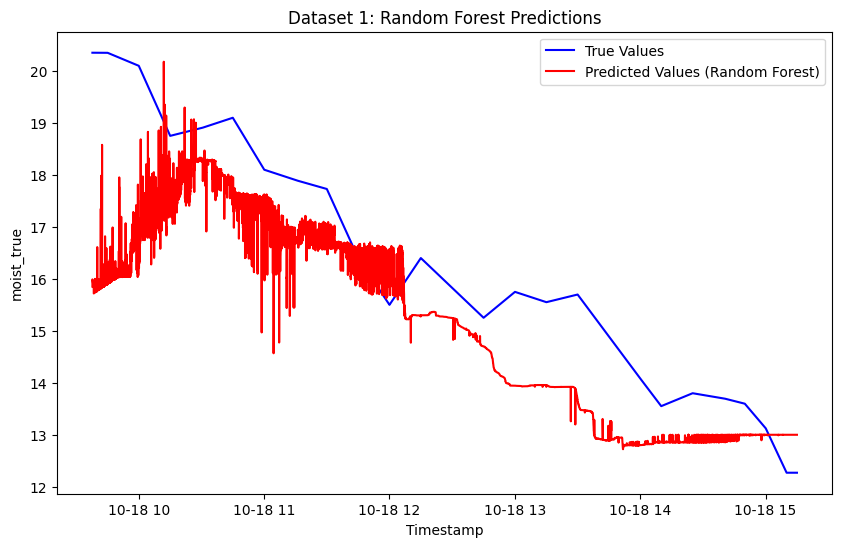

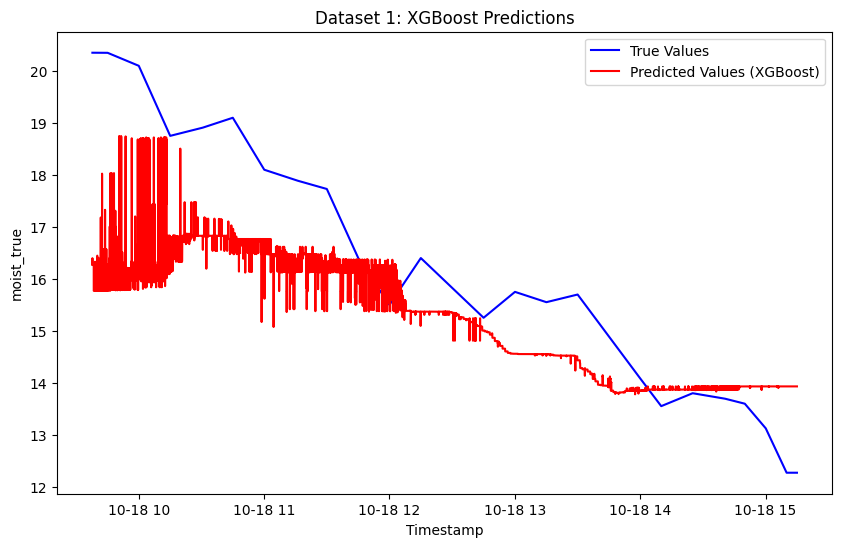

<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

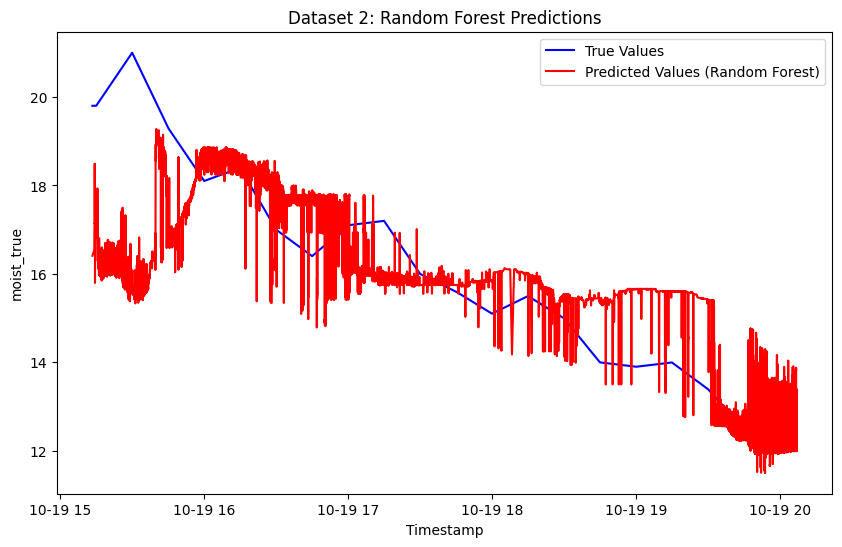

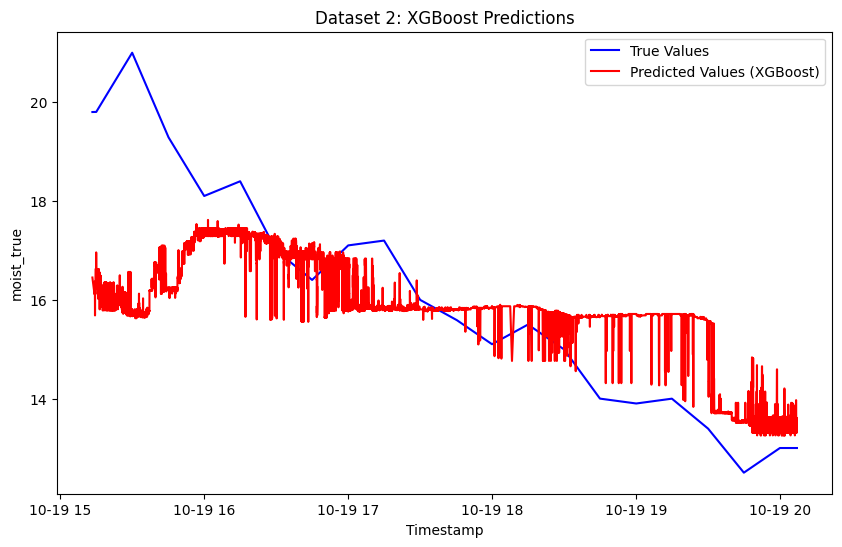

<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

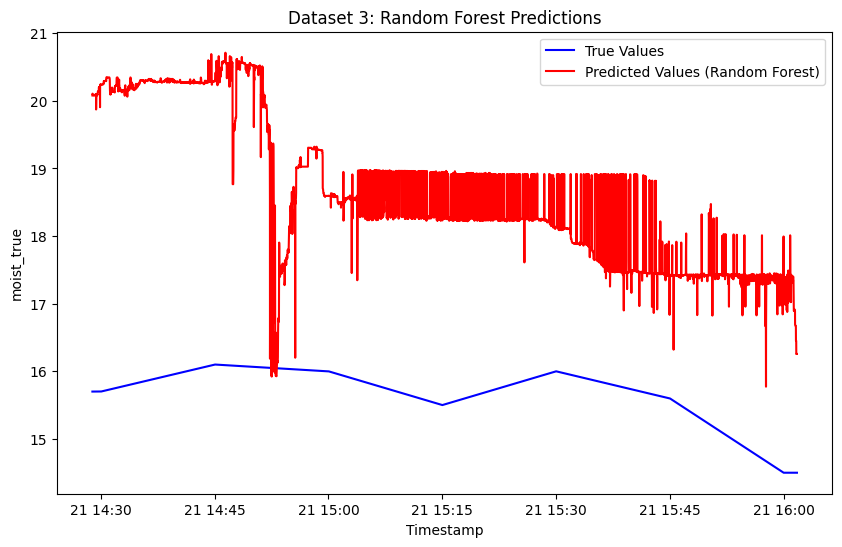

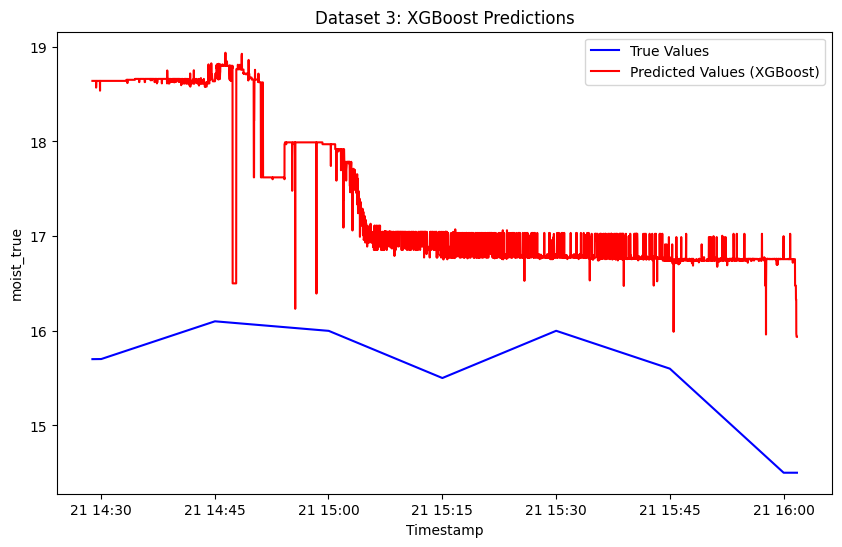

<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-40-53e8c3503679>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

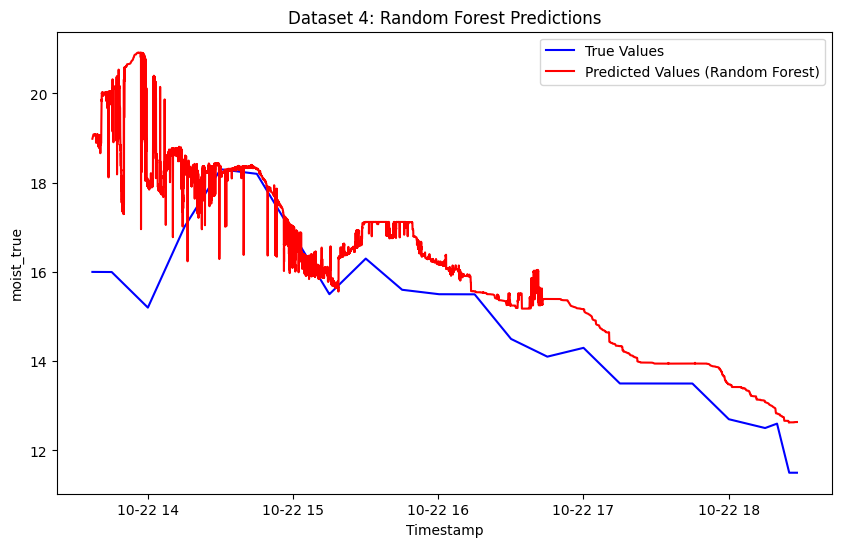

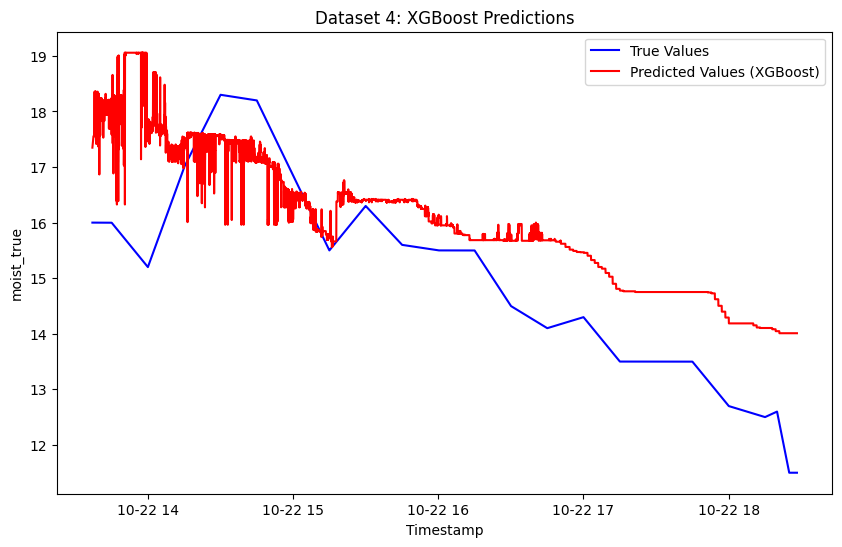

Dataset 1, Model: Random Forest, MSE = 2.408834953120257
Dataset 1, Model: XGBoost, MSE = 2.8619779848288798
Dataset 2, Model: Random Forest, MSE = 2.7711555403095414
Dataset 2, Model: XGBoost, MSE = 3.140120212912643
Dataset 3, Model: Random Forest, MSE = 9.622425228132217
Dataset 3, Model: XGBoost, MSE = 3.3639808997502874
Dataset 4, Model: Random Forest, MSE = 2.2024341213564456
Dataset 4, Model: XGBoost, MSE = 1.784989372505764


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
import pandas as pd

# Preprocessing Function with Features
def preprocess_data_with_features(filepath):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New Features
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # Crop the data (remove early phase)
    data = data[data["temp_heated"] > 65]
    return data

# Function to Run Random Forest and XGBoost with Feature Importance
def run_models_with_feature_importance(datasets, target_col, features):
    results = []
    models = {
        "Random Forest": RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42),
        "XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.01, max_depth=6, random_state=42)
    }

    for i in range(len(datasets)):
        # Train-test split
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        val_file = datasets[i]

        # Preprocess data
        train_data = pd.concat([preprocess_data_with_features(f) for f in train_files])
        val_data = preprocess_data_with_features(val_file)

        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        for model_name, model in models.items():
            # Train the model
            model.fit(X_train, y_train)

            # Predictions and Evaluation
            predictions = model.predict(X_val)
            mse = mean_squared_error(y_val, predictions)
            results.append((i, model_name, mse))

            # Plot predictions vs true values
            plt.figure(figsize=(10, 6))
            plt.plot(val_data.index, y_val, label="True Values", color='blue')
            plt.plot(val_data.index, predictions, label=f"Predicted Values ({model_name})", color='red')
            plt.title(f"Dataset {i+1}: {model_name} Predictions")
            plt.xlabel("Timestamp")
            plt.ylabel(target_col)
            plt.legend()
            plt.show()

            # # Feature Importance
            # importance = model.feature_importances_
            # plt.figure(figsize=(10, 6))
            # plt.barh(features, importance, color='green')
            # plt.title(f"Feature Importance ({model_name}) - Dataset {i+1}")
            # plt.xlabel("Importance")
            # plt.ylabel("Features")
            # plt.show()

    return results

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Updated features
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Run the models
results = run_models_with_feature_importance(datasets, target_col, features)

# Print MSE results
for fold, model_name, mse in results:
    print(f"Dataset {fold+1}, Model: {model_name}, MSE = {mse}")


<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

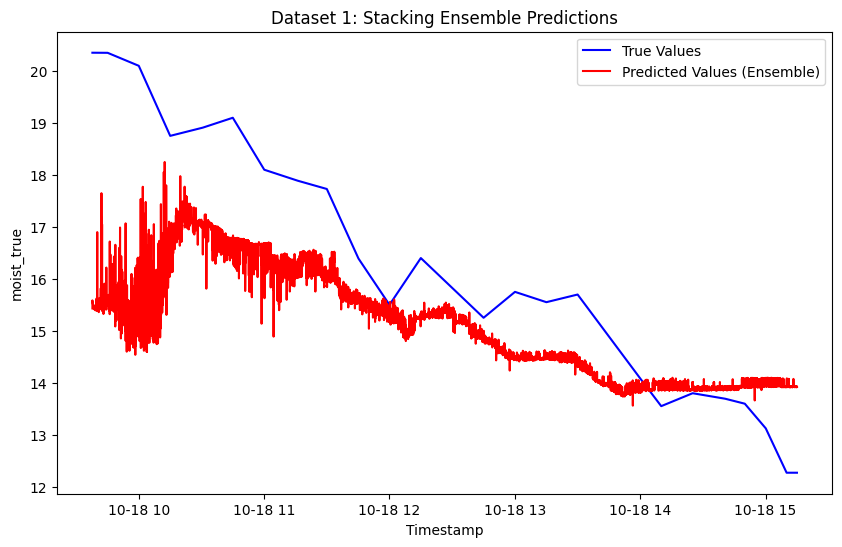

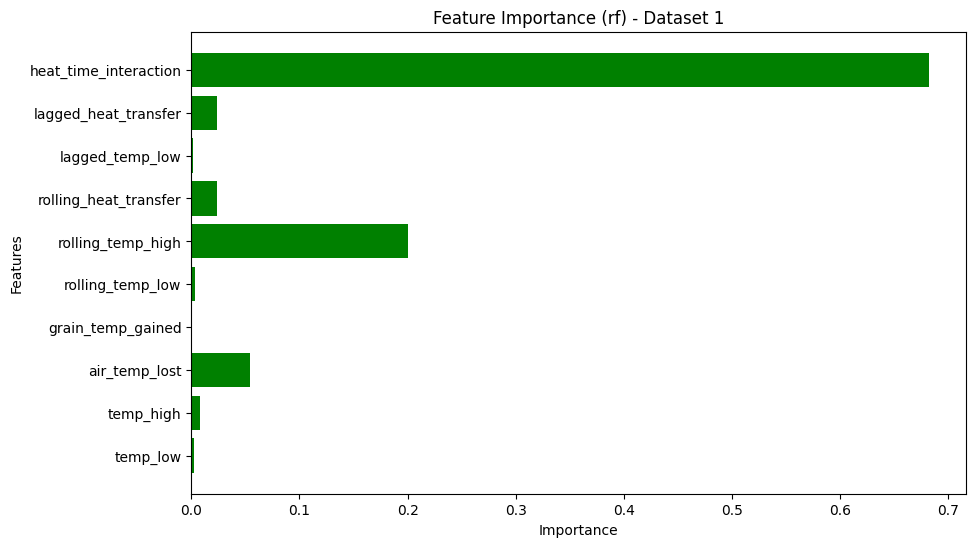

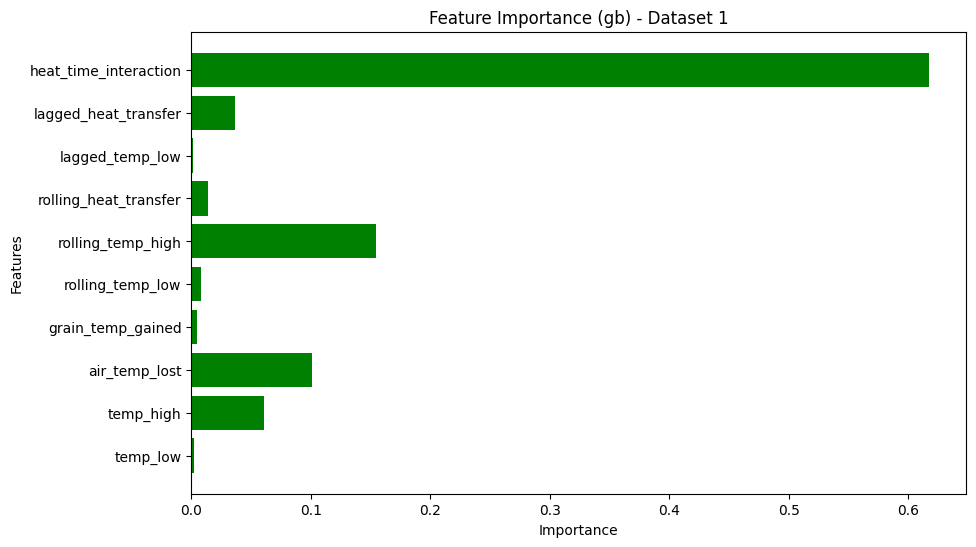

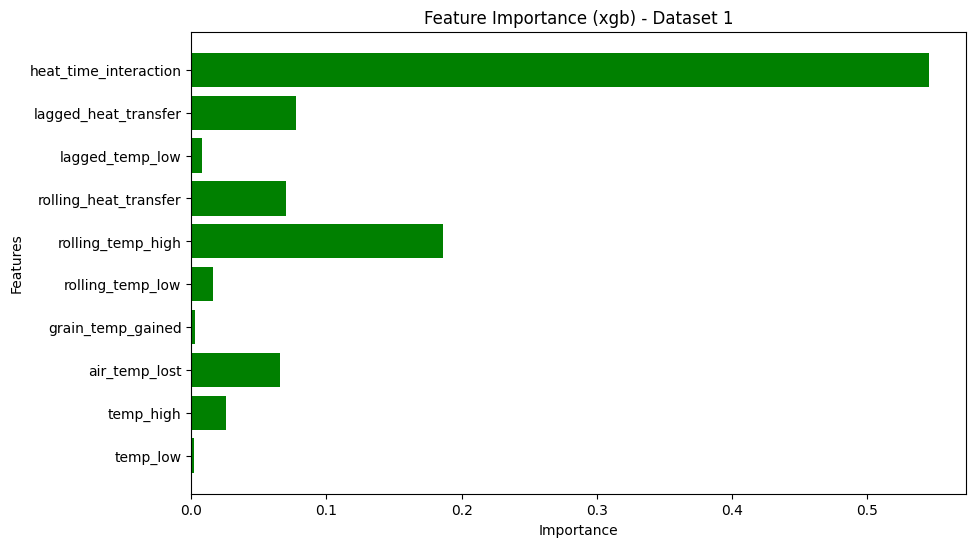

<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

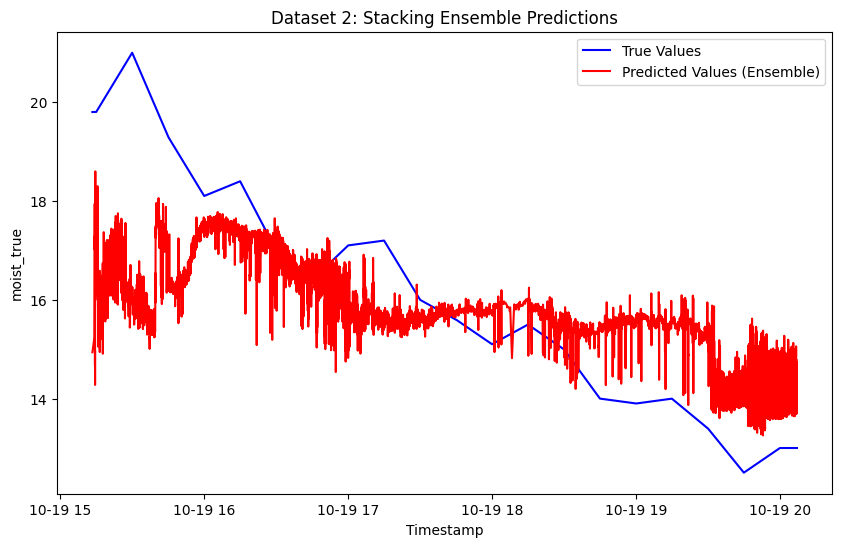

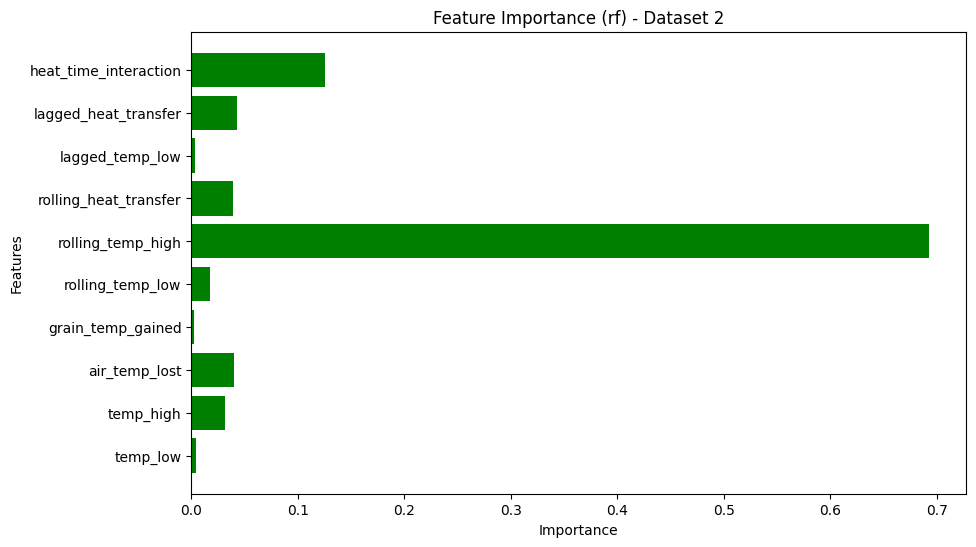

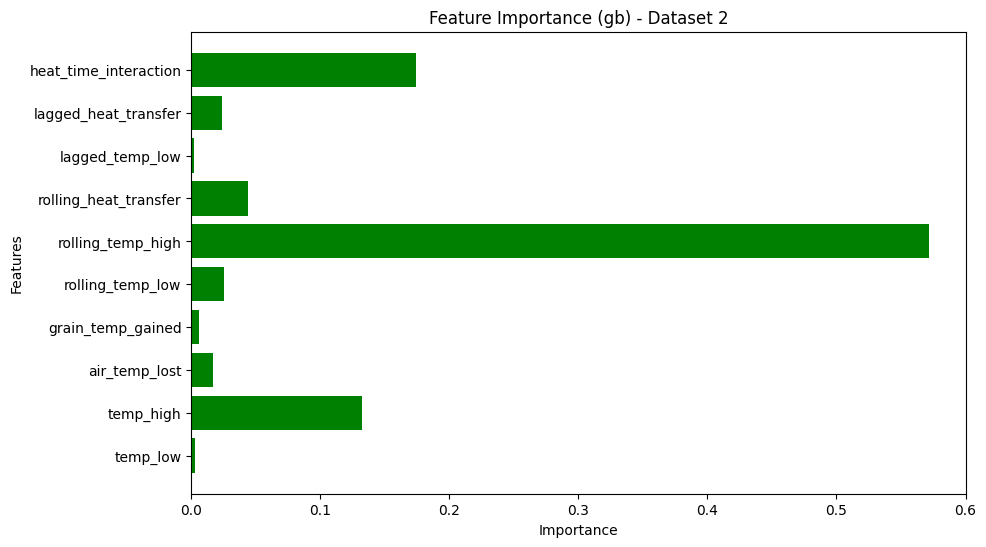

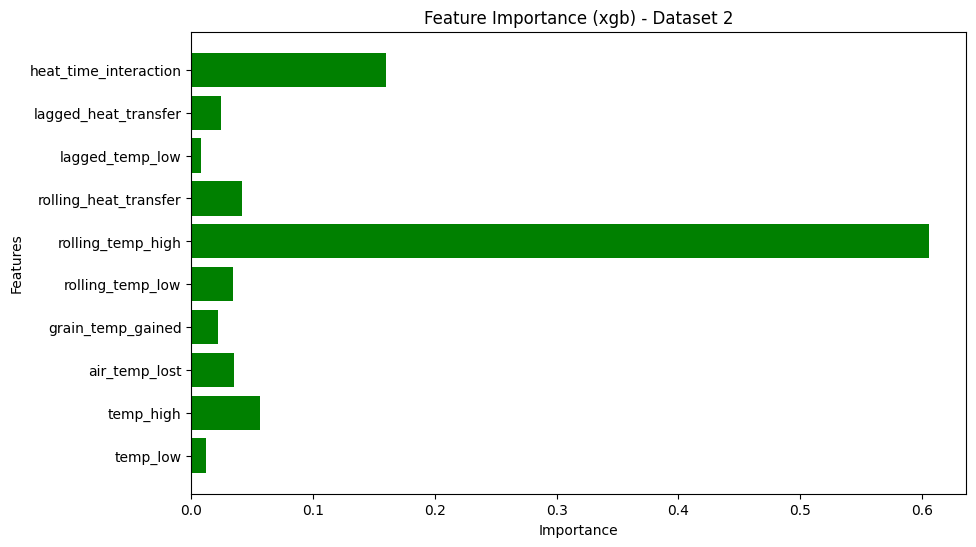

<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

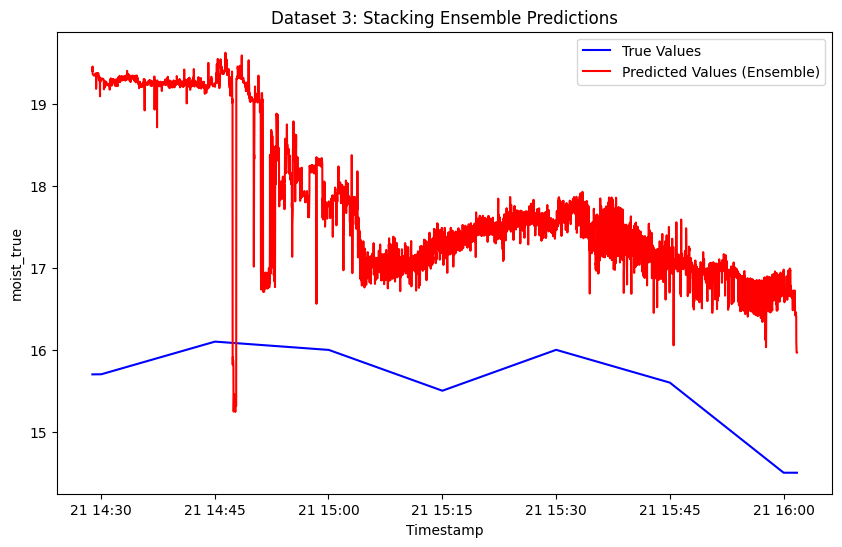

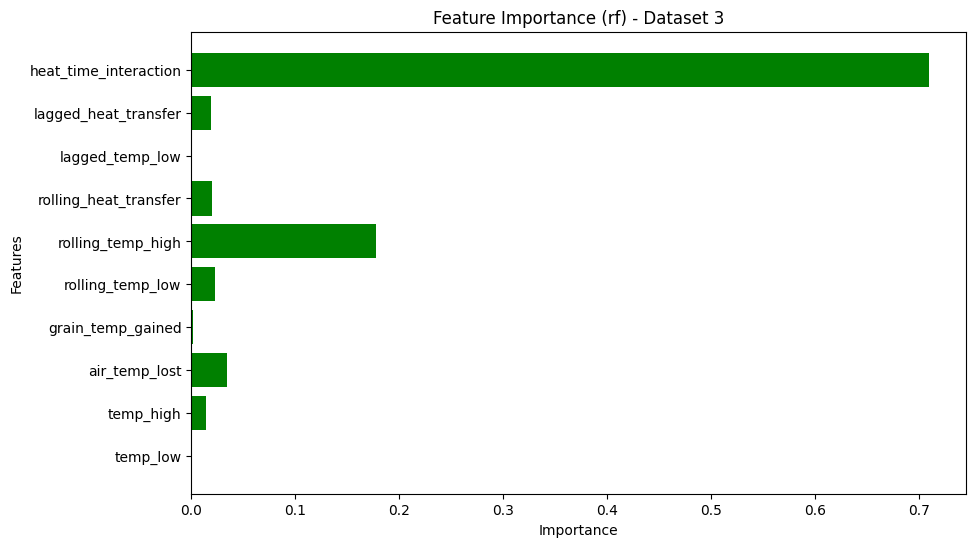

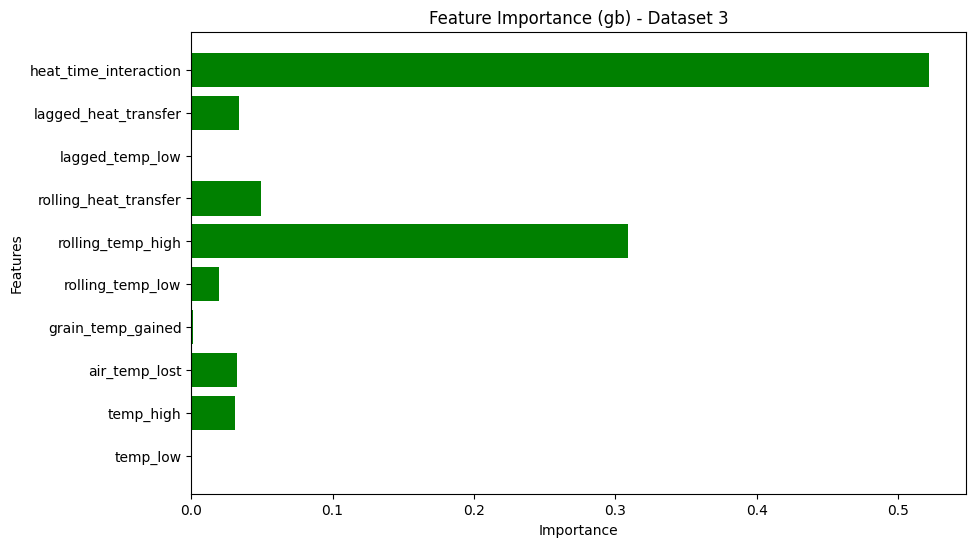

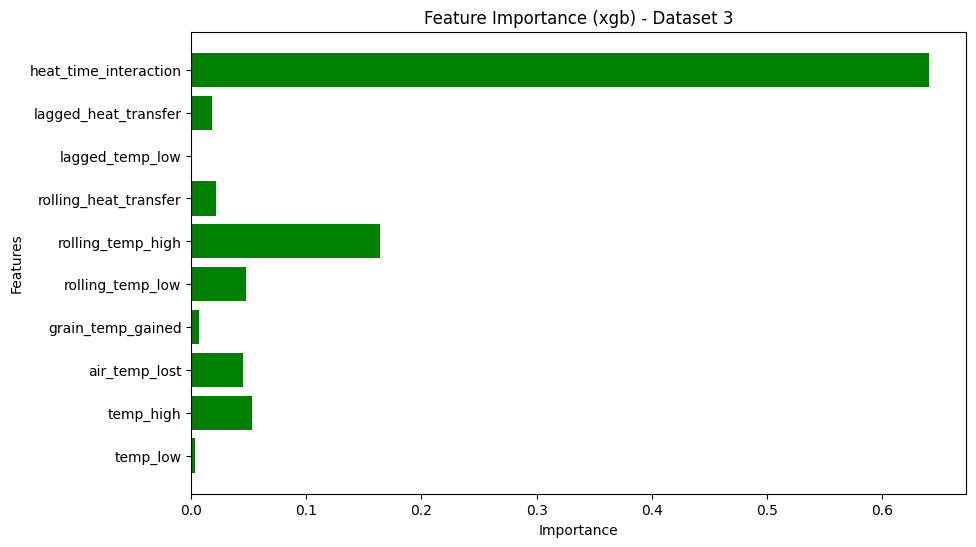

<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-37-8ac201504771>:15: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

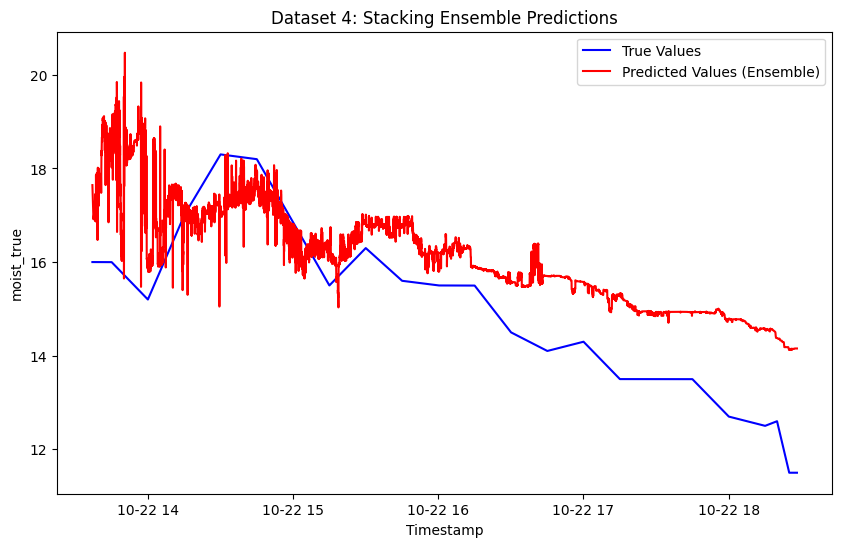

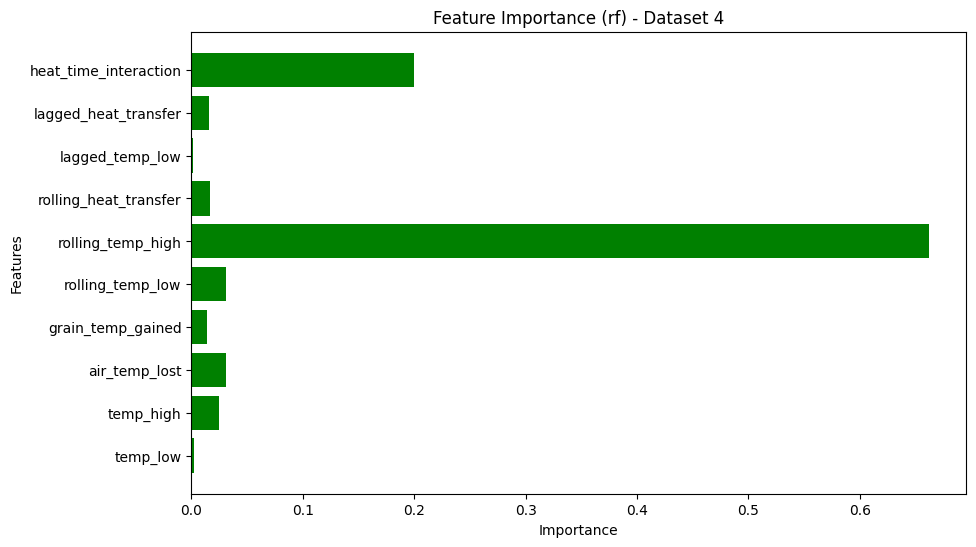

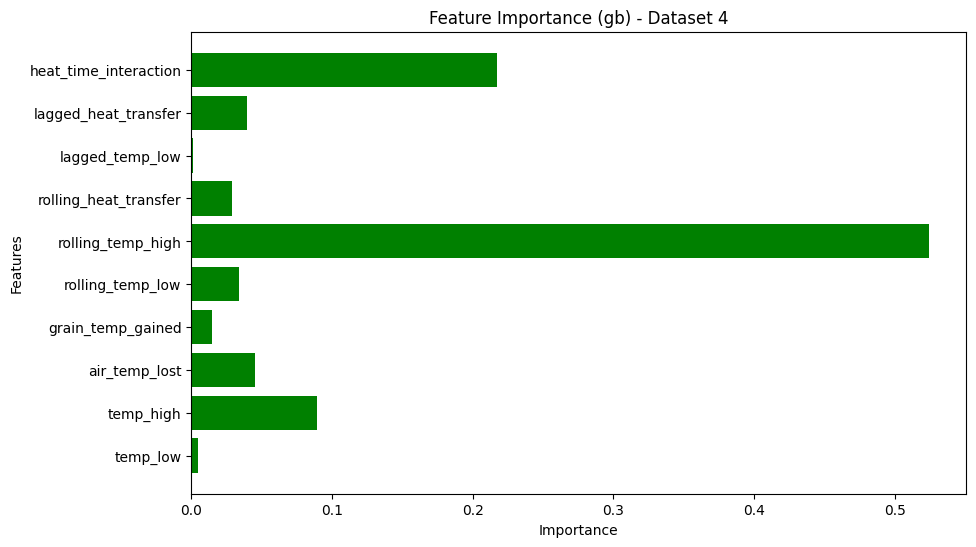

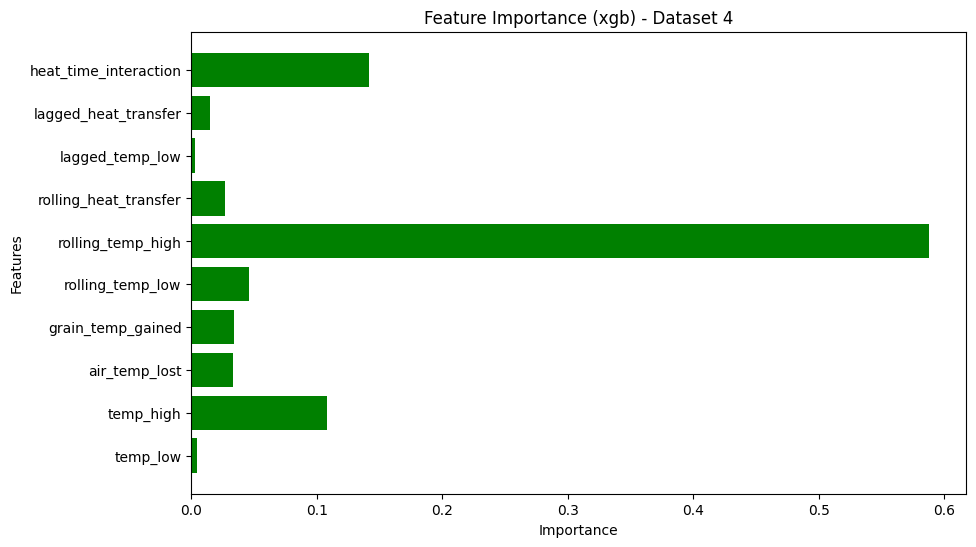

Dataset 1: MSE = 3.406914454555801
Dataset 2: MSE = 3.1095365670834756
Dataset 3: MSE = 4.836168659567057
Dataset 4: MSE = 1.9989110088497777


In [ ]:
from sklearn.ensemble import StackingRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd

# Preprocessing Function with Features (from earlier)
def preprocess_data_with_features(filepath):
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'],format='mixed')
    data.set_index('datetime', inplace=True)

    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New Features
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    data.dropna(inplace=True)
    data = data[data["temp_heated"] > 65]
    return data

# Function to Run Stacking Ensemble Model
def run_stacking_ensemble(datasets, target_col, features):
    results = []
    base_models = [
        ('rf', RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42)),
        ('gb', GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)),
        ('xgb', XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=6, random_state=42))
    ]
    meta_model = LinearRegression()

    # Create the stacking ensemble
    ensemble = StackingRegressor(estimators=base_models, final_estimator=meta_model, n_jobs=-1)

    for i in range(len(datasets)):
        # Train-test split
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        val_file = datasets[i]

        # Preprocess data
        train_data = pd.concat([preprocess_data_with_features(f) for f in train_files])
        val_data = preprocess_data_with_features(val_file)

        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Train the ensemble model
        ensemble.fit(X_train, y_train)

        # Predictions and Evaluation
        predictions = ensemble.predict(X_val)
        mse = mean_squared_error(y_val, predictions)
        results.append((i, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values (Ensemble)", color='red')
        plt.title(f"Dataset {i+1}: Stacking Ensemble Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

        # Feature Importance (Average Across Base Models)
        feature_importances = {
            name: model.feature_importances_ for name, model in ensemble.named_estimators_.items()
        }

        for model_name, importance in feature_importances.items():
            plt.figure(figsize=(10, 6))
            plt.barh(features, importance, color='green')
            plt.title(f"Feature Importance ({model_name}) - Dataset {i+1}")
            plt.xlabel("Importance")
            plt.ylabel("Features")
            plt.show()

    return results

# File paths for datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Run the stacking ensemble
stacking_results = run_stacking_ensemble(datasets, target_col, features)

# Print results
for fold, mse in stacking_results:
    print(f"Dataset {fold+1}: MSE = {mse}")


### **XGboost only.**

<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

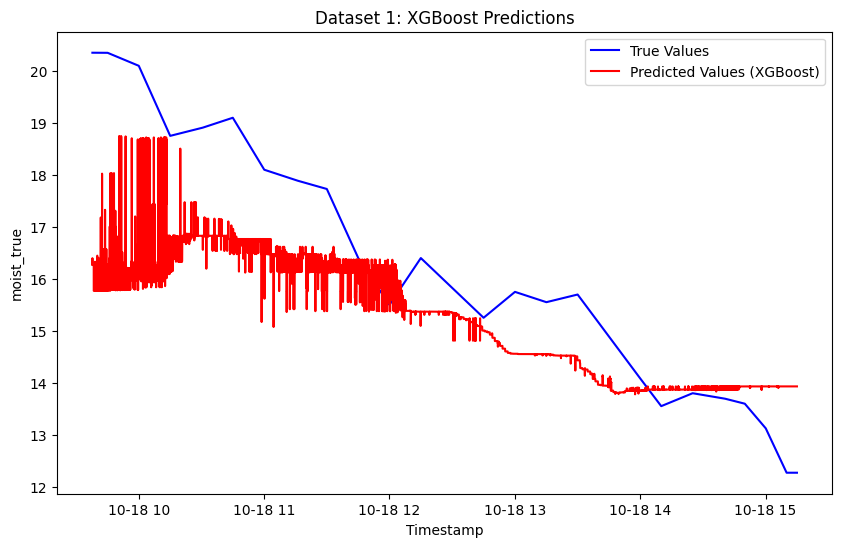

<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

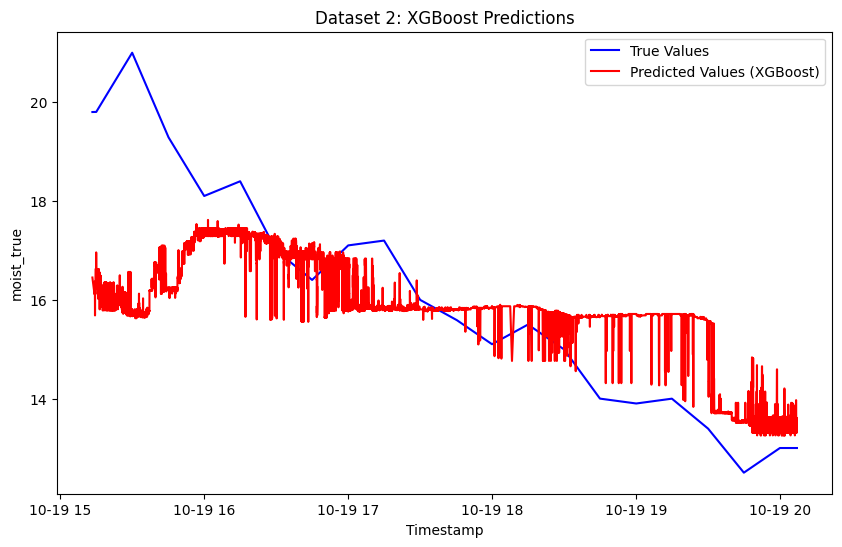

<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

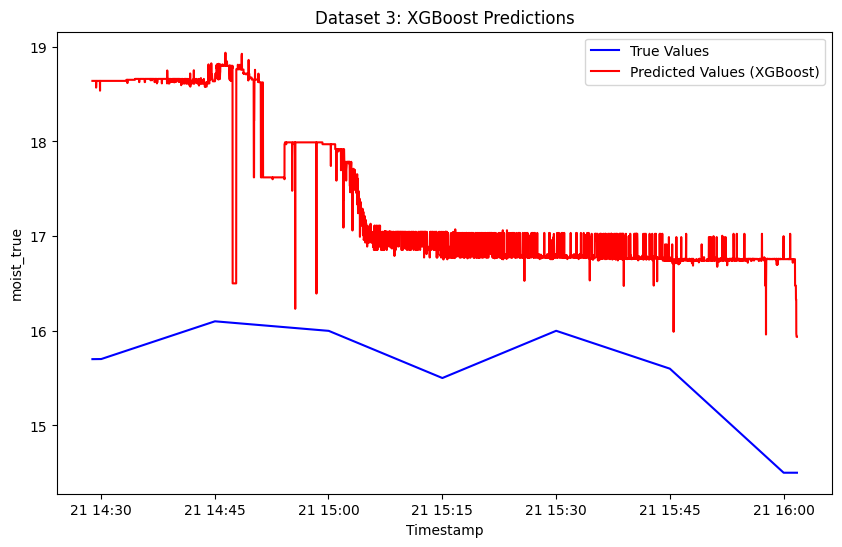

<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-38-b1b4f3128079>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

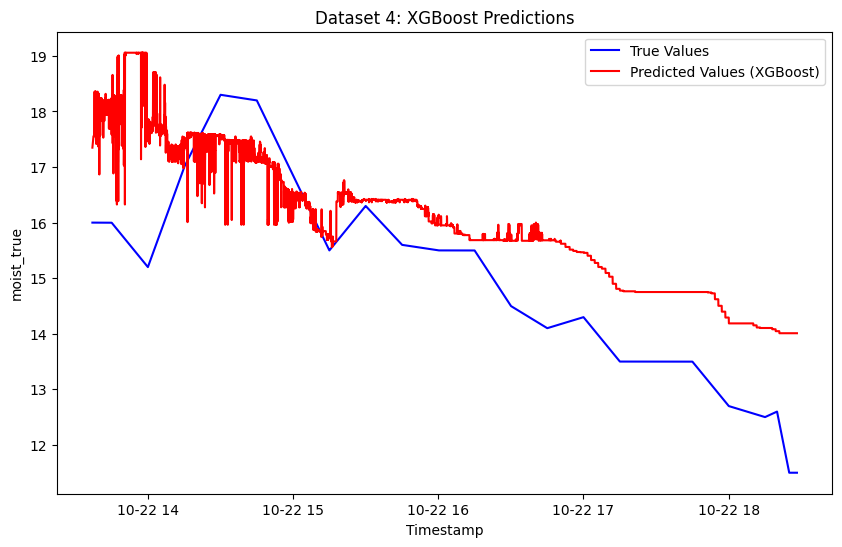

Dataset 1: MSE = 2.8619779848288798
Dataset 2: MSE = 3.140120212912643
Dataset 3: MSE = 3.3639808997502874
Dataset 4: MSE = 1.784989372505764


In [ ]:
import pandas as pd
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Preprocessing function
def preprocess_data_with_features(filepath, crop_dataset_3=False):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New features
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # Special condition for Dataset 3: Crop until 15:00
    # if crop_dataset_3:
    #     data = data[data.index < '2024-10-21 15:00:00']

    # Crop the data (remove early phase for all datasets)
    data = data[data["temp_heated"] > 65]

    return data

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Train and evaluate XGBoost model
def run_xgboost(datasets, target_col, features):
    results = []

    for i, filepath in enumerate(datasets):
        # Preprocess all datasets, apply cropping only for Dataset 3
        if i == 2:  # Dataset 3
            data = preprocess_data_with_features(filepath, crop_dataset_3=True)
        else:
            data = preprocess_data_with_features(filepath)

        # Train-test split (leave one dataset for validation)
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        train_data = pd.concat([
            preprocess_data_with_features(f, crop_dataset_3=(j == 2)) for j, f in enumerate(train_files)
        ])
        val_data = data

        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Train XGBoost model
        model = XGBRegressor(n_estimators=100, learning_rate=0.01, max_depth=6, random_state=42)
        model.fit(X_train, y_train)

        # Predict and calculate MSE
        predictions = model.predict(X_val)
        mse = mean_squared_error(y_val, predictions)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values (XGBoost)", color='red')
        plt.title(f"Dataset {i + 1}: XGBoost Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

    return results

# Run the model and display results
xgboost_results = run_xgboost(datasets, target_col, features)
for dataset_id, mse in xgboost_results:
    print(f"Dataset {dataset_id}: MSE = {mse}")


<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

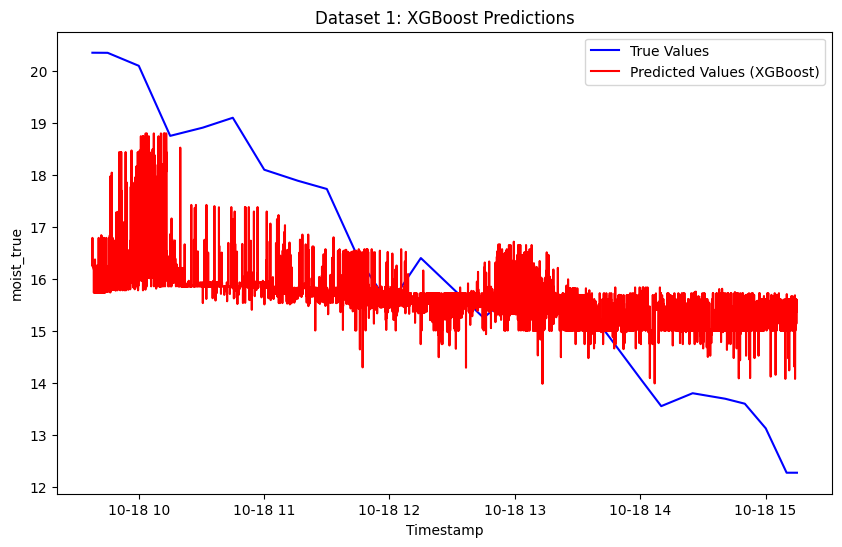

<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

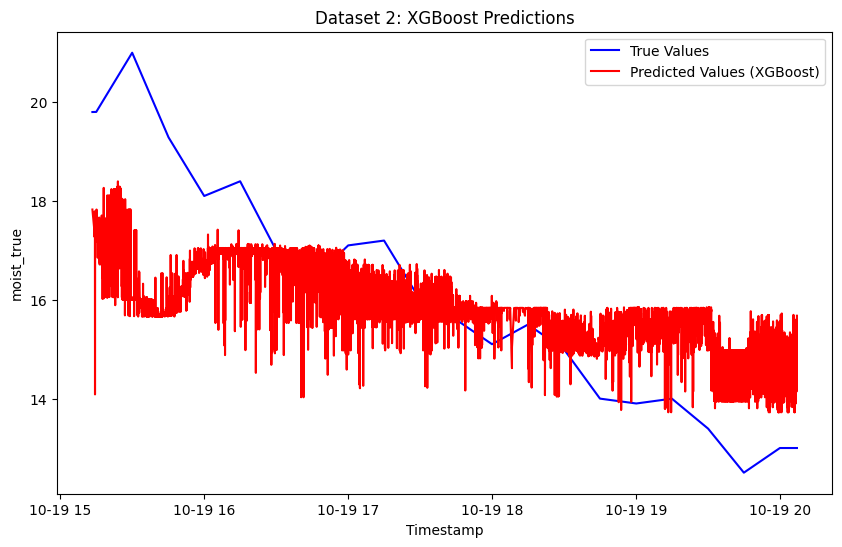

<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

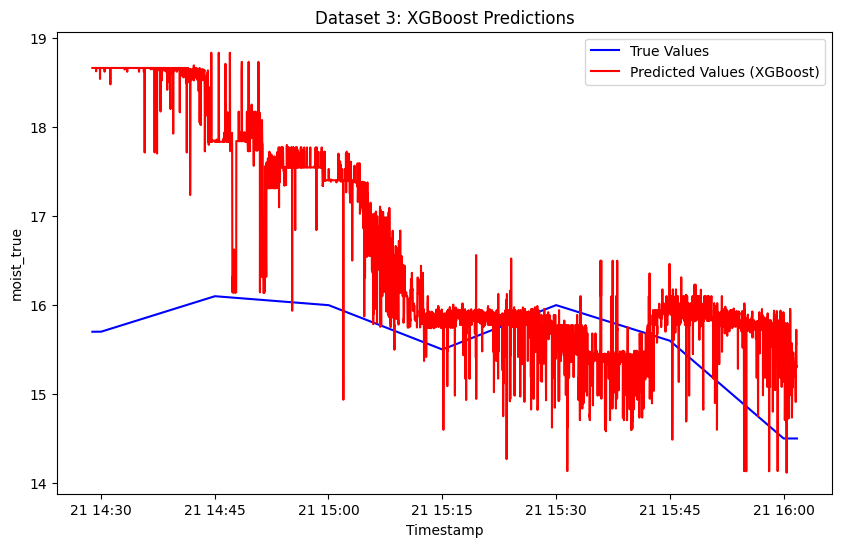

<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-55-bd67b3059d93>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

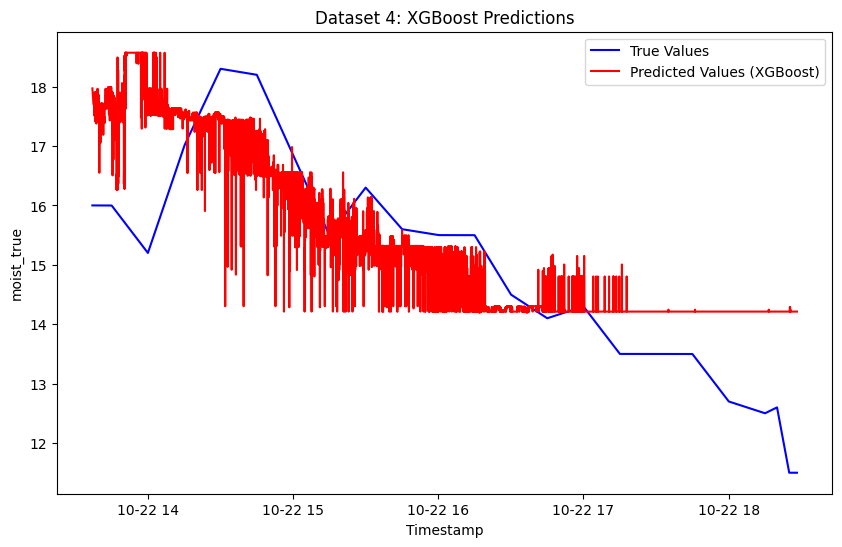

Dataset 1: MSE = 3.9545612219791857
Dataset 2: MSE = 3.264406414211021
Dataset 3: MSE = 1.9946972937764622
Dataset 4: MSE = 1.305860035717257


In [ ]:
import pandas as pd
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Preprocessing function
def preprocess_data_with_features(filepath, crop_dataset_3=False):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New features
    # # data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    # data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    # data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    # # data['lagged_temp_low'] = data['temp_low'].shift(1)
    # data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    # data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # Special condition for Dataset 3: Crop until 15:00
    # if crop_dataset_3:
    #     data = data[data.index < '2024-10-21 15:00:00']

    # Crop the data (remove early phase for all datasets)
    data = data[data["temp_heated"] > 65]

    return data

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained']
target_col = 'moist_true'

# Train and evaluate XGBoost model
def run_xgboost(datasets, target_col, features):
    results = []

    for i, filepath in enumerate(datasets):
        # Preprocess all datasets, apply cropping only for Dataset 3
        # if i == 2:  # Dataset 3
        #     data = preprocess_data_with_features(filepath, crop_dataset_3=True)
        # else:
        data = preprocess_data_with_features(filepath)

        # Train-test split (leave one dataset for validation)
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        train_data = pd.concat([
            preprocess_data_with_features(f, crop_dataset_3=(j == 2)) for j, f in enumerate(train_files)
        ])
        val_data = data

        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Train XGBoost model
        model = XGBRegressor(n_estimators=100, learning_rate=0.01, max_depth=6, random_state=42)
        model.fit(X_train, y_train)

        # Predict and calculate MSE
        predictions = model.predict(X_val)
        mse = mean_squared_error(y_val, predictions)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values (XGBoost)", color='red')
        plt.title(f"Dataset {i + 1}: XGBoost Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

    return results

# Run the model and display results
xgboost_results = run_xgboost(datasets, target_col, features)
for dataset_id, mse in xgboost_results:
    print(f"Dataset {dataset_id}: MSE = {mse}")

# **Neural Network**

<ipython-input-39-2b478ad82582>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


149/149 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Dataset 1: MSE = 0.1553757245094306, R² Score = 0.34273638237917414


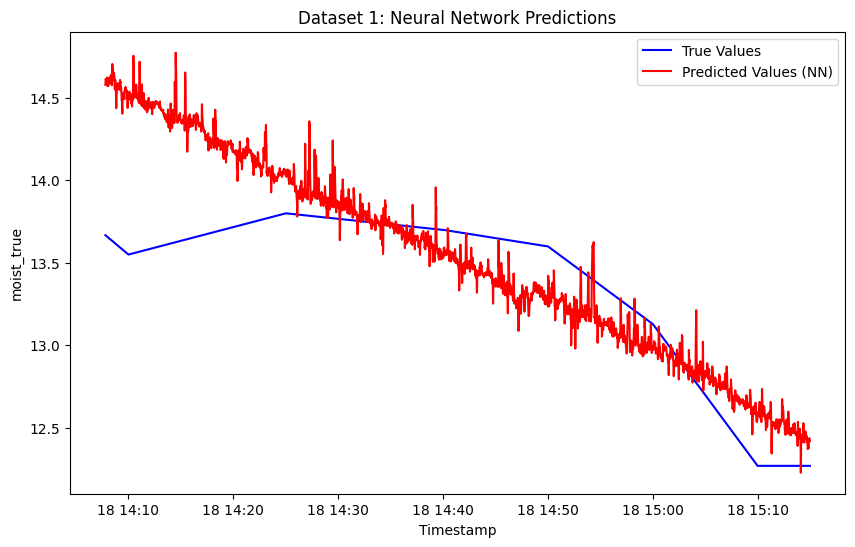

<ipython-input-39-2b478ad82582>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Dataset 2: MSE = 0.1429713465147498, R² Score = 0.34422958308598206


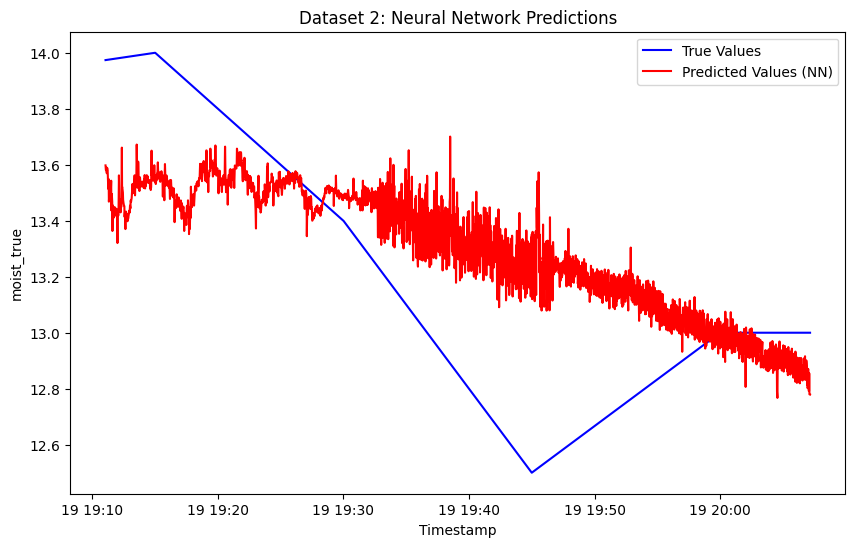

<ipython-input-39-2b478ad82582>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Dataset 3: MSE = 1.5874228180659928, R² Score = -10.206680313648945


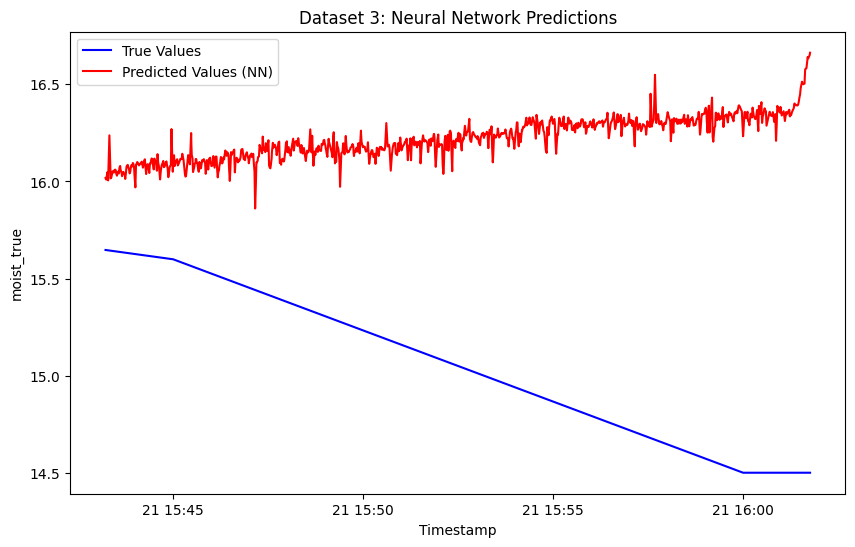

<ipython-input-39-2b478ad82582>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


128/128 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Dataset 4: MSE = 1.5448559757022253, R² Score = -3.7144970349538733


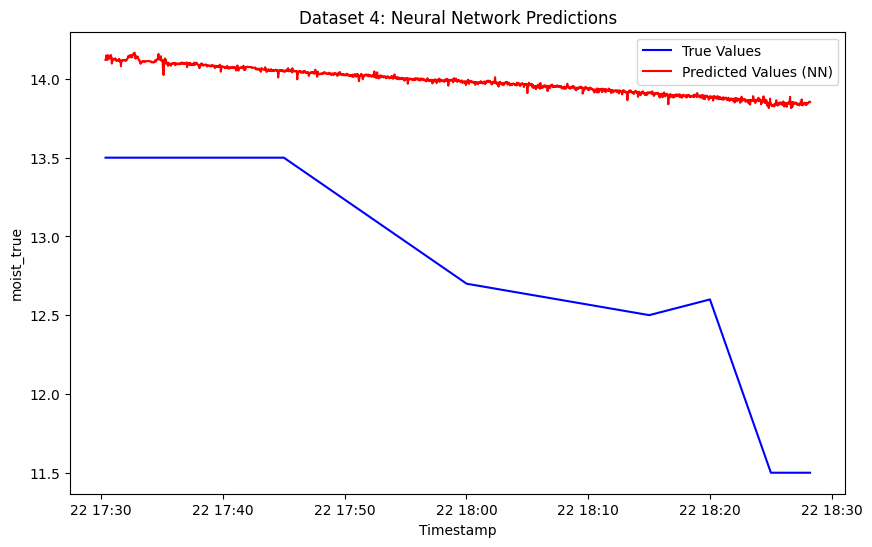

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.metrics import mean_squared_error, r2_score

# Preprocessing function (same as before)
def preprocess_data_with_features(filepath, crop_dataset_3=False):
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New features
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # # Crop for Dataset 3
    # if crop_dataset_3:
    #     data = data[data.index < '2024-10-21 15:00:00']

    # Crop the data (remove early phase)
    data = data[data["temp_heated"] > 65]
    return data

# Train-test split: Use the last 20% of the data as test data
def train_test_split_time_series(data, test_size=0.2):
    split_idx = int(len(data) * (1 - test_size))
    train = data.iloc[:split_idx]
    test = data.iloc[split_idx:]
    return train, test

# Build and train Neural Network
def neural_network_model(datasets, target_col, features):
    for i, filepath in enumerate(datasets):
        # Preprocess the dataset
        crop_dataset_3 = True if i == 2 else False
        data = preprocess_data_with_features(filepath, crop_dataset_3=crop_dataset_3)

        # Train-test split (last 20% of time as test)
        train_data, test_data = train_test_split_time_series(data)
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Scale the data
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

        # Define Neural Network
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dropout(0.2),
            Dense(32, activation='relu'),
            Dense(1)  # Single output for regression
        ])

        model.compile(optimizer='adam', loss='mse')

        # Train the model
        history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)

        # Predict on test data
        predictions = model.predict(X_test)
        mse = mean_squared_error(y_test, predictions)
        r2 = r2_score(y_test, predictions)

        # Print Results
        print(f"Dataset {i+1}: MSE = {mse}, R² Score = {r2}")

        # Plot True vs Predicted
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, predictions, label="Predicted Values (NN)", color='red')
        plt.title(f"Dataset {i+1}: Neural Network Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

# File paths and features
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Run the Neural Network model
neural_network_model(datasets, target_col, features)


Here i will delete the new features i have created and run NN model without them.
Update: It has much more poor performance. Seems that the features we have created are usefull.

<ipython-input-40-fa372ae51824>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


149/149 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Dataset 1: MSE = 5.18071361955457, R² Score = -20.915228947101358


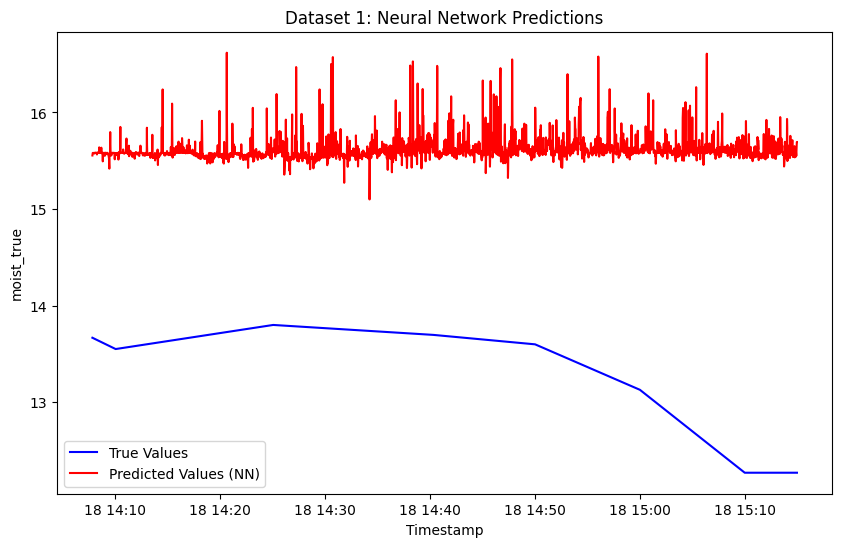

<ipython-input-40-fa372ae51824>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Dataset 2: MSE = 7.683941455651817, R² Score = -34.24413537922337


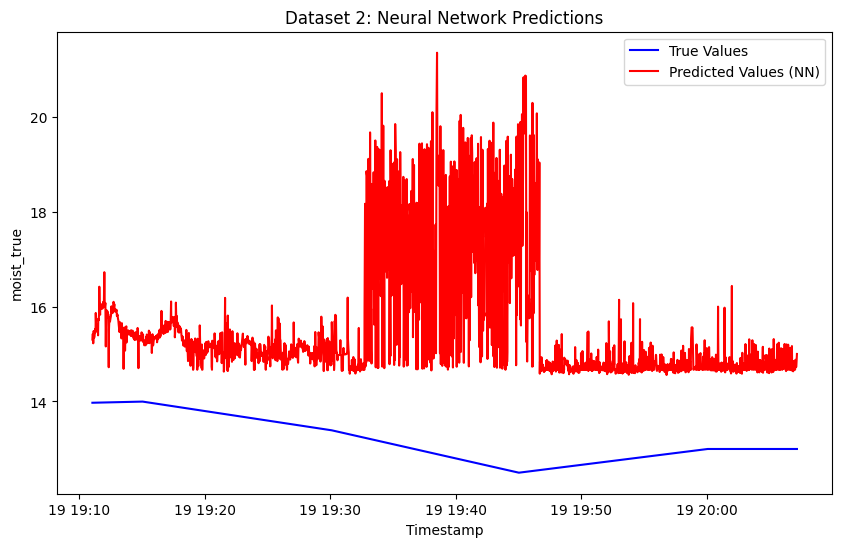

<ipython-input-40-fa372ae51824>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Dataset 3: MSE = 0.8282673856721694, R² Score = -4.8472939281284155


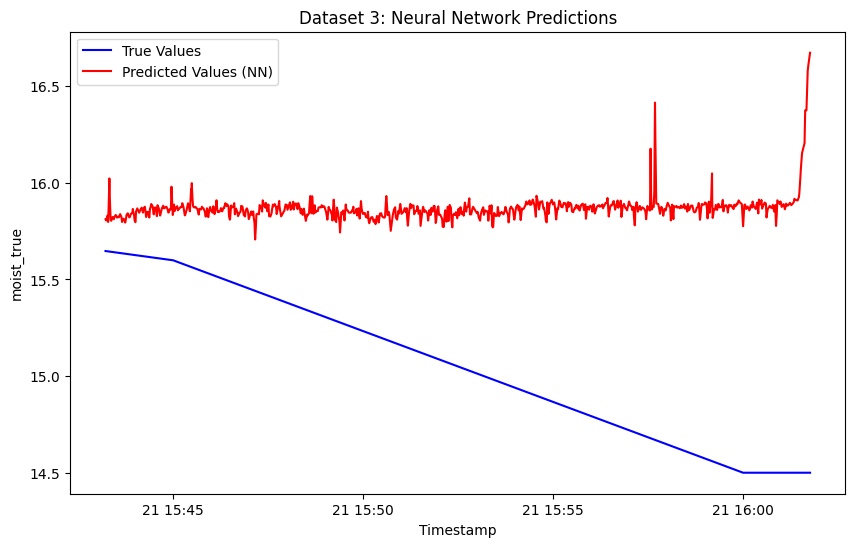

<ipython-input-40-fa372ae51824>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


128/128 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Dataset 4: MSE = 1.8810218580634863, R² Score = -4.740387526088111


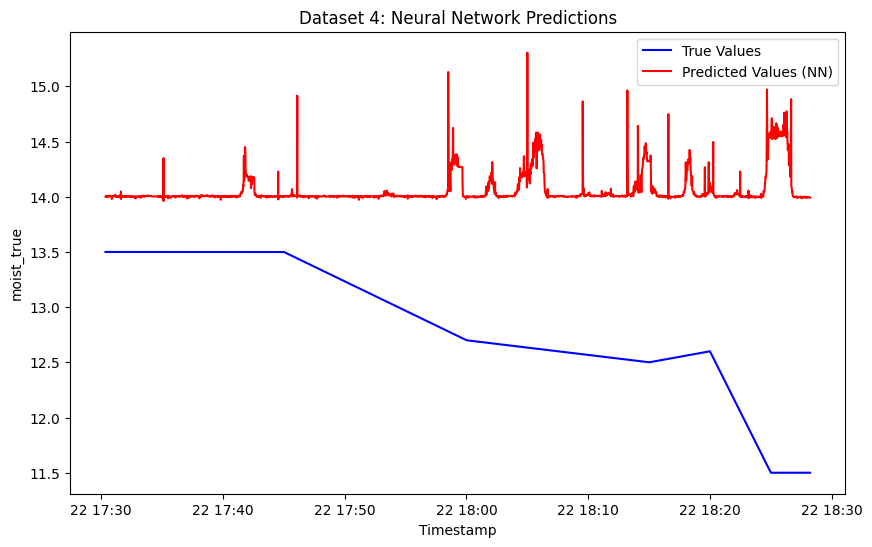

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.metrics import mean_squared_error, r2_score

# Preprocessing function (same as before)
def preprocess_data_with_features(filepath, crop_dataset_3=False):
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New features
    # data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    # data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    # data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    # data['lagged_temp_low'] = data['temp_low'].shift(1)
    # data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    # data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values caused by rolling or lagging
    data.dropna(inplace=True)

    # # Crop for Dataset 3
    # if crop_dataset_3:
    #     data = data[data.index < '2024-10-21 15:00:00']

    # Crop the data (remove early phase)
    data = data[data["temp_heated"] > 65]
    return data

# Train-test split: Use the last 20% of the data as test data
def train_test_split_time_series(data, test_size=0.2):
    split_idx = int(len(data) * (1 - test_size))
    train = data.iloc[:split_idx]
    test = data.iloc[split_idx:]
    return train, test

# Build and train Neural Network
def neural_network_model(datasets, target_col, features):
    for i, filepath in enumerate(datasets):
        # Preprocess the dataset
        crop_dataset_3 = True if i == 2 else False
        data = preprocess_data_with_features(filepath, crop_dataset_3=crop_dataset_3)

        # Train-test split (last 20% of time as test)
        train_data, test_data = train_test_split_time_series(data)
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Scale the data
        scaler = MinMaxScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

        # Define Neural Network
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dropout(0.2),
            Dense(32, activation='relu'),
            Dense(1)  # Single output for regression
        ])

        model.compile(optimizer='adam', loss='mse')

        # Train the model
        history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)

        # Predict on test data
        predictions = model.predict(X_test)
        mse = mean_squared_error(y_test, predictions)
        r2 = r2_score(y_test, predictions)

        # Print Results
        print(f"Dataset {i+1}: MSE = {mse}, R² Score = {r2}")

        # Plot True vs Predicted
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, predictions, label="Predicted Values (NN)", color='red')
        plt.title(f"Dataset {i+1}: Neural Network Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.show()

# File paths and features
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]
features = [
    'temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
    # 'rolling_temp_low', 'rolling_temp_high', 'rolling_heat_transfer',
    # 'lagged_temp_low', 'lagged_heat_transfer', 'heat_time_interaction'
]
target_col = 'moist_true'

# Run the Neural Network model
neural_network_model(datasets, target_col, features)


# **Experiment 2**

--- Testing on Dataset 1 ---


<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

742/742 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


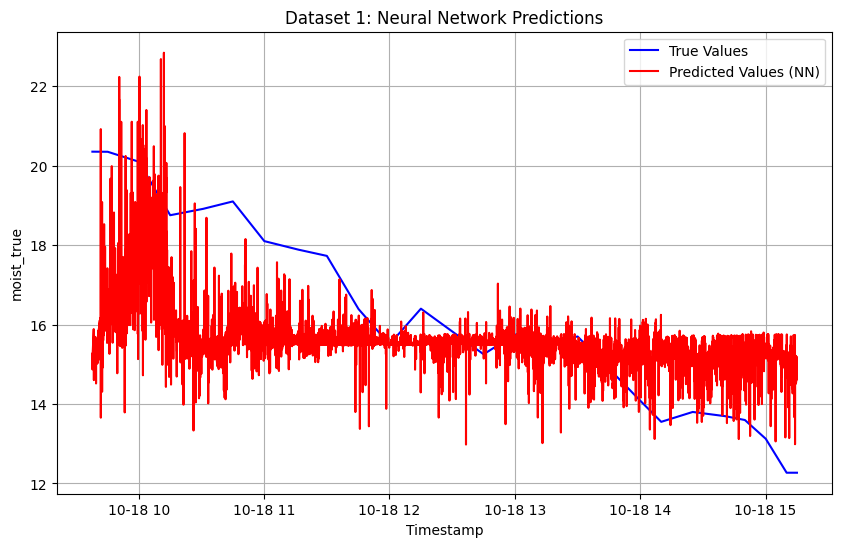

--- Testing on Dataset 2 ---


<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

611/611 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


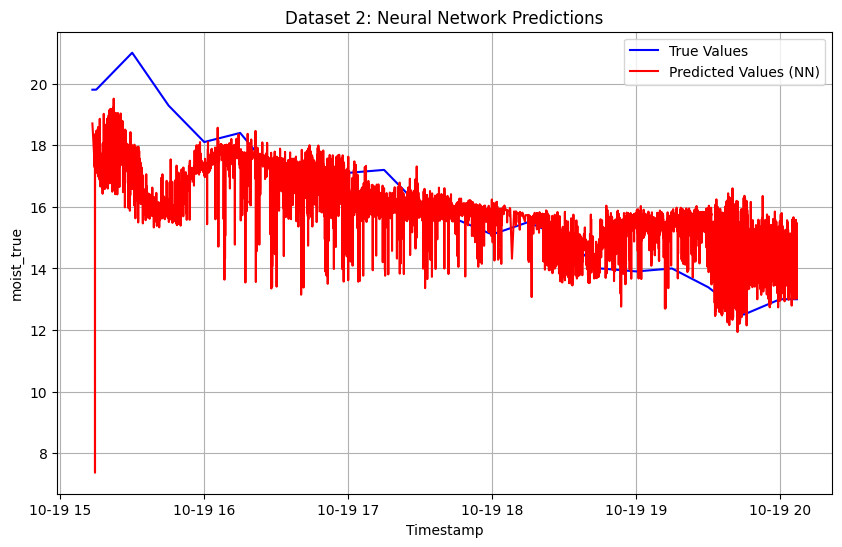

--- Testing on Dataset 3 ---


<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

204/204 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


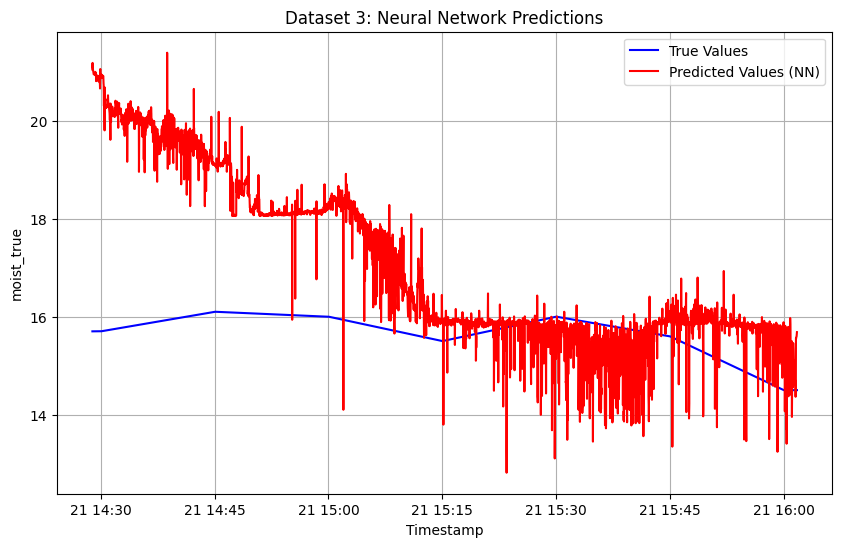

--- Testing on Dataset 4 ---


<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-43-0fe9f5d861fc>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

639/639 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


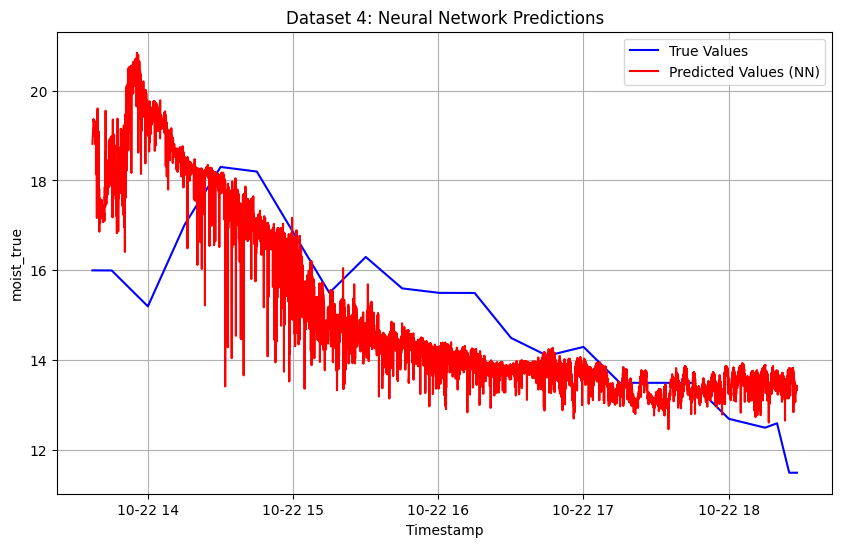

Dataset 1: MSE = 3.6923418290239036
Dataset 2: MSE = 2.5413844475193144
Dataset 3: MSE = 4.320116099384867
Dataset 4: MSE = 2.257853086566796


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

# Preprocessing function
def preprocess_data_with_features(filepath):
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # Drop NA values
    data.dropna(inplace=True)

    # Crop data
    data = data[data["temp_heated"] > 65]
    return data

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained']
target_col = 'moist_true'

# Train and evaluate Neural Network model
def run_neural_network(datasets, target_col, features):
    results = []

    for i, filepath in enumerate(datasets):
        print(f"--- Testing on Dataset {i + 1} ---")

        # Combine train datasets (leave one dataset for validation)
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        train_data = pd.concat([preprocess_data_with_features(f) for f in train_files], axis=0)
        val_data = preprocess_data_with_features(filepath)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Scale the data
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_val_scaled = scaler.transform(X_val)

        # Define the Neural Network
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dropout(0.2),
            Dense(32, activation='relu'),
            Dense(1)  # Output layer for regression
        ])

        model.compile(optimizer='adam', loss='mse')

        # Train the model
        history = model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=0)

        # Predict on validation data
        predictions = model.predict(X_val_scaled).flatten()

        # Calculate MSE
        mse = mean_squared_error(y_val, predictions)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values (NN)", color='red')
        plt.title(f"Dataset {i + 1}: Neural Network Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

    return results

# Run the model and display results
nn_results = run_neural_network(datasets, target_col, features)
for dataset_id, mse in nn_results:
    print(f"Dataset {dataset_id}: MSE = {mse}")


--- Testing on Dataset 1 ---


<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

742/742 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


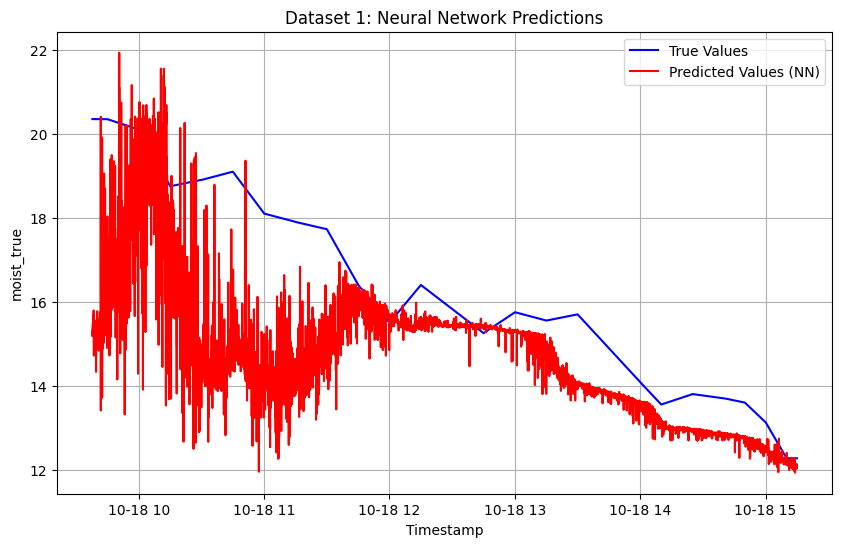

--- Testing on Dataset 2 ---


<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

611/611 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


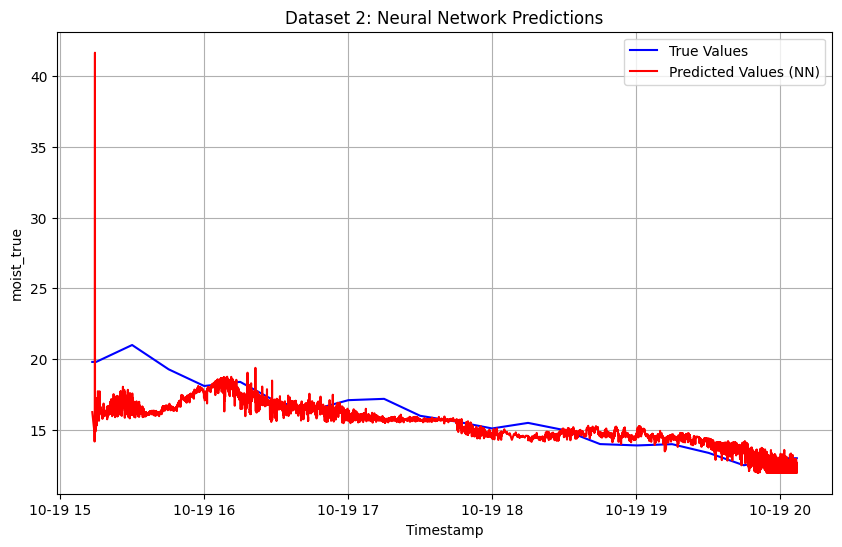

--- Testing on Dataset 3 ---


<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

204/204 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


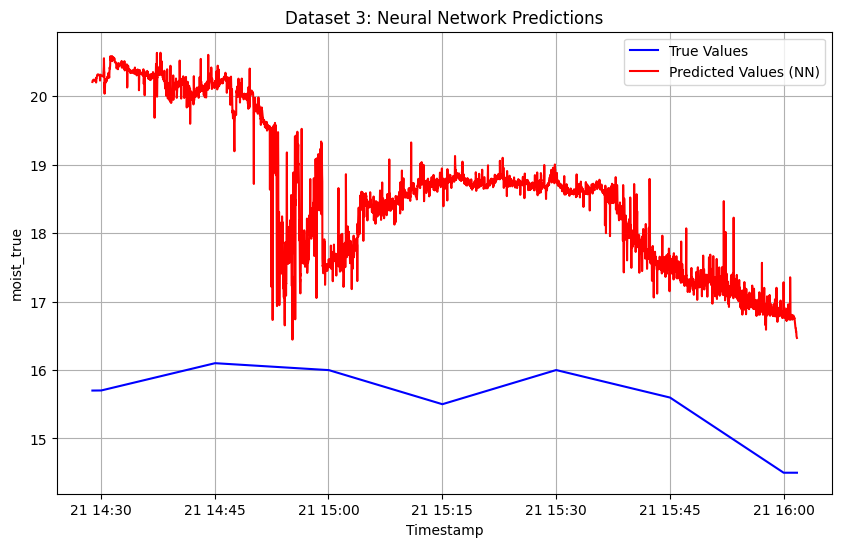

--- Testing on Dataset 4 ---


<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-44-e6effc3b1edd>:16: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(met

639/639 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


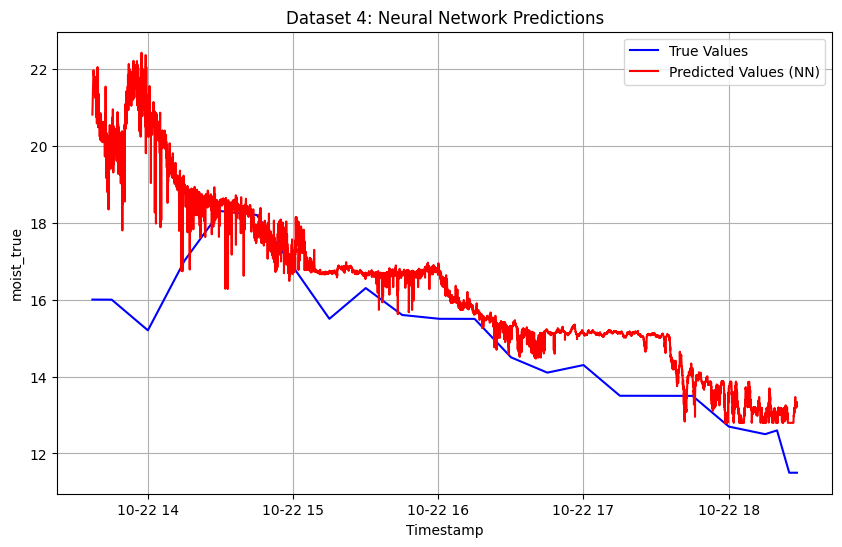

Dataset 1: MSE = 4.72564065752636
Dataset 2: MSE = 2.3209079203689758
Dataset 3: MSE = 9.272178931595167
Dataset 4: MSE = 3.4984797506752483


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

# Preprocessing function
def preprocess_data_with_features(filepath):
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Interpolate and fill missing values
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Feature engineering
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()

    # New features
    data['rolling_temp_low'] = data['temp_low'].rolling(window=5).mean()
    data['rolling_temp_high'] = data['temp_high'].rolling(window=5).mean()
    data['rolling_heat_transfer'] = data['heat_transfer'].rolling(window=5).mean()
    data['lagged_temp_low'] = data['temp_low'].shift(1)
    data['lagged_heat_transfer'] = data['heat_transfer'].shift(1)
    data['heat_time_interaction'] = data['heat_transfer'] * data['time_elapsed']

    # Drop NA values
    data.dropna(inplace=True)

    # Crop data
    data = data[data["temp_heated"] > 65]
    return data

# File paths for all datasets
datasets = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',
    '/content/W42_cycle_2024-10-19_15-06-00.csv',
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'
]

# Features and target column
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained', 'rolling_temp_low','rolling_temp_high', 'rolling_heat_transfer','lagged_temp_low','lagged_heat_transfer','lagged_heat_transfer','lagged_heat_transfer','heat_time_interaction']
target_col = 'moist_true'

# Train and evaluate Neural Network model
def run_neural_network(datasets, target_col, features):
    results = []

    for i, filepath in enumerate(datasets):
        print(f"--- Testing on Dataset {i + 1} ---")

        # Combine train datasets (leave one dataset for validation)
        train_files = [datasets[j] for j in range(len(datasets)) if j != i]
        train_data = pd.concat([preprocess_data_with_features(f) for f in train_files], axis=0)
        val_data = preprocess_data_with_features(filepath)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_val, y_val = val_data[features], val_data[target_col]

        # Scale the data
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_val_scaled = scaler.transform(X_val)

        # Define the Neural Network
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dropout(0.2),
            Dense(32, activation='relu'),
            Dense(1)  # Output layer for regression
        ])

        model.compile(optimizer='adam', loss='mse')

        # Train the model
        history = model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=0)

        # Predict on validation data
        predictions = model.predict(X_val_scaled).flatten()

        # Calculate MSE
        mse = mean_squared_error(y_val, predictions)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(val_data.index, y_val, label="True Values", color='blue')
        plt.plot(val_data.index, predictions, label="Predicted Values (NN)", color='red')
        plt.title(f"Dataset {i + 1}: Neural Network Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

    return results

# Run the model and display results
nn_results = run_neural_network(datasets, target_col, features)
for dataset_id, mse in nn_results:
    print(f"Dataset {dataset_id}: MSE = {mse}")


# **Experiment 3: from 0**

Processing data1...


<ipython-input-15-90fc10d38638>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


Processing data2...


<ipython-input-15-90fc10d38638>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-15-90fc10d38638>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


Processing data3...
Processing data4...


<ipython-input-15-90fc10d38638>:9: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


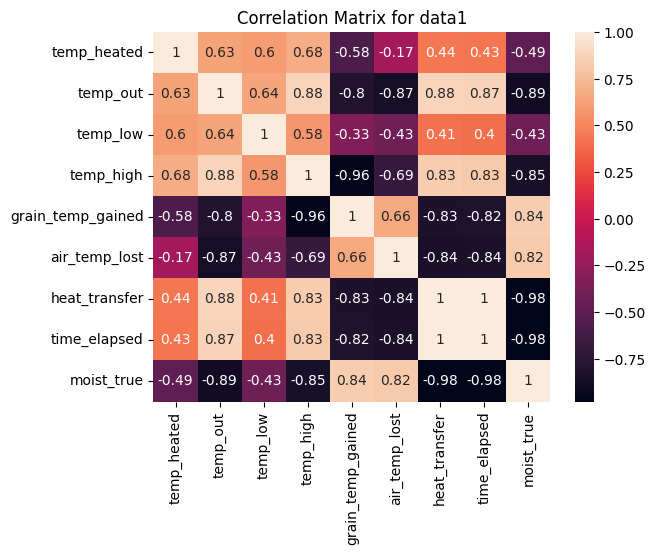

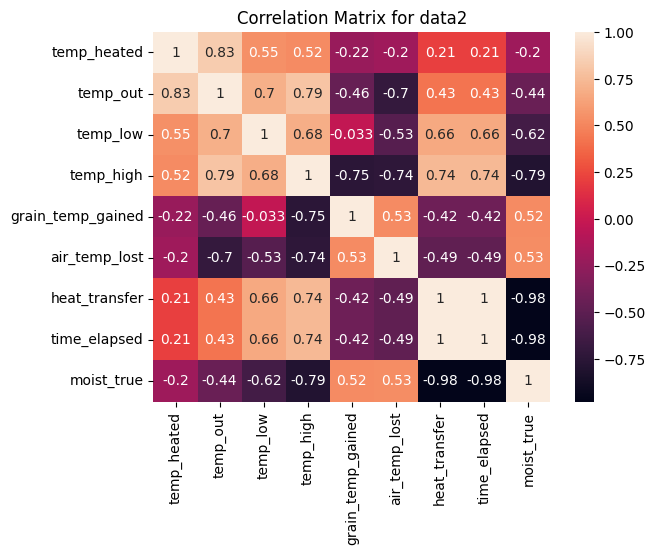

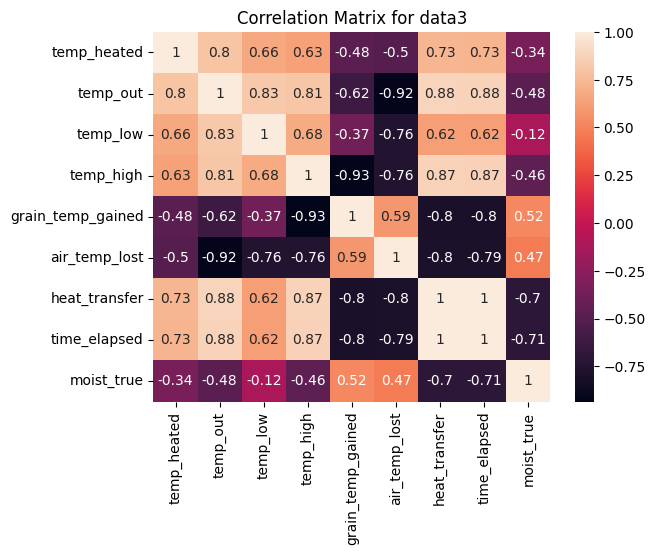

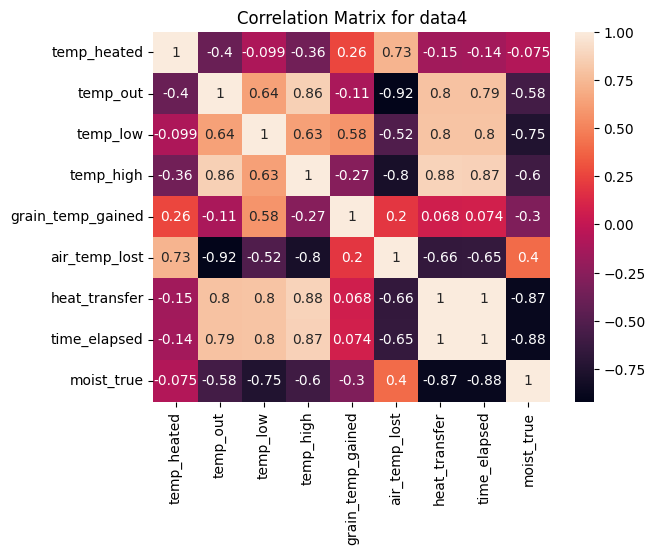

In [ ]:

# Function to preprocess a single dataset
def preprocess_dataset(filepath):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Handle missing values: interpolate and fill
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Remove early-phase data where temp_heated < 65
    data = data[data['temp_heated'] > 65]

    # Feature Engineering
    # 1. Grain temp gained
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    # 2. Air temperature lost
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    # 3. Cumulative heat transfer
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()
    # 4. Time elapsed since start
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()


    #Drop the moist sensors
    data = data.drop(columns=['moist_E', 'moist_V', 'moist_F'])

    # Move 'moist_true' to the last column
    column_to_move = 'moist_true'
    data = data[[col for col in data.columns if col != column_to_move] + [column_to_move]]

    return data

# Paths to datasets
dataset_paths = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',  # Dataset 1
    '/content/W42_cycle_2024-10-19_15-06-00.csv',  # Dataset 2
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'   # Dataset 4
]

# Loop through each dataset and preprocess
datasets = {}  # To store preprocessed datasets

for i, path in enumerate(dataset_paths):
    dataset_name = f"data{i+1}"
    print(f"Processing {dataset_name}...")
    datasets[dataset_name] = preprocess_dataset(path)

# Accessing updated datasets
data1 = datasets['data1']
data2 = datasets['data2']
data3 = datasets['data3']
data4 = datasets['data4']

# Display the first few rows of each dataset to confirm changes
# print("Dataset 1:")
# print(data1.head())
# print("\nDataset 2:")
# print(data2.head())
# print("\nDataset 3:")
# print(data3.head())
# print("\nDataset 4:")
# print(data4.head())
for dataset_name, data in datasets.items():
    sns.heatmap(data.corr(), annot=True)
    plt.title(f"Correlation Matrix for {dataset_name}")
    plt.show()



**We have smoothed the data: A polynomial smoothing filter that reduces noise while preserving trends in the data.**

Savitzky-Golay Filter (Advanced Smoothing)

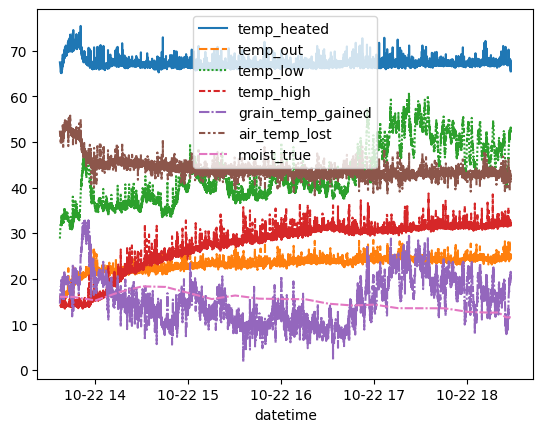

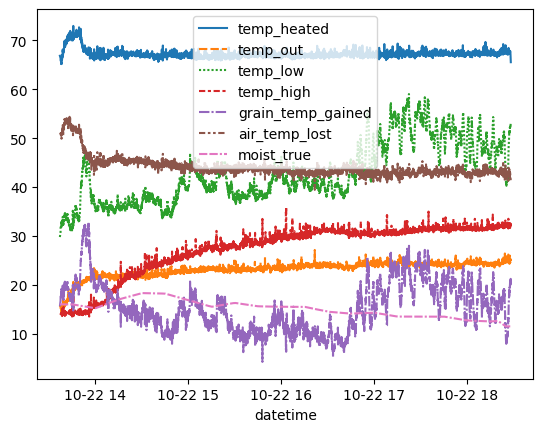

In [ ]:
from scipy.signal import savgol_filter

def smooth_data_with_savgol(data, window=11, polyorder=2):
    """Smooth data using the Savitzky-Golay filter."""
    smoothed_data = data.apply(lambda col: savgol_filter(col, window_length=window, polyorder=polyorder))
    return pd.DataFrame(smoothed_data, columns=data.columns, index=data.index)

# Smooth each dataset
smoothed_data1 = smooth_data_with_savgol(data1)
smoothed_data2 = smooth_data_with_savgol(data2)
smoothed_data3 = smooth_data_with_savgol(data3)
smoothed_data4 = smooth_data_with_savgol(data4)


# plot smoothed data
data_without_2columns= data4.drop(columns=['heat_transfer', 'time_elapsed'])
smooth_data_without2columns = smoothed_data4.drop(columns=['heat_transfer', 'time_elapsed'])

dataset_to_compare=[data_without_2columns,smooth_data_without2columns]


# now we can clearly see the difference between smoothed and unsmoothed data (Example: Dataset1)
for each_data in dataset_to_compare:
  sns.lineplot(data=each_data)
  plt.show()



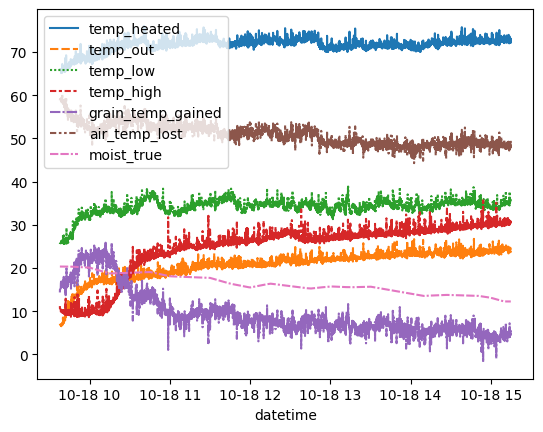

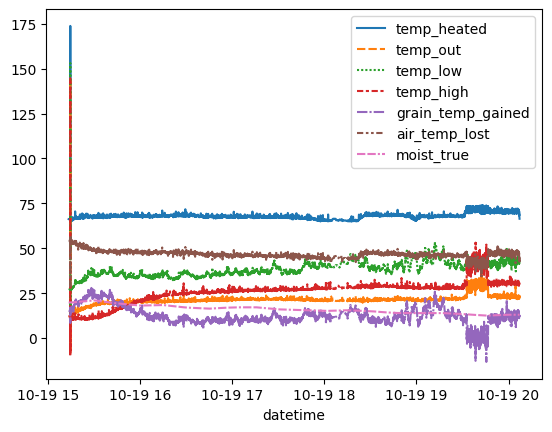

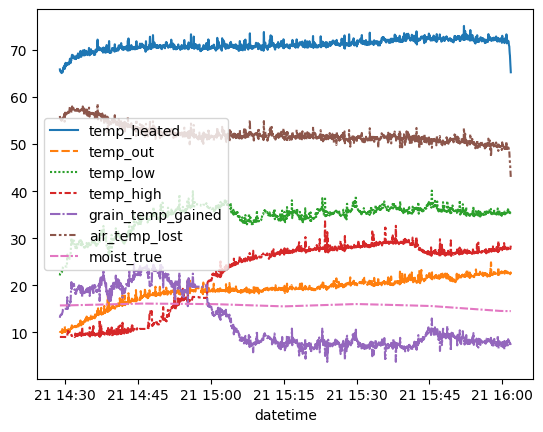

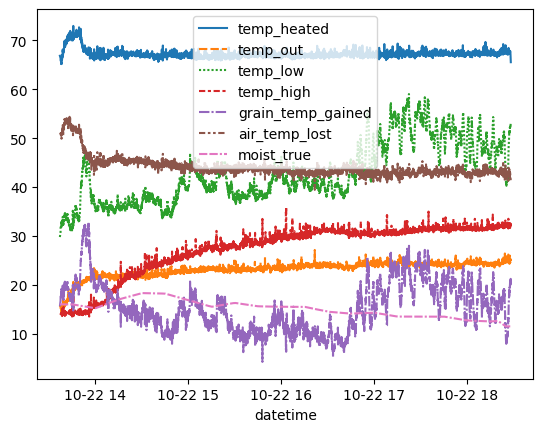

In [ ]:
smoothed_datasets = [smoothed_data1, smoothed_data2, smoothed_data3, smoothed_data4]

for data in smoothed_datasets:
  test=data.drop(columns=['heat_transfer', 'time_elapsed'])
  sns.lineplot(test)
  plt.show()

# **Linear Regression**


--- Iteration 1: Testing on Dataset 1 ---


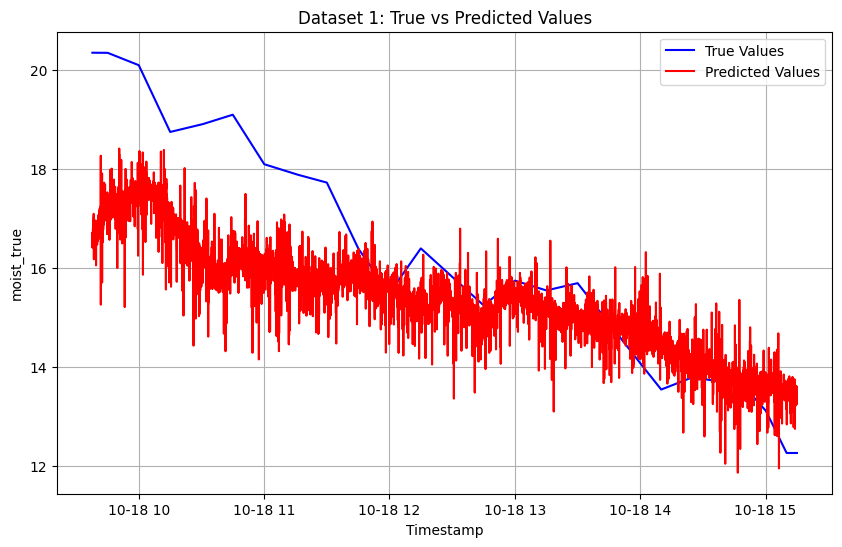

Dataset 1: MSE = 2.3308

--- Iteration 2: Testing on Dataset 2 ---


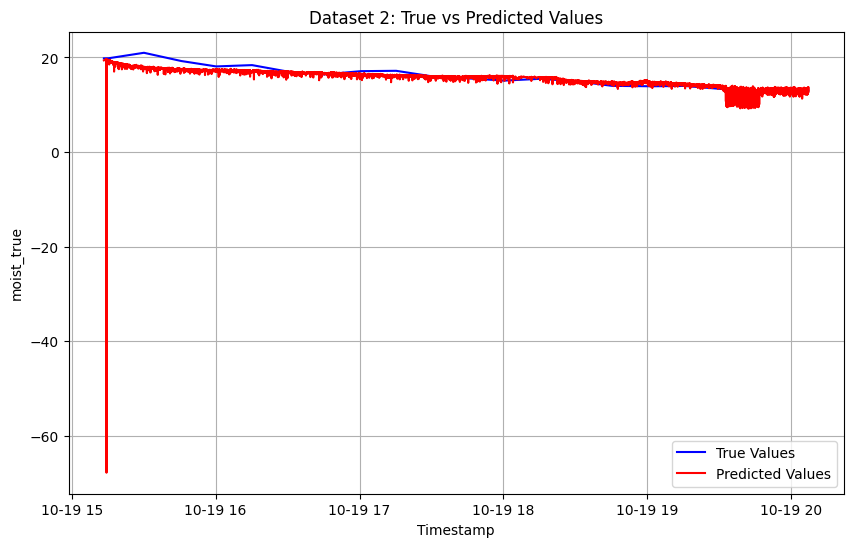

Dataset 2: MSE = 1.8210

--- Iteration 3: Testing on Dataset 3 ---


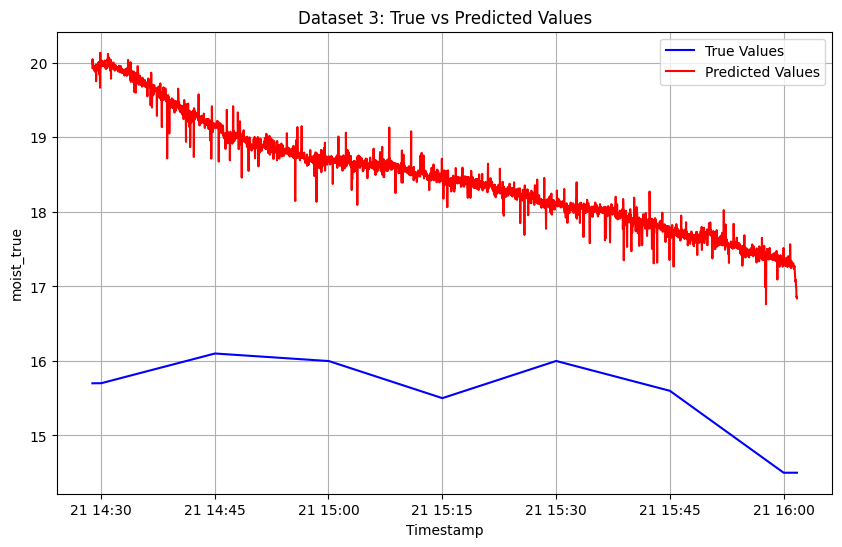

Dataset 3: MSE = 7.9880

--- Iteration 4: Testing on Dataset 4 ---


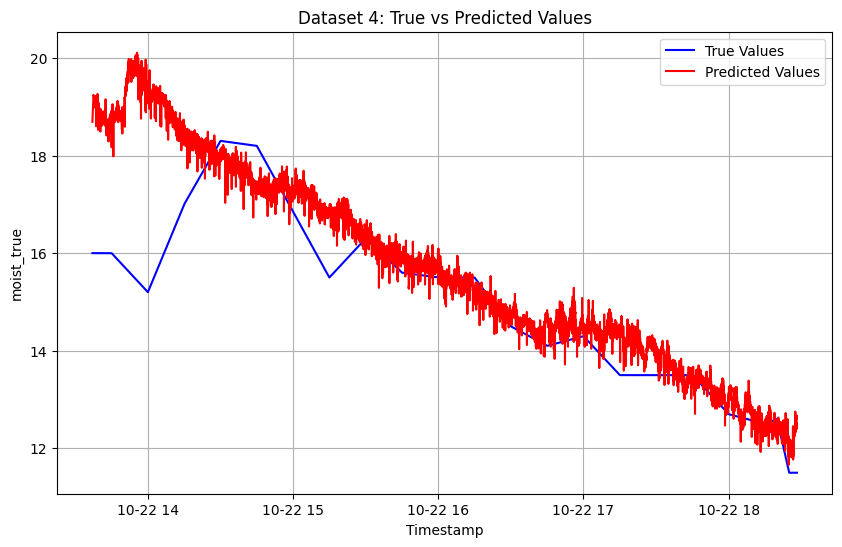

Dataset 4: MSE = 1.6318

Final Results:
Dataset 1: MSE = 2.3308
Dataset 2: MSE = 1.8210
Dataset 3: MSE = 7.9880
Dataset 4: MSE = 1.6318


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Preprocessing function
def preprocess_dataset(filepath):
    """Preprocesses a single dataset: interpolates, adds features, and moves 'moist_true' to the last column."""
    data = filepath
    return data

# File paths for datasets
dataset_paths = [
    data1, data2, data3, data4
]

# Features and target
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained', 'heat_transfer', 'time_elapsed','temp_heated','temp_out']
target_col = 'moist_true'

# Function to train and test a model using 3 datasets for training and 1 for testing
def train_test_loop(datasets, features, target_col):
    """Train and test a model using 3 datasets for training and 1 for testing."""
    from sklearn.linear_model import LinearRegression  # Example model: Linear Regression

    results = []

    for i, test_path in enumerate(datasets):
        print(f"\n--- Iteration {i+1}: Testing on Dataset {i+1} ---")

        # Prepare training datasets (all except the test dataset)
        train_paths = [p for j, p in enumerate(datasets) if j != i]
        train_data = pd.concat([preprocess_dataset(p) for p in train_paths], axis=0)
        test_data = preprocess_dataset(test_path)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Initialize and train a Linear Regression model
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, y_pred, label="Predicted Values", color='red')
        plt.title(f"Dataset {i + 1}: True vs Predicted Values")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

        print(f"Dataset {i + 1}: MSE = {mse:.4f}")

    return results

# Run the function
results = train_test_loop(dataset_paths, features, target_col)

# Print the final MSE results for all iterations
print("\nFinal Results:")
for dataset_id, mse in results:
    print(f"Dataset {dataset_id}: MSE = {mse:.4f}")


# **XGBoost**


--- Iteration 1: Testing on Dataset 1 ---


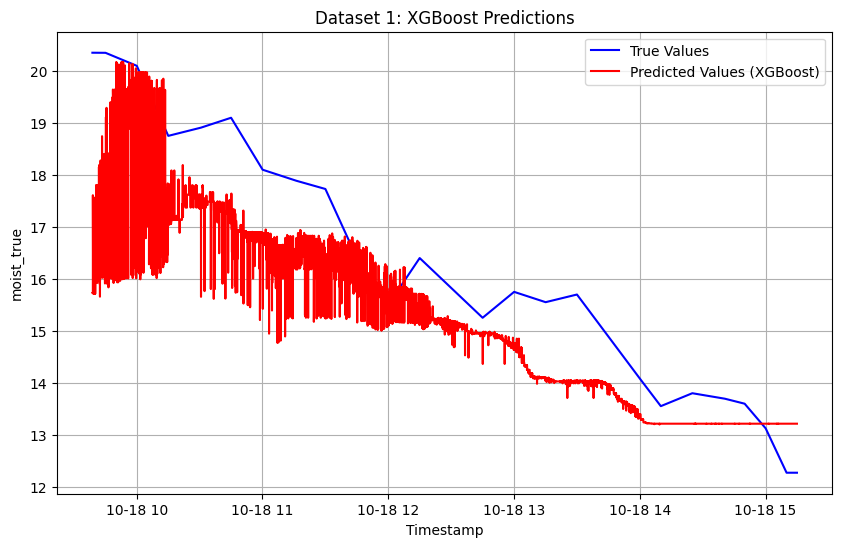

Dataset 1: MSE = 1.6853

--- Iteration 2: Testing on Dataset 2 ---


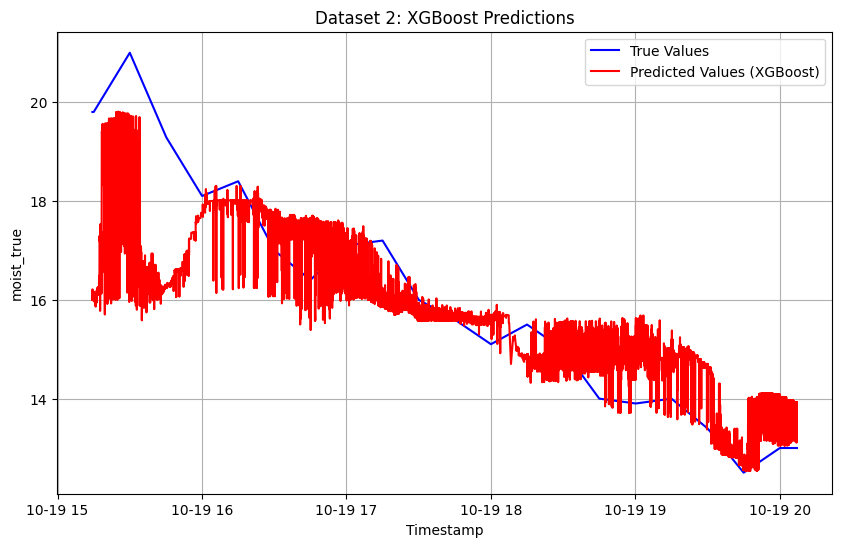

Dataset 2: MSE = 1.5705

--- Iteration 3: Testing on Dataset 3 ---

--- Iteration 4: Testing on Dataset 4 ---


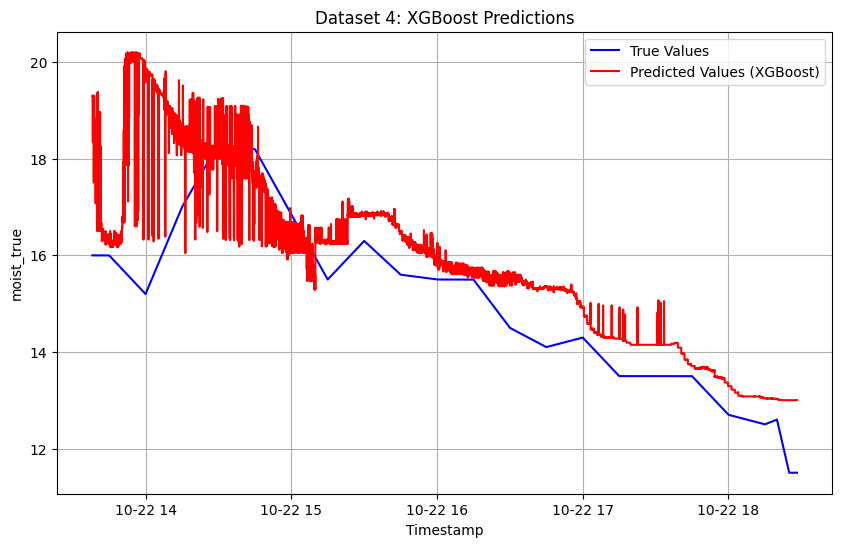

Dataset 4: MSE = 1.6979

Final Results:
Dataset 1: MSE = 1.6853, MAPE = 6.13%
Dataset 2: MSE = 1.5705, MAPE = 5.14%
Dataset 4: MSE = 1.6979, MAPE = 5.93%


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_percentage_error

def preprocess_dataset(filepath):
    """Preprocesses a single dataset: interpolates, adds features, and moves 'moist_true' to the last column."""
    data = filepath

    return data

# File paths for datasets
dataset_paths = [
    data1, data2, data3, data4
    ]


#data3[data3.index > '2024-10-21 14:45:00']


# Features and target
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained', 'heat_transfer', 'time_elapsed','temp_heated','temp_out']
target_col = 'moist_true'

# Function to train and test XGBoost model
def train_test_xgboost_loop(datasets, features, target_col):
    """Train and test an XGBoost model using 3 datasets for training and 1 for testing."""
    results = []

    for i, test_path in enumerate(datasets):
        print(f"\n--- Iteration {i+1}: Testing on Dataset {i+1} ---")
        if i == 2:
            continue

        # Prepare training datasets (all except the test dataset)
        train_paths = [p for j, p in enumerate(datasets) if j != i]
        train_data = pd.concat([preprocess_dataset(p) for p in train_paths], axis=0)
        test_data = preprocess_dataset(test_path)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Initialize and train XGBoost model
        # model = XGBRegressor(reg_lambda=1,n_estimators=200, learning_rate=0.01, max_depth=6, random_state=42)                           # 2         2      3       1
        model = XGBRegressor(alpha=1, learning_rate=0.008, n_estimators=300, max_depth=6, random_state=42)    #1.6996  1.6690  6.9626  1.6351
        # model = XGBRegressor(alpha=2, learning_rate=0.005, n_estimators=300, max_depth=5, random_state=42)     #1.8746  2.0895  5.3500  1.5450
        # model = XGBRegressor(learning_rate=0.01, n_estimators=300, max_depth=6, random_state=42)
        model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        mape = mean_absolute_percentage_error(y_test, y_pred) * 100
        results.append((i + 1, mse, mape))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, y_pred, label="Predicted Values (XGBoost)", color='red')
        plt.title(f"Dataset {i + 1}: XGBoost Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

        print(f"Dataset {i + 1}: MSE = {mse:.4f}")

    return results

# Run the function
results = train_test_xgboost_loop(dataset_paths, features, target_col)

# Print the final MSE results for all iterations
print("\nFinal Results:")
for dataset_id, mse, mape in results:
    print(f"Dataset {dataset_id}: MSE = {mse:.4f}, MAPE = {mape:.2f}%")


<Axes: xlabel='datetime'>

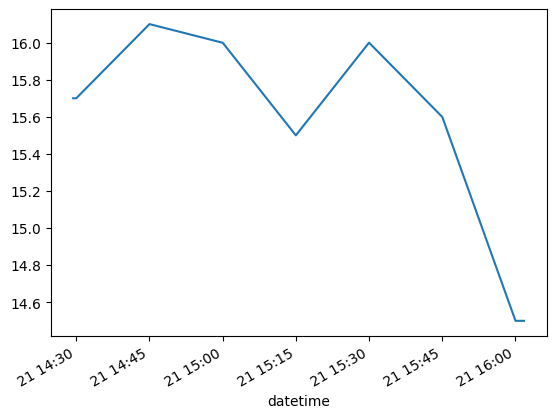

In [ ]:
data3['moist_true'].plot()

<Axes: xlabel='datetime'>

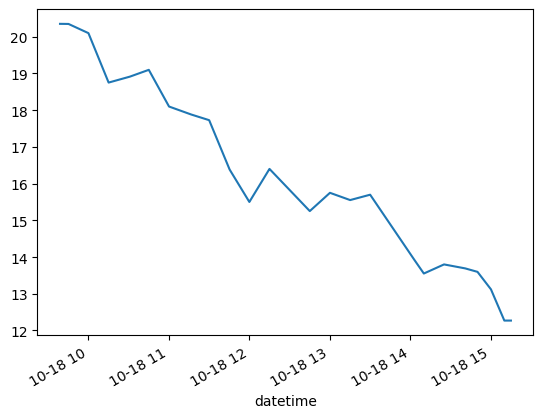

In [ ]:
data1['moist_true'].plot()

<Axes: xlabel='datetime'>

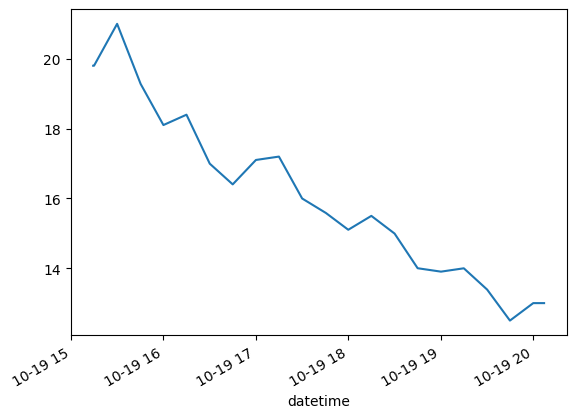

In [ ]:
data2['moist_true'].plot()

<Axes: xlabel='datetime'>

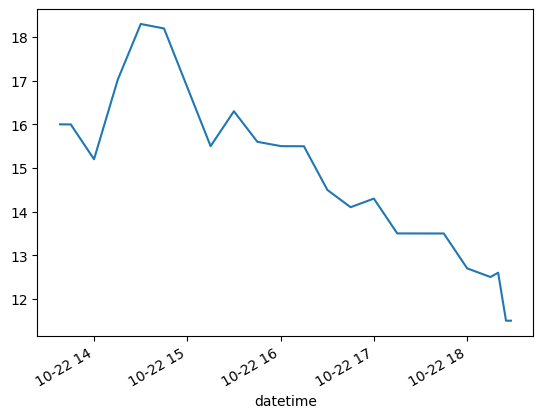

In [ ]:
data4['moist_true'].plot()

# **Random Forest:**


--- Iteration 1: Testing on Dataset 1 ---


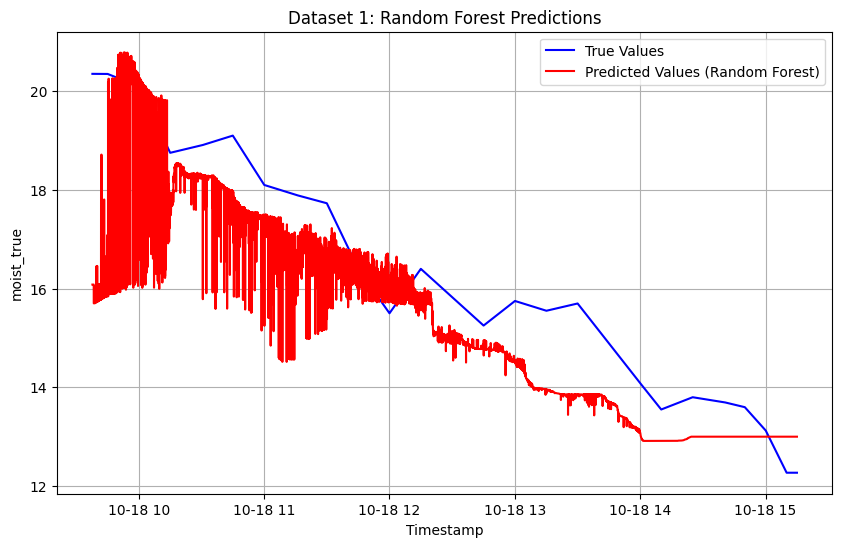

Dataset 1: MSE = 1.5840

--- Iteration 2: Testing on Dataset 2 ---


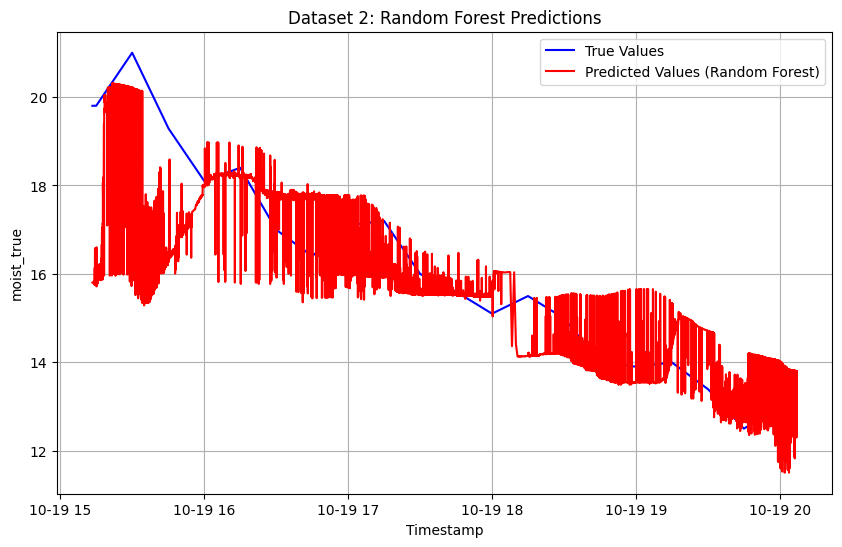

Dataset 2: MSE = 1.6127

--- Iteration 3: Testing on Dataset 3 ---


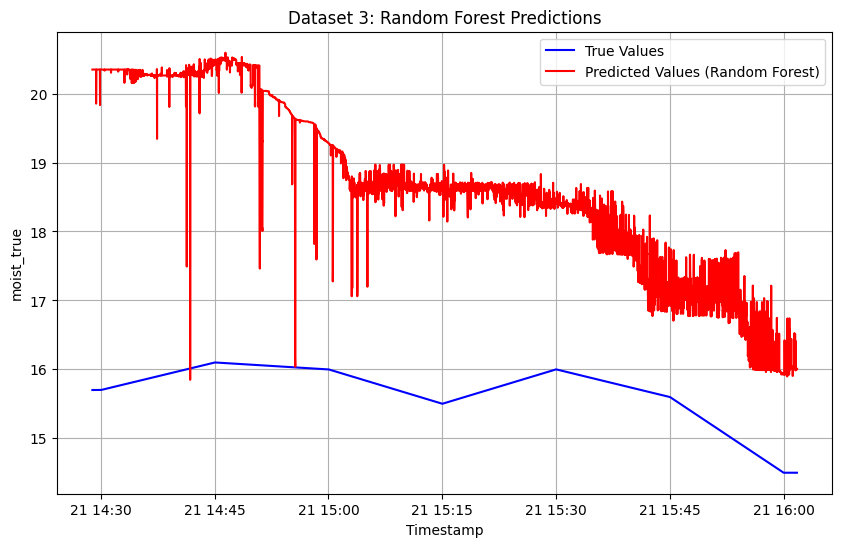

Dataset 3: MSE = 9.8938

--- Iteration 4: Testing on Dataset 4 ---


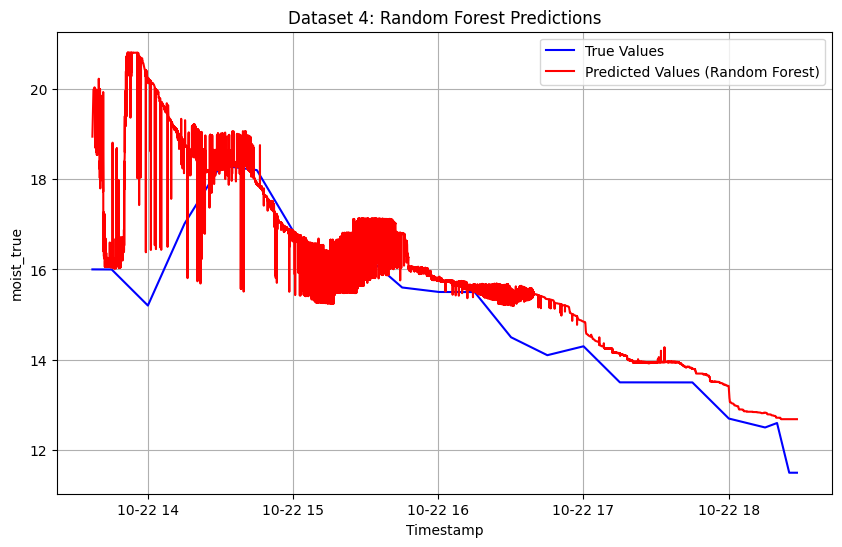

Dataset 4: MSE = 2.0272

Final Results:
Dataset 1: MSE = 1.5840
Dataset 2: MSE = 1.6127
Dataset 3: MSE = 9.8938
Dataset 4: MSE = 2.0272


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor

def preprocess_dataset(filepath):
    """Preprocesses a single dataset: interpolates, adds features, and moves 'moist_true' to the last column."""
    data = filepath
    return data

# File paths for datasets
dataset_paths = [
    data1, data2, data3, data4
]

# Features and target
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained', 'heat_transfer', 'time_elapsed','temp_heated','temp_out']
target_col = 'moist_true'

# Function to train and test Random Forest model
def train_test_random_forest_loop(datasets, features, target_col):
    """Train and test a Random Forest model using 3 datasets for training and 1 for testing."""
    results = []

    for i, test_path in enumerate(datasets):
        print(f"\n--- Iteration {i+1}: Testing on Dataset {i+1} ---")

        # Prepare training datasets (all except the test dataset)
        train_paths = [p for j, p in enumerate(datasets) if j != i]
        train_data = pd.concat([preprocess_dataset(p) for p in train_paths], axis=0)
        test_data = preprocess_dataset(test_path)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Initialize and train Random Forest model
        model = RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42)
        model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, y_pred, label="Predicted Values (Random Forest)", color='red')
        plt.title(f"Dataset {i + 1}: Random Forest Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

        print(f"Dataset {i + 1}: MSE = {mse:.4f}")

    return results

# Run the function
results = train_test_random_forest_loop(dataset_paths, features, target_col)

# Print the final MSE results for all iterations
print("\nFinal Results:")
for dataset_id, mse in results:
    print(f"Dataset {dataset_id}: MSE = {mse:.4f}")


# **Neural Network**


--- Iteration 1: Testing on Dataset 1 ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


742/742 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


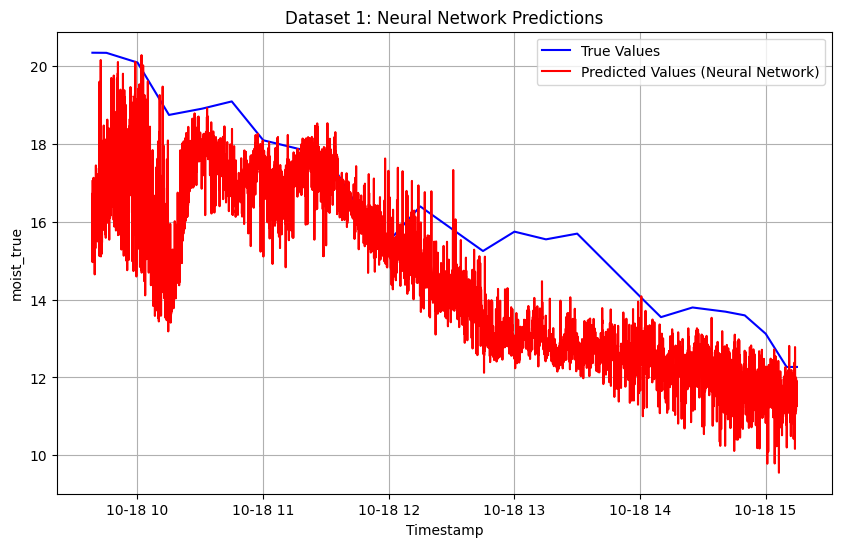

Dataset 1: MSE = 4.1461

--- Iteration 2: Testing on Dataset 2 ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


611/611 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


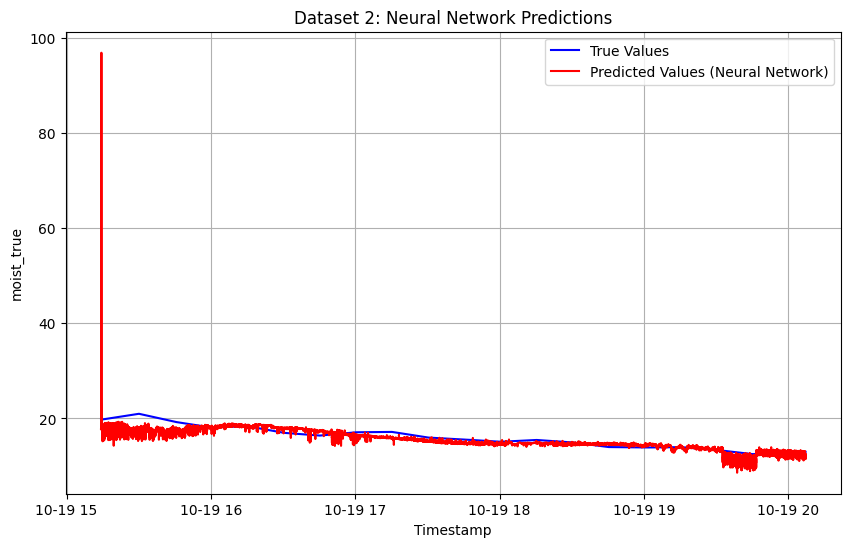

Dataset 2: MSE = 2.0530

--- Iteration 3: Testing on Dataset 3 ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


204/204 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


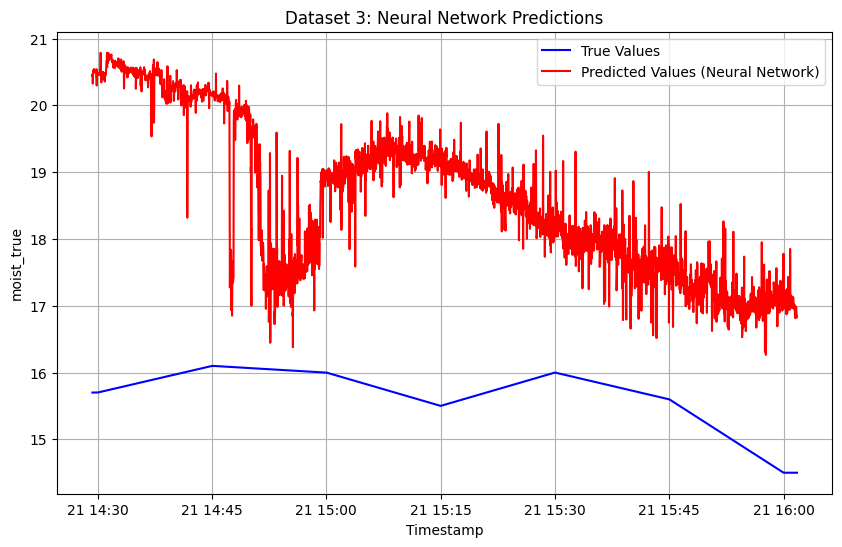

Dataset 3: MSE = 9.5324

--- Iteration 4: Testing on Dataset 4 ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


638/638 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


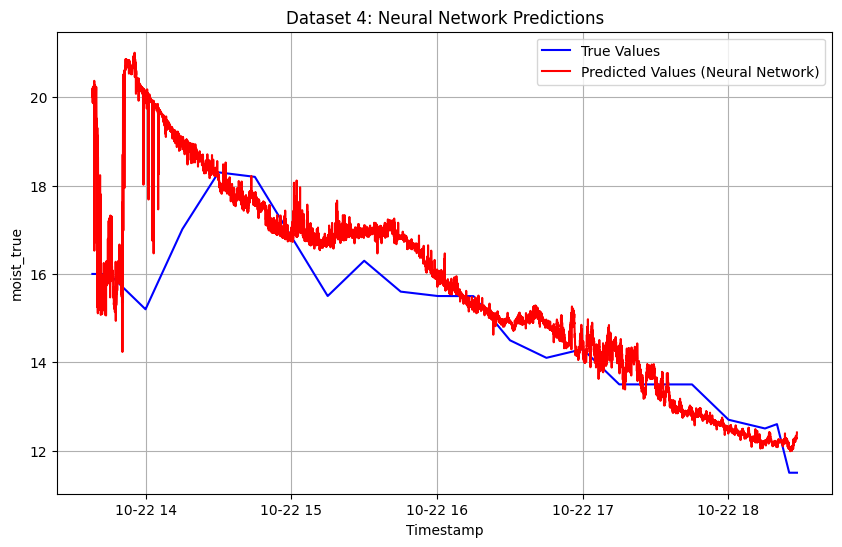

Dataset 4: MSE = 1.9456

Final Results:
Dataset 1: MSE = 4.1461
Dataset 2: MSE = 2.0530
Dataset 3: MSE = 9.5324
Dataset 4: MSE = 1.9456


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler

# Preprocessing function
def preprocess_dataset(filepath):
    """Preprocesses a single dataset: interpolates, adds features, and moves 'moist_true' to the last column."""
    data = filepath


    return data

# File paths for datasets
dataset_paths = [
    data1, data2, data3, data4  # Assume these are already loaded as preprocessed DataFrames
]

# Features and target
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained', 'heat_transfer', 'time_elapsed','temp_heated','temp_out']
target_col = 'moist_true'

# Function to train and test Neural Network
def train_test_nn_loop(datasets, features, target_col):
    """Train and test a Neural Network using 3 datasets for training and 1 for testing."""
    results = []

    for i, test_path in enumerate(datasets):
        print(f"\n--- Iteration {i+1}: Testing on Dataset {i+1} ---")

        # Prepare training datasets (all except the test dataset)
        train_paths = [p for j, p in enumerate(datasets) if j != i]
        train_data = pd.concat([preprocess_dataset(p) for p in train_paths], axis=0)
        test_data = preprocess_dataset(test_path)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Scale features (important for Neural Networks)
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

        # Build Neural Network model
        model = Sequential([
            Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
            Dense(32, activation='relu'),
            Dense(1)  # Output layer for regression
        ])
        model.compile(optimizer='adam', loss='mse', metrics=['mse'])

        # Train the model
        history = model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=0, validation_split=0.1)

        # Predict and evaluate
        y_pred = model.predict(X_test).flatten()
        mse = mean_squared_error(y_test, y_pred)
        results.append((i + 1, mse))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, y_pred, label="Predicted Values (Neural Network)", color='red')
        plt.title(f"Dataset {i + 1}: Neural Network Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

        print(f"Dataset {i + 1}: MSE = {mse:.4f}")

    return results

# Run the function
results = train_test_nn_loop(dataset_paths, features, target_col)

# Print the final MSE results for all iterations
print("\nFinal Results:")
for dataset_id, mse in results:
    print(f"Dataset {dataset_id}: MSE = {mse:.4f}")


# **work with change**

<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna


--- Iteration 1: Testing on Dataset 1 ---


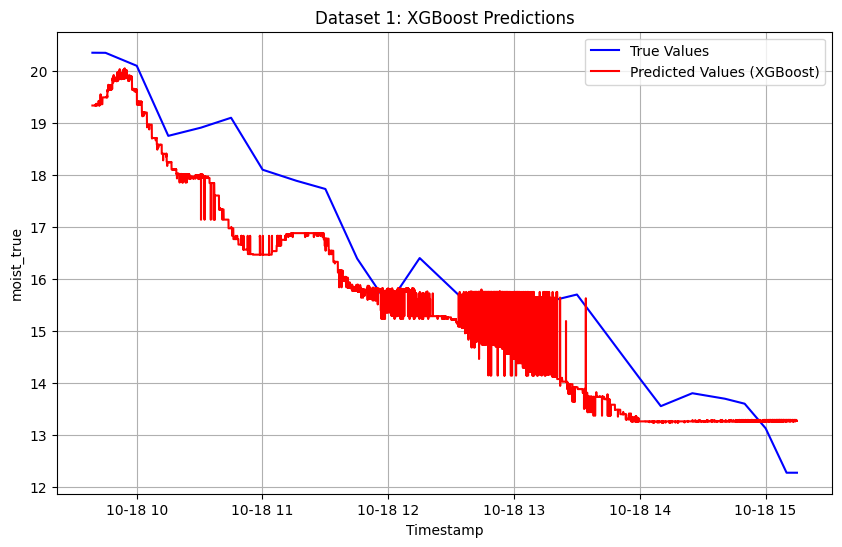

Dataset 1: MSE = 0.9707

--- Iteration 2: Testing on Dataset 2 ---


<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


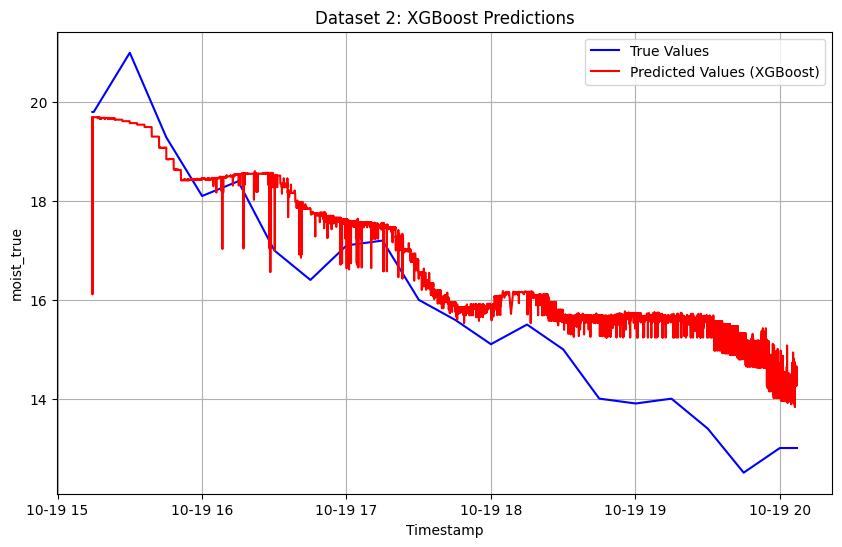

Dataset 2: MSE = 1.5608

--- Iteration 4: Testing on Dataset 4 ---


<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-197-d953515e3f0d>:14: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


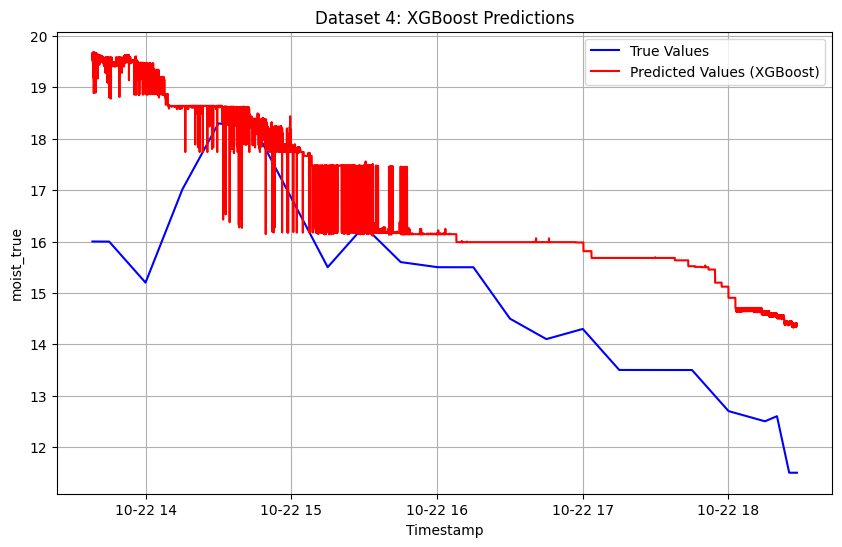

Dataset 4: MSE = 3.6499

Final Results:
Dataset 1: MSE = 0.9707
Dataset 2: MSE = 1.5608
Dataset 4: MSE = 3.6499


In [ ]:
import pandas as pd

In [ ]:
data_first=pd.read_csv('/content/W42_cycle_2024-10-18_09-31-00.csv')
data_first

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-18 09:31:01+03:00,10.0,4.4,10.8,12.7,NaN,NaN,NaN,NaN
1,2024-10-18 09:31:01.237000+03:00,NaN,NaN,NaN,NaN,172.20,165.05,193.05,NaN
2,2024-10-18 09:31:02+03:00,8.4,4.4,9.5,11.9,NaN,NaN,NaN,NaN
3,2024-10-18 09:31:02.912000+03:00,NaN,NaN,NaN,NaN,171.60,164.45,192.55,NaN
4,2024-10-18 09:31:04+03:00,11.8,7.8,9.1,11.5,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
24276,2024-10-18 15:14:56.380000+03:00,NaN,NaN,NaN,NaN,148.55,142.25,164.10,NaN
24277,2024-10-18 15:14:57+03:00,72.4,23.7,35.5,30.5,NaN,NaN,NaN,NaN
24278,2024-10-18 15:14:58.065000+03:00,NaN,NaN,NaN,NaN,149.20,142.90,164.90,NaN
24279,2024-10-18 15:14:59+03:00,72.9,23.7,35.5,30.5,NaN,NaN,NaN,NaN


In [ ]:
data_second=pd.read_csv('/content/W42_cycle_2024-10-19_15-06-00.csv')
data_second

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-19 15:06:18+03:00,16.7,10.7,15.7,11.2,NaN,NaN,NaN,NaN
1,2024-10-19 15:06:43+03:00,16.7,10.8,12.2,11.7,NaN,NaN,NaN,NaN
2,2024-10-19 15:07:08+03:00,16.9,10.6,12.0,11.6,NaN,NaN,NaN,NaN
3,2024-10-19 15:07:33+03:00,21.6,12.6,11.9,10.9,NaN,NaN,NaN,NaN
4,2024-10-19 15:07:58+03:00,27.7,10.4,11.7,11.4,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
20677,2024-10-19 20:08:08+03:00,43.1,22.9,42.6,32.0,NaN,NaN,NaN,NaN
20678,2024-10-19 20:08:08.518000+03:00,NaN,NaN,NaN,NaN,151.85,143.55,164.15,NaN
20679,2024-10-19 20:08:10+03:00,46.9,22.6,41.1,29.2,NaN,NaN,NaN,NaN
20680,2024-10-19 20:08:10.185000+03:00,NaN,NaN,NaN,NaN,150.60,142.90,163.95,NaN


In [ ]:
data_third=pd.read_csv('/content/W43_cycle_2024-10-21_14-23-30.csv')
data_third

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-21 14:23:31+03:00,14.5,9.6,11.3,9.9,NaN,NaN,NaN,NaN
1,2024-10-21 14:23:31.294000+03:00,NaN,NaN,NaN,NaN,158.70,150.80,173.95,NaN
2,2024-10-21 14:23:32+03:00,14.1,8.9,14.1,9.8,NaN,NaN,NaN,NaN
3,2024-10-21 14:23:32.969000+03:00,NaN,NaN,NaN,NaN,157.15,149.85,173.05,NaN
4,2024-10-21 14:23:34+03:00,14.4,9.4,11.0,9.7,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
6953,2024-10-21 16:02:16.288000+03:00,NaN,NaN,NaN,NaN,134.50,128.95,145.75,NaN
6954,2024-10-21 16:02:17+03:00,55.1,22.6,35.4,28.0,NaN,NaN,NaN,NaN
6955,2024-10-21 16:02:18.033000+03:00,NaN,NaN,NaN,NaN,134.70,129.25,146.20,NaN
6956,2024-10-21 16:02:19+03:00,54.3,22.8,35.0,28.0,NaN,NaN,NaN,NaN


In [ ]:
data_fourth = pd.read_csv('/content/W43_cycle_2024-10-22_13-33-00.csv')
data_fourth

,datetime,temp_heated,temp_out,temp_low,temp_high,moist_F,moist_V,moist_E,moist_true
0,2024-10-22 13:33:00+03:00,16.5,15.3,15.2,14.5,NaN,NaN,NaN,NaN
1,2024-10-22 13:33:01.247000+03:00,NaN,NaN,NaN,NaN,159.70,150.15,171.80,NaN
2,2024-10-22 13:33:02+03:00,16.7,15.5,14.9,14.6,NaN,NaN,NaN,NaN
3,2024-10-22 13:33:02.695000+03:00,NaN,NaN,NaN,NaN,157.70,149.55,171.95,NaN
4,2024-10-22 13:33:04+03:00,18.1,15.3,15.5,13.7,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
20813,2024-10-22 18:28:57+03:00,52.4,24.5,51.0,32.3,NaN,NaN,NaN,NaN
20814,2024-10-22 18:28:57.603000+03:00,NaN,NaN,NaN,NaN,144.80,136.90,155.75,NaN
20815,2024-10-22 18:28:59+03:00,52.1,25.1,50.8,32.3,NaN,NaN,NaN,NaN
20816,2024-10-22 18:28:59.284000+03:00,NaN,NaN,NaN,NaN,143.35,136.30,154.95,NaN


# **Ensemble model**

In [ ]:
def preprocess_dataset(filepath):
    # Load data
    data = pd.read_csv(filepath)
    data['datetime'] = pd.to_datetime(data['datetime'], format='mixed')
    data.set_index('datetime', inplace=True)

    # Handle missing values: interpolate and fill
    data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')

    # Remove early-phase data where temp_heated < 65
    data = data[data['temp_heated'] > 65]

    # Feature Engineering
    # 1. Grain temp gained
    data['grain_temp_gained'] = data['temp_low'] - data['temp_high']
    # 2. Air temperature lost
    data['air_temp_lost'] = data['temp_heated'] - data['temp_out']
    # 3. Cumulative heat transfer
    timestep_durations = data.index.to_series().diff().dt.total_seconds().fillna(0)
    data['heat_transfer'] = (data['air_temp_lost'] * timestep_durations).cumsum()
    # 4. Time elapsed since start
    data['time_elapsed'] = (data.index - data.index[0]).total_seconds()


    #Drop the moist sensors
    data = data.drop(columns=['moist_E', 'moist_V', 'moist_F'])

    # Move 'moist_true' to the last column
    column_to_move = 'moist_true'
    data = data[[col for col in data.columns if col != column_to_move] + [column_to_move]]

    return data

# Paths to datasets
dataset_paths = [
    '/content/W42_cycle_2024-10-18_09-31-00.csv',  # Dataset 1
    '/content/W42_cycle_2024-10-19_15-06-00.csv',  # Dataset 2
    '/content/W43_cycle_2024-10-21_14-23-30.csv',  # Dataset 3
    '/content/W43_cycle_2024-10-22_13-33-00.csv'   # Dataset 4
]

# Loop through each dataset and preprocess
datasets = {}  # To store preprocessed datasets

for i, path in enumerate(dataset_paths):
    dataset_name = f"data{i+1}"
    print(f"Processing {dataset_name}...")
    datasets[dataset_name] = preprocess_dataset(path)

# Accessing updated datasets
data1 = datasets['data1']
data2 = datasets['data2']
data3 = datasets['data3']
data4 = datasets['data4']

Processing data1...


<ipython-input-24-b562030e7411>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


Processing data2...


<ipython-input-24-b562030e7411>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')
<ipython-input-24-b562030e7411>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')


Processing data3...
Processing data4...


<ipython-input-24-b562030e7411>:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data = data.interpolate(method='time').fillna(method='ffill').fillna(method='bfill')



--- Iteration 1: Testing on Dataset 1 ---


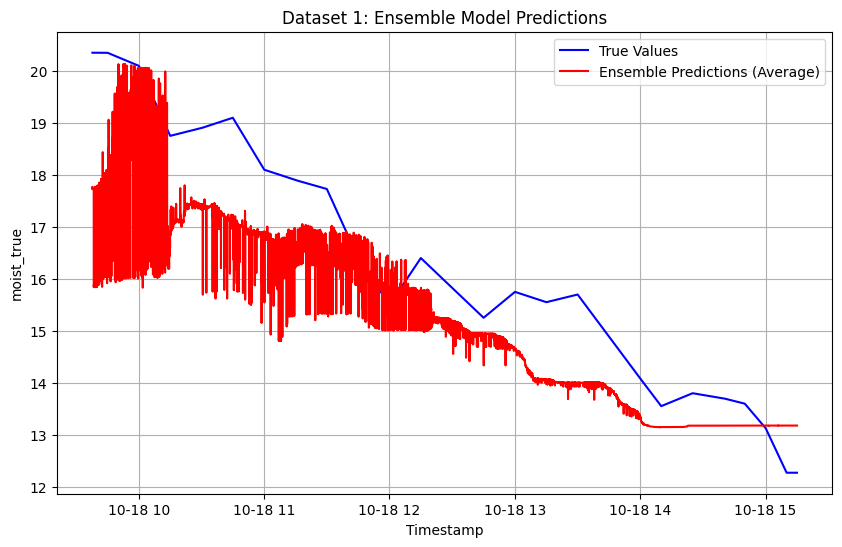

Dataset 1: MSE = 1.7972, MAPE = 6.32%

--- Iteration 2: Testing on Dataset 2 ---


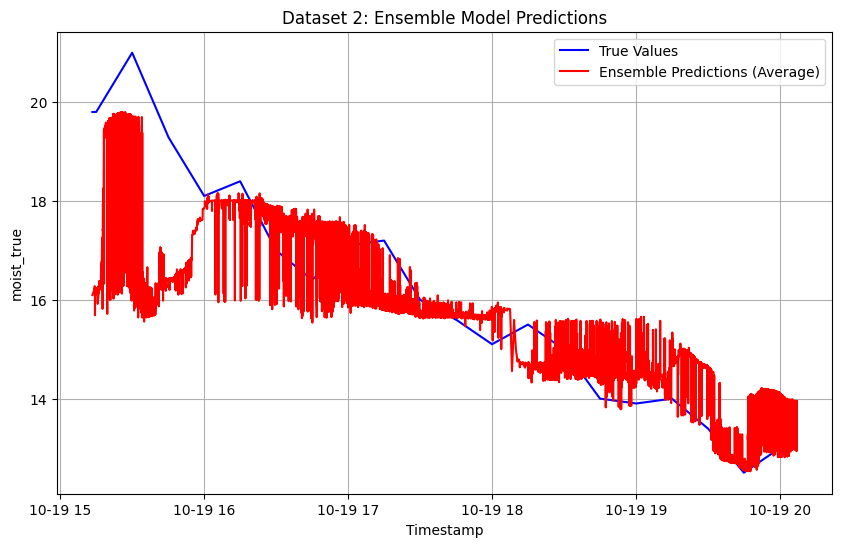

Dataset 2: MSE = 1.6533, MAPE = 5.02%

--- Iteration 3: Testing on Dataset 3 ---

--- Iteration 4: Testing on Dataset 4 ---


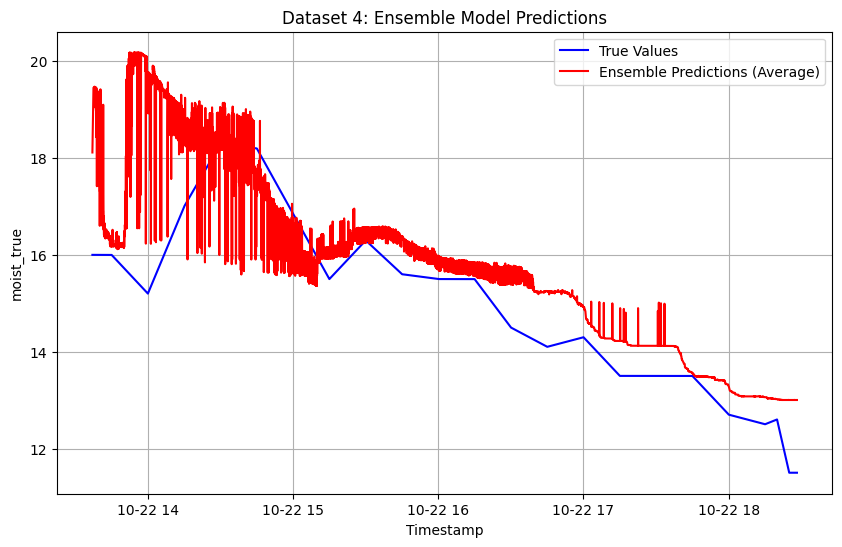

Dataset 4: MSE = 1.6967, MAPE = 5.74%

Final Results:
Dataset 1: MSE = 1.7972, MAPE = 6.32%
Dataset 2: MSE = 1.6533, MAPE = 5.02%
Dataset 4: MSE = 1.6967, MAPE = 5.74%


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

def preprocess_dataset(filepath):
    """Preprocesses a single dataset: interpolates, adds features, and moves 'moist_true' to the last column."""
    data = filepath
    return data

# File paths for datasets
dataset_paths = [
    data1, data2, data3, data4
]

# Features and target
features = ['temp_low', 'temp_high', 'air_temp_lost', 'grain_temp_gained',
            'heat_transfer', 'time_elapsed', 'temp_heated', 'temp_out']
target_col = 'moist_true'

# Function to train and test ensemble model (averaging predictions)
def train_test_ensemble_average_loop(datasets, features, target_col):
    """Train and test ensemble models using 3 datasets for training and 1 for testing, skipping dataset 3."""
    results = []

    for i, test_path in enumerate(datasets):
        print(f"\n--- Iteration {i+1}: Testing on Dataset {i+1} ---")
        if i == 2:  # Skip Dataset 3
            continue

        # Prepare training datasets (all except the test dataset)
        train_paths = [p for j, p in enumerate(datasets) if j != i]
        train_data = pd.concat([preprocess_dataset(p) for p in train_paths], axis=0)
        test_data = preprocess_dataset(test_path)

        # Split features and target
        X_train, y_train = train_data[features], train_data[target_col]
        X_test, y_test = test_data[features], test_data[target_col]

        # Initialize models
        xgb = XGBRegressor(alpha=1, learning_rate=0.008, n_estimators=300, max_depth=6, random_state=42)
        rf = RandomForestRegressor(n_estimators=200, max_depth=6, random_state=42)
        gb = GradientBoostingRegressor(n_estimators=200, learning_rate=0.01, max_depth=5, random_state=42)

        # Train models
        xgb.fit(X_train, y_train)
        rf.fit(X_train, y_train)
        gb.fit(X_train, y_train)

        # Predict
        y_pred_xgb = xgb.predict(X_test)
        y_pred_rf = rf.predict(X_test)
        y_pred_gb = gb.predict(X_test)

        # Ensemble predictions (averaging)
        y_pred_ensemble = (y_pred_xgb + y_pred_rf + y_pred_gb) / 3

        # Evaluate performance
        mse = mean_squared_error(y_test, y_pred_ensemble)
        mape = mean_absolute_percentage_error(y_test, y_pred_ensemble) * 100
        results.append((i + 1, mse, mape))

        # Plot predictions vs true values
        plt.figure(figsize=(10, 6))
        plt.plot(test_data.index, y_test, label="True Values", color='blue')
        plt.plot(test_data.index, y_pred_ensemble, label="Ensemble Predictions (Average)", color='red')
        plt.title(f"Dataset {i + 1}: Ensemble Model Predictions")
        plt.xlabel("Timestamp")
        plt.ylabel(target_col)
        plt.legend()
        plt.grid()
        plt.show()

        print(f"Dataset {i + 1}: MSE = {mse:.4f}, MAPE = {mape:.2f}%")

    return results

# Run the function
results = train_test_ensemble_average_loop(dataset_paths, features, target_col)

# Print the final MSE and MAPE results for all iterations
print("\nFinal Results:")
for dataset_id, mse, mape in results:
    print(f"Dataset {dataset_id}: MSE = {mse:.4f}, MAPE = {mape:.2f}%")
